###Mount Google Drive
Mount Google Drive - where all nuScenes data and resulting run data will be strored

In [ ]:
#Need to mount my Google Drive
from google.colab import drive
drive.mount("/content/gdrive/")

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


Set environment variable for path to nuScenes dataset

In [ ]:
%cd /content/gdrive/MyDrive/MScDissertation
import os
cwd = os.getcwd()
print("cwd:",cwd)
dataroot=os.path.join(cwd,'data/sets/nuscenes') #needed to remove / before data to make it work - now we should be able to access the singapore-onenorth file
print("dataroot (after joining)",dataroot)



# Add a new environment variable for the nuScenes path
os.environ['NUSCENES'] = dataroot

print("NUSCENES:", os.environ['NUSCENES'])

/content/gdrive/MyDrive/MScDissertation
cwd: /content/gdrive/MyDrive/MScDissertation
dataroot (after joining) /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes
NUSCENES: /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes


###Clone and pull code from Github repository

All code for this project is strored at [the following Github link](https://github.com/aokane001/Dissertation-repo). Clone this repository, pull in recent changes and change to the "src" directory which is the main sub-folder for code

In [ ]:
!git clone https://github.com/aokane001/Dissertation-repo

fatal: destination path 'Dissertation-repo' already exists and is not an empty directory.


In [ ]:
#NB Need to actuall change directory forst before pulling
%cd Dissertation-repo/
!git pull
#then switch to src - this is where most of the files we will want to run are
%cd src/

/content/gdrive/MyDrive/MScDissertation/Dissertation-repo
Already up to date.
/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src


###Import necessary packages

Import all python packages needed for this project, in particular nuScenes-devkit and efficientnet. Warnings can be ignored. Some minor errors related to matplotlib versions can be resolved by restarting the runtime and running all cells again.

In [ ]:
#pip installing all the other stuff we will need - that will be called by other files
!python3 -m pip install --upgrade pip
!pip install efficientnet_pytorch==0.7.0
!pip install torchvision torch tensorboardX
!pip install pyquaternion
import functools
!python3 -m pip install --upgrade Pillow
!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.
#NB mpl_toolkits is not on PyPi so not installable by pip
#Since I have matplotlib already installed simply use the following command
import mpl_toolkits
import matplotlib
#NB Was getting several ShapelyDeprecation warnings - this is to help ignore them for now
import shapely
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)

###Set parameters to define LSS model

We need to first define and instantiate the LSS (Lift Splat Shoot) model, then look at its stae_dict. In order to have produced semantic grids, this model will have had its own BevEncode() class i.e. a decoder to create semantic maps. We still want to do this as per our own model's setup (varying configuartions with different values of decoder_mode) so when using pretrained LSS weights we only want to set these for the layers of the network that use the LSS backbone, prior to the point of concatenation - this will require specifying a pretrained_keys_list below for the layers whose pretrained weights we want to use - the BevEncode layers are disregarded so we can use our own BEV Decoder, custom to this work.

In [ ]:
#THIS CELL WILL BE FOR LSS EXPERIMENTATION
from models_LSS import compile_LSS_model
import torch

modelf = "/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src/model525000.pt" #file path for the pretrained LSS model - downloaded from Lift Splat Shoot Github

H=900
W=1600
resize_lim=(0.193, 0.225)
final_dim=(128, 352)
bot_pct_lim=(0.0, 0.22)
rot_lim=(-5.4, 5.4)
rand_flip=True
ncams=5
max_grad_norm=5.0

xbound=[-50.0, 50.0, 0.5] #need to make sure this is the same when we are training out own model below - for grid sizes and hence number of weights to match
ybound=[-50.0, 50.0, 0.5]
zbound=[-10.0, 10.0, 20.0]
dbound=[4.0, 45.0,1.0]

grid_conf = {
  'xbound': xbound,
  'ybound': ybound,
  'zbound': zbound,
  'dbound': dbound,
}
data_aug_conf = {
  'resize_lim': resize_lim,
  'final_dim': final_dim,
  'rot_lim': rot_lim,
  'H': H, 'W': W,
  'rand_flip': rand_flip,
  'bot_pct_lim': bot_pct_lim,
  'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT','CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
  'Ncams': ncams
}


LSS_model = compile_LSS_model(grid_conf, data_aug_conf, outC=1)
state_dict = torch.load(modelf)
LSS_model.load_state_dict(state_dict)
print(LSS_model)




Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:01<00:00, 18.2MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Loaded pretrained weights for efficientnet-b0
LiftSplatShoot(
  (camencode): CamEncode(
    (trunk): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
            (static_padding): ZeroPad2d((1, 1, 1, 1))
          )
          (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
          (_se_reduce): Conv2dStaticSamePadding(
            32, 8, kernel_size=(1, 1), stride=(1, 1)
            (static_padding): Identity()
          )
          (_se_expand): Conv2dStaticSamePadding(
            8, 32, kernel_size=(1, 1), 

In [ ]:
LSS_state_dict = LSS_model.state_dict()
print(LSS_state_dict.keys())

odict_keys(['dx', 'bx', 'nx', 'frustum', 'camencode.trunk._conv_stem.weight', 'camencode.trunk._bn0.weight', 'camencode.trunk._bn0.bias', 'camencode.trunk._bn0.running_mean', 'camencode.trunk._bn0.running_var', 'camencode.trunk._bn0.num_batches_tracked', 'camencode.trunk._blocks.0._depthwise_conv.weight', 'camencode.trunk._blocks.0._bn1.weight', 'camencode.trunk._blocks.0._bn1.bias', 'camencode.trunk._blocks.0._bn1.running_mean', 'camencode.trunk._blocks.0._bn1.running_var', 'camencode.trunk._blocks.0._bn1.num_batches_tracked', 'camencode.trunk._blocks.0._se_reduce.weight', 'camencode.trunk._blocks.0._se_reduce.bias', 'camencode.trunk._blocks.0._se_expand.weight', 'camencode.trunk._blocks.0._se_expand.bias', 'camencode.trunk._blocks.0._project_conv.weight', 'camencode.trunk._blocks.0._bn2.weight', 'camencode.trunk._blocks.0._bn2.bias', 'camencode.trunk._blocks.0._bn2.running_mean', 'camencode.trunk._blocks.0._bn2.running_var', 'camencode.trunk._blocks.0._bn2.num_batches_tracked', 'came

In [ ]:
#Pretrained keys - because LSS model does have bevencode layers also
#that we don't want to be pretrained (as this is where our model will differ)
#we need to single out the layers for which we do want to try load pretrained LSS weights for i.e. keys in the model state dict
#that match between LSS model's model dict and what I need in mine

pretrained_keys_list = [
 'dx',
 'bx',
 'nx',
 'frustum',
 'camencode.trunk._conv_stem.weight',
 'camencode.trunk._bn0.weight',
 'camencode.trunk._bn0.bias',
 'camencode.trunk._bn0.running_mean',
 'camencode.trunk._bn0.running_var',
 'camencode.trunk._bn0.num_batches_tracked',
 'camencode.trunk._blocks.0._depthwise_conv.weight',
 'camencode.trunk._blocks.0._bn1.weight',
 'camencode.trunk._blocks.0._bn1.bias',
 'camencode.trunk._blocks.0._bn1.running_mean',
 'camencode.trunk._blocks.0._bn1.running_var',
 'camencode.trunk._blocks.0._bn1.num_batches_tracked',
 'camencode.trunk._blocks.0._se_reduce.weight',
 'camencode.trunk._blocks.0._se_reduce.bias',
 'camencode.trunk._blocks.0._se_expand.weight',
 'camencode.trunk._blocks.0._se_expand.bias',
 'camencode.trunk._blocks.0._project_conv.weight',
 'camencode.trunk._blocks.0._bn2.weight',
 'camencode.trunk._blocks.0._bn2.bias',
 'camencode.trunk._blocks.0._bn2.running_mean',
 'camencode.trunk._blocks.0._bn2.running_var',
 'camencode.trunk._blocks.0._bn2.num_batches_tracked',
 'camencode.trunk._blocks.1._expand_conv.weight',
 'camencode.trunk._blocks.1._bn0.weight',
 'camencode.trunk._blocks.1._bn0.bias',
 'camencode.trunk._blocks.1._bn0.running_mean',
 'camencode.trunk._blocks.1._bn0.running_var',
 'camencode.trunk._blocks.1._bn0.num_batches_tracked',
 'camencode.trunk._blocks.1._depthwise_conv.weight',
 'camencode.trunk._blocks.1._bn1.weight',
 'camencode.trunk._blocks.1._bn1.bias',
 'camencode.trunk._blocks.1._bn1.running_mean',
 'camencode.trunk._blocks.1._bn1.running_var',
 'camencode.trunk._blocks.1._bn1.num_batches_tracked',
 'camencode.trunk._blocks.1._se_reduce.weight',
 'camencode.trunk._blocks.1._se_reduce.bias',
 'camencode.trunk._blocks.1._se_expand.weight',
 'camencode.trunk._blocks.1._se_expand.bias',
 'camencode.trunk._blocks.1._project_conv.weight',
 'camencode.trunk._blocks.1._bn2.weight',
 'camencode.trunk._blocks.1._bn2.bias',
 'camencode.trunk._blocks.1._bn2.running_mean',
 'camencode.trunk._blocks.1._bn2.running_var',
 'camencode.trunk._blocks.1._bn2.num_batches_tracked',
 'camencode.trunk._blocks.2._expand_conv.weight',
 'camencode.trunk._blocks.2._bn0.weight',
 'camencode.trunk._blocks.2._bn0.bias',
 'camencode.trunk._blocks.2._bn0.running_mean',
 'camencode.trunk._blocks.2._bn0.running_var',
 'camencode.trunk._blocks.2._bn0.num_batches_tracked',
 'camencode.trunk._blocks.2._depthwise_conv.weight',
 'camencode.trunk._blocks.2._bn1.weight',
 'camencode.trunk._blocks.2._bn1.bias',
 'camencode.trunk._blocks.2._bn1.running_mean',
 'camencode.trunk._blocks.2._bn1.running_var',
 'camencode.trunk._blocks.2._bn1.num_batches_tracked',
 'camencode.trunk._blocks.2._se_reduce.weight',
 'camencode.trunk._blocks.2._se_reduce.bias',
 'camencode.trunk._blocks.2._se_expand.weight',
 'camencode.trunk._blocks.2._se_expand.bias',
 'camencode.trunk._blocks.2._project_conv.weight',
 'camencode.trunk._blocks.2._bn2.weight',
 'camencode.trunk._blocks.2._bn2.bias',
 'camencode.trunk._blocks.2._bn2.running_mean',
 'camencode.trunk._blocks.2._bn2.running_var',
 'camencode.trunk._blocks.2._bn2.num_batches_tracked',
 'camencode.trunk._blocks.3._expand_conv.weight',
 'camencode.trunk._blocks.3._bn0.weight',
 'camencode.trunk._blocks.3._bn0.bias',
 'camencode.trunk._blocks.3._bn0.running_mean',
 'camencode.trunk._blocks.3._bn0.running_var',
 'camencode.trunk._blocks.3._bn0.num_batches_tracked',
 'camencode.trunk._blocks.3._depthwise_conv.weight',
 'camencode.trunk._blocks.3._bn1.weight',
 'camencode.trunk._blocks.3._bn1.bias',
 'camencode.trunk._blocks.3._bn1.running_mean',
 'camencode.trunk._blocks.3._bn1.running_var',
 'camencode.trunk._blocks.3._bn1.num_batches_tracked',
 'camencode.trunk._blocks.3._se_reduce.weight',
 'camencode.trunk._blocks.3._se_reduce.bias',
 'camencode.trunk._blocks.3._se_expand.weight',
 'camencode.trunk._blocks.3._se_expand.bias',
 'camencode.trunk._blocks.3._project_conv.weight',
 'camencode.trunk._blocks.3._bn2.weight',
 'camencode.trunk._blocks.3._bn2.bias',
 'camencode.trunk._blocks.3._bn2.running_mean',
 'camencode.trunk._blocks.3._bn2.running_var',
 'camencode.trunk._blocks.3._bn2.num_batches_tracked',
 'camencode.trunk._blocks.4._expand_conv.weight',
 'camencode.trunk._blocks.4._bn0.weight',
 'camencode.trunk._blocks.4._bn0.bias',
 'camencode.trunk._blocks.4._bn0.running_mean',
 'camencode.trunk._blocks.4._bn0.running_var',
 'camencode.trunk._blocks.4._bn0.num_batches_tracked',
 'camencode.trunk._blocks.4._depthwise_conv.weight',
 'camencode.trunk._blocks.4._bn1.weight',
 'camencode.trunk._blocks.4._bn1.bias',
 'camencode.trunk._blocks.4._bn1.running_mean',
 'camencode.trunk._blocks.4._bn1.running_var',
 'camencode.trunk._blocks.4._bn1.num_batches_tracked',
 'camencode.trunk._blocks.4._se_reduce.weight',
 'camencode.trunk._blocks.4._se_reduce.bias',
 'camencode.trunk._blocks.4._se_expand.weight',
 'camencode.trunk._blocks.4._se_expand.bias',
 'camencode.trunk._blocks.4._project_conv.weight',
 'camencode.trunk._blocks.4._bn2.weight',
 'camencode.trunk._blocks.4._bn2.bias',
 'camencode.trunk._blocks.4._bn2.running_mean',
 'camencode.trunk._blocks.4._bn2.running_var',
 'camencode.trunk._blocks.4._bn2.num_batches_tracked',
 'camencode.trunk._blocks.5._expand_conv.weight',
 'camencode.trunk._blocks.5._bn0.weight',
 'camencode.trunk._blocks.5._bn0.bias',
 'camencode.trunk._blocks.5._bn0.running_mean',
 'camencode.trunk._blocks.5._bn0.running_var',
 'camencode.trunk._blocks.5._bn0.num_batches_tracked',
 'camencode.trunk._blocks.5._depthwise_conv.weight',
 'camencode.trunk._blocks.5._bn1.weight',
 'camencode.trunk._blocks.5._bn1.bias',
 'camencode.trunk._blocks.5._bn1.running_mean',
 'camencode.trunk._blocks.5._bn1.running_var',
 'camencode.trunk._blocks.5._bn1.num_batches_tracked',
 'camencode.trunk._blocks.5._se_reduce.weight',
 'camencode.trunk._blocks.5._se_reduce.bias',
 'camencode.trunk._blocks.5._se_expand.weight',
 'camencode.trunk._blocks.5._se_expand.bias',
 'camencode.trunk._blocks.5._project_conv.weight',
 'camencode.trunk._blocks.5._bn2.weight',
 'camencode.trunk._blocks.5._bn2.bias',
 'camencode.trunk._blocks.5._bn2.running_mean',
 'camencode.trunk._blocks.5._bn2.running_var',
 'camencode.trunk._blocks.5._bn2.num_batches_tracked',
 'camencode.trunk._blocks.6._expand_conv.weight',
 'camencode.trunk._blocks.6._bn0.weight',
 'camencode.trunk._blocks.6._bn0.bias',
 'camencode.trunk._blocks.6._bn0.running_mean',
 'camencode.trunk._blocks.6._bn0.running_var',
 'camencode.trunk._blocks.6._bn0.num_batches_tracked',
 'camencode.trunk._blocks.6._depthwise_conv.weight',
 'camencode.trunk._blocks.6._bn1.weight',
 'camencode.trunk._blocks.6._bn1.bias',
 'camencode.trunk._blocks.6._bn1.running_mean',
 'camencode.trunk._blocks.6._bn1.running_var',
 'camencode.trunk._blocks.6._bn1.num_batches_tracked',
 'camencode.trunk._blocks.6._se_reduce.weight',
 'camencode.trunk._blocks.6._se_reduce.bias',
 'camencode.trunk._blocks.6._se_expand.weight',
 'camencode.trunk._blocks.6._se_expand.bias',
 'camencode.trunk._blocks.6._project_conv.weight',
 'camencode.trunk._blocks.6._bn2.weight',
 'camencode.trunk._blocks.6._bn2.bias',
 'camencode.trunk._blocks.6._bn2.running_mean',
 'camencode.trunk._blocks.6._bn2.running_var',
 'camencode.trunk._blocks.6._bn2.num_batches_tracked',
 'camencode.trunk._blocks.7._expand_conv.weight',
 'camencode.trunk._blocks.7._bn0.weight',
 'camencode.trunk._blocks.7._bn0.bias',
 'camencode.trunk._blocks.7._bn0.running_mean',
 'camencode.trunk._blocks.7._bn0.running_var',
 'camencode.trunk._blocks.7._bn0.num_batches_tracked',
 'camencode.trunk._blocks.7._depthwise_conv.weight',
 'camencode.trunk._blocks.7._bn1.weight',
 'camencode.trunk._blocks.7._bn1.bias',
 'camencode.trunk._blocks.7._bn1.running_mean',
 'camencode.trunk._blocks.7._bn1.running_var',
 'camencode.trunk._blocks.7._bn1.num_batches_tracked',
 'camencode.trunk._blocks.7._se_reduce.weight',
 'camencode.trunk._blocks.7._se_reduce.bias',
 'camencode.trunk._blocks.7._se_expand.weight',
 'camencode.trunk._blocks.7._se_expand.bias',
 'camencode.trunk._blocks.7._project_conv.weight',
 'camencode.trunk._blocks.7._bn2.weight',
 'camencode.trunk._blocks.7._bn2.bias',
 'camencode.trunk._blocks.7._bn2.running_mean',
 'camencode.trunk._blocks.7._bn2.running_var',
 'camencode.trunk._blocks.7._bn2.num_batches_tracked',
 'camencode.trunk._blocks.8._expand_conv.weight',
 'camencode.trunk._blocks.8._bn0.weight',
 'camencode.trunk._blocks.8._bn0.bias',
 'camencode.trunk._blocks.8._bn0.running_mean',
 'camencode.trunk._blocks.8._bn0.running_var',
 'camencode.trunk._blocks.8._bn0.num_batches_tracked',
 'camencode.trunk._blocks.8._depthwise_conv.weight',
 'camencode.trunk._blocks.8._bn1.weight',
 'camencode.trunk._blocks.8._bn1.bias',
 'camencode.trunk._blocks.8._bn1.running_mean',
 'camencode.trunk._blocks.8._bn1.running_var',
 'camencode.trunk._blocks.8._bn1.num_batches_tracked',
 'camencode.trunk._blocks.8._se_reduce.weight',
 'camencode.trunk._blocks.8._se_reduce.bias',
 'camencode.trunk._blocks.8._se_expand.weight',
 'camencode.trunk._blocks.8._se_expand.bias',
 'camencode.trunk._blocks.8._project_conv.weight',
 'camencode.trunk._blocks.8._bn2.weight',
 'camencode.trunk._blocks.8._bn2.bias',
 'camencode.trunk._blocks.8._bn2.running_mean',
 'camencode.trunk._blocks.8._bn2.running_var',
 'camencode.trunk._blocks.8._bn2.num_batches_tracked',
 'camencode.trunk._blocks.9._expand_conv.weight',
 'camencode.trunk._blocks.9._bn0.weight',
 'camencode.trunk._blocks.9._bn0.bias',
 'camencode.trunk._blocks.9._bn0.running_mean',
 'camencode.trunk._blocks.9._bn0.running_var',
 'camencode.trunk._blocks.9._bn0.num_batches_tracked',
 'camencode.trunk._blocks.9._depthwise_conv.weight',
 'camencode.trunk._blocks.9._bn1.weight',
 'camencode.trunk._blocks.9._bn1.bias',
 'camencode.trunk._blocks.9._bn1.running_mean',
 'camencode.trunk._blocks.9._bn1.running_var',
 'camencode.trunk._blocks.9._bn1.num_batches_tracked',
 'camencode.trunk._blocks.9._se_reduce.weight',
 'camencode.trunk._blocks.9._se_reduce.bias',
 'camencode.trunk._blocks.9._se_expand.weight',
 'camencode.trunk._blocks.9._se_expand.bias',
 'camencode.trunk._blocks.9._project_conv.weight',
 'camencode.trunk._blocks.9._bn2.weight',
 'camencode.trunk._blocks.9._bn2.bias',
 'camencode.trunk._blocks.9._bn2.running_mean',
 'camencode.trunk._blocks.9._bn2.running_var',
 'camencode.trunk._blocks.9._bn2.num_batches_tracked',
 'camencode.trunk._blocks.10._expand_conv.weight',
 'camencode.trunk._blocks.10._bn0.weight',
 'camencode.trunk._blocks.10._bn0.bias',
 'camencode.trunk._blocks.10._bn0.running_mean',
 'camencode.trunk._blocks.10._bn0.running_var',
 'camencode.trunk._blocks.10._bn0.num_batches_tracked',
 'camencode.trunk._blocks.10._depthwise_conv.weight',
 'camencode.trunk._blocks.10._bn1.weight',
 'camencode.trunk._blocks.10._bn1.bias',
 'camencode.trunk._blocks.10._bn1.running_mean',
 'camencode.trunk._blocks.10._bn1.running_var',
 'camencode.trunk._blocks.10._bn1.num_batches_tracked',
 'camencode.trunk._blocks.10._se_reduce.weight',
 'camencode.trunk._blocks.10._se_reduce.bias',
 'camencode.trunk._blocks.10._se_expand.weight',
 'camencode.trunk._blocks.10._se_expand.bias',
 'camencode.trunk._blocks.10._project_conv.weight',
 'camencode.trunk._blocks.10._bn2.weight',
 'camencode.trunk._blocks.10._bn2.bias',
 'camencode.trunk._blocks.10._bn2.running_mean',
 'camencode.trunk._blocks.10._bn2.running_var',
 'camencode.trunk._blocks.10._bn2.num_batches_tracked',
 'camencode.trunk._blocks.11._expand_conv.weight',
 'camencode.trunk._blocks.11._bn0.weight',
 'camencode.trunk._blocks.11._bn0.bias',
 'camencode.trunk._blocks.11._bn0.running_mean',
 'camencode.trunk._blocks.11._bn0.running_var',
 'camencode.trunk._blocks.11._bn0.num_batches_tracked',
 'camencode.trunk._blocks.11._depthwise_conv.weight',
 'camencode.trunk._blocks.11._bn1.weight',
 'camencode.trunk._blocks.11._bn1.bias',
 'camencode.trunk._blocks.11._bn1.running_mean',
 'camencode.trunk._blocks.11._bn1.running_var',
 'camencode.trunk._blocks.11._bn1.num_batches_tracked',
 'camencode.trunk._blocks.11._se_reduce.weight',
 'camencode.trunk._blocks.11._se_reduce.bias',
 'camencode.trunk._blocks.11._se_expand.weight',
 'camencode.trunk._blocks.11._se_expand.bias',
 'camencode.trunk._blocks.11._project_conv.weight',
 'camencode.trunk._blocks.11._bn2.weight',
 'camencode.trunk._blocks.11._bn2.bias',
 'camencode.trunk._blocks.11._bn2.running_mean',
 'camencode.trunk._blocks.11._bn2.running_var',
 'camencode.trunk._blocks.11._bn2.num_batches_tracked',
 'camencode.trunk._blocks.12._expand_conv.weight',
 'camencode.trunk._blocks.12._bn0.weight',
 'camencode.trunk._blocks.12._bn0.bias',
 'camencode.trunk._blocks.12._bn0.running_mean',
 'camencode.trunk._blocks.12._bn0.running_var',
 'camencode.trunk._blocks.12._bn0.num_batches_tracked',
 'camencode.trunk._blocks.12._depthwise_conv.weight',
 'camencode.trunk._blocks.12._bn1.weight',
 'camencode.trunk._blocks.12._bn1.bias',
 'camencode.trunk._blocks.12._bn1.running_mean',
 'camencode.trunk._blocks.12._bn1.running_var',
 'camencode.trunk._blocks.12._bn1.num_batches_tracked',
 'camencode.trunk._blocks.12._se_reduce.weight',
 'camencode.trunk._blocks.12._se_reduce.bias',
 'camencode.trunk._blocks.12._se_expand.weight',
 'camencode.trunk._blocks.12._se_expand.bias',
 'camencode.trunk._blocks.12._project_conv.weight',
 'camencode.trunk._blocks.12._bn2.weight',
 'camencode.trunk._blocks.12._bn2.bias',
 'camencode.trunk._blocks.12._bn2.running_mean',
 'camencode.trunk._blocks.12._bn2.running_var',
 'camencode.trunk._blocks.12._bn2.num_batches_tracked',
 'camencode.trunk._blocks.13._expand_conv.weight',
 'camencode.trunk._blocks.13._bn0.weight',
 'camencode.trunk._blocks.13._bn0.bias',
 'camencode.trunk._blocks.13._bn0.running_mean',
 'camencode.trunk._blocks.13._bn0.running_var',
 'camencode.trunk._blocks.13._bn0.num_batches_tracked',
 'camencode.trunk._blocks.13._depthwise_conv.weight',
 'camencode.trunk._blocks.13._bn1.weight',
 'camencode.trunk._blocks.13._bn1.bias',
 'camencode.trunk._blocks.13._bn1.running_mean',
 'camencode.trunk._blocks.13._bn1.running_var',
 'camencode.trunk._blocks.13._bn1.num_batches_tracked',
 'camencode.trunk._blocks.13._se_reduce.weight',
 'camencode.trunk._blocks.13._se_reduce.bias',
 'camencode.trunk._blocks.13._se_expand.weight',
 'camencode.trunk._blocks.13._se_expand.bias',
 'camencode.trunk._blocks.13._project_conv.weight',
 'camencode.trunk._blocks.13._bn2.weight',
 'camencode.trunk._blocks.13._bn2.bias',
 'camencode.trunk._blocks.13._bn2.running_mean',
 'camencode.trunk._blocks.13._bn2.running_var',
 'camencode.trunk._blocks.13._bn2.num_batches_tracked',
 'camencode.trunk._blocks.14._expand_conv.weight',
 'camencode.trunk._blocks.14._bn0.weight',
 'camencode.trunk._blocks.14._bn0.bias',
 'camencode.trunk._blocks.14._bn0.running_mean',
 'camencode.trunk._blocks.14._bn0.running_var',
 'camencode.trunk._blocks.14._bn0.num_batches_tracked',
 'camencode.trunk._blocks.14._depthwise_conv.weight',
 'camencode.trunk._blocks.14._bn1.weight',
 'camencode.trunk._blocks.14._bn1.bias',
 'camencode.trunk._blocks.14._bn1.running_mean',
 'camencode.trunk._blocks.14._bn1.running_var',
 'camencode.trunk._blocks.14._bn1.num_batches_tracked',
 'camencode.trunk._blocks.14._se_reduce.weight',
 'camencode.trunk._blocks.14._se_reduce.bias',
 'camencode.trunk._blocks.14._se_expand.weight',
 'camencode.trunk._blocks.14._se_expand.bias',
 'camencode.trunk._blocks.14._project_conv.weight',
 'camencode.trunk._blocks.14._bn2.weight',
 'camencode.trunk._blocks.14._bn2.bias',
 'camencode.trunk._blocks.14._bn2.running_mean',
 'camencode.trunk._blocks.14._bn2.running_var',
 'camencode.trunk._blocks.14._bn2.num_batches_tracked',
 'camencode.trunk._blocks.15._expand_conv.weight',
 'camencode.trunk._blocks.15._bn0.weight',
 'camencode.trunk._blocks.15._bn0.bias',
 'camencode.trunk._blocks.15._bn0.running_mean',
 'camencode.trunk._blocks.15._bn0.running_var',
 'camencode.trunk._blocks.15._bn0.num_batches_tracked',
 'camencode.trunk._blocks.15._depthwise_conv.weight',
 'camencode.trunk._blocks.15._bn1.weight',
 'camencode.trunk._blocks.15._bn1.bias',
 'camencode.trunk._blocks.15._bn1.running_mean',
 'camencode.trunk._blocks.15._bn1.running_var',
 'camencode.trunk._blocks.15._bn1.num_batches_tracked',
 'camencode.trunk._blocks.15._se_reduce.weight',
 'camencode.trunk._blocks.15._se_reduce.bias',
 'camencode.trunk._blocks.15._se_expand.weight',
 'camencode.trunk._blocks.15._se_expand.bias',
 'camencode.trunk._blocks.15._project_conv.weight',
 'camencode.trunk._blocks.15._bn2.weight',
 'camencode.trunk._blocks.15._bn2.bias',
 'camencode.trunk._blocks.15._bn2.running_mean',
 'camencode.trunk._blocks.15._bn2.running_var',
 'camencode.trunk._blocks.15._bn2.num_batches_tracked',
 'camencode.trunk._conv_head.weight',
 'camencode.trunk._bn1.weight',
 'camencode.trunk._bn1.bias',
 'camencode.trunk._bn1.running_mean',
 'camencode.trunk._bn1.running_var',
 'camencode.trunk._bn1.num_batches_tracked',
 'camencode.trunk._fc.weight',
 'camencode.trunk._fc.bias',
 'camencode.up1.conv.0.weight',
 'camencode.up1.conv.1.weight',
 'camencode.up1.conv.1.bias',
 'camencode.up1.conv.1.running_mean',
 'camencode.up1.conv.1.running_var',
 'camencode.up1.conv.1.num_batches_tracked',
 'camencode.up1.conv.3.weight',
 'camencode.up1.conv.4.weight',
 'camencode.up1.conv.4.bias',
 'camencode.up1.conv.4.running_mean',
 'camencode.up1.conv.4.running_var',
 'camencode.up1.conv.4.num_batches_tracked',
 'camencode.depthnet.weight',
 'camencode.depthnet.bias'
]


In [ ]:
#filter out unnecessary keys
LSS_state_dict = {k: v for k, v in LSS_state_dict.items() if k in pretrained_keys_list}

###Set parameters that will be common accross several function calls

Rather than having to pass the same parameter values to several function calls, set them once here, then pass them to function calls below e.g. as decoder_mode = decoder_mode, once it is set here once (as it is a parameter that will change frequently between run setups).

In [ ]:
#NB - Seen as this is a parameter that will be changing frequently - better to set this here then pass it into function definitions and calls
decoder_mode = 5

#With TF Grid this is set as part of the config file - then when running the actual train file it is
#run by firing the main.py file which runs the train.py file and we specify the arguments to pass and point to the config file where the train label is set
#so it never actually gets explicitly passed in the train.py (on which we based train() below) - so I think that's why we need to set it explicitly here
train_label = 'lane_divider' #'walkway' #'vehicle' #'drivable_area'

#Want to set the logdir here - this is what will actually be passed when we call the function below and pass logdir-logdir
#but in the function definition set the default to just be "./runs"
logdir='./runs'

version = "mini"
dataroot = os.environ["NUSCENES"]
#Use 60 epochs for full runs - as per TF Grid
nepochs = 60
#since only one GPU is available in Colab and we start counting from 0
gpuid = 0

#params related to data_aug_conf - i.e. related to data augmentation of camera images
H=900
W=1600
resize_lim=(0.193, 0.225)
final_dim=(128, 352)
bot_pct_lim=(0.0, 0.22)
rot_lim=(-5.4, 5.4)
rand_flip=True
ncams=5
max_grad_norm=5.0
pos_weight=2.13

#params related to grid_conf - i.e. grid configuration of final semantic grid - want this to be 200 x 200 cells i.e. -50m to 50m range in 0.5m intervals
xbound=[-50.0, 50.0, 0.5]
ybound=[-50.0, 50.0, 0.5]
zbound=[-10.0, 10.0, 20.0]
dbound=[4.0, 45.0,1.0] #this is D in literature of Lift Splat Shoot - range of distances

#params related to training function
bsz=2 #batch size
nworkers=2

lr = 1e-5 #learning rate
weight_decay = 1e-5 #weight_decay for L2 regularisation
num_classes = 1 #ultimately only training for 1 class at a time

#params related to PointPillars backbone
num_points = 100000
#NB - AS WE ARE training BASED ON MINI - PASS 34718 WHEN CALLING TRAIN
# trainval avg 34720  , mini avg 34718
n_points=34718

#As per TFGrid config files this was left as is - defined based on xbound, ybound so that grid sizes match up and allow for concatenation
#Comment and let this be passed wheb defining grid_conf
#pc_range= [xbound[0],ybound[0],-4,xbound[1],ybound[1],4]
#voxel_size = [xbound[2],ybound[2],8]

max_points_voxel = 100 #this is N in TF Grid literature
max_voxels = 10000 #this is P in TF Grid literature
input_features= 4 #four initial inputs - supplemented to get up to 9-dimensional within PointPillars block
use_norm = True #we do want to use BatchNorm
vfe_filters = [64] #this is effectively C=64 for PointPillars - controls number of channels
with_distance = False

#Will need to pass this as the place to store data for visualisations
img_save_dir = './runs/viz_model_preds/' #need '/' here so that file path is saved correctly when passing to savefig in viz_model_preds() below

#for lidar_check() below
show_lidar=True #want to see lidar scans
viz_train=False #set this to True to see data augmentation and visualise train data rather than val data

#for viz_model_preds below - or visualisation
map_folder = os.environ["NUSCENES"]

#need to pass this to preload LSS weights
pretrained_dict = LSS_state_dict

###Define train() function

This is a slightly altered version of the train function as compared to previous training scripts as we need to alter our model to use pretrained Lift Splat Shoot weights - and therefore we pass an additional parameter pretrained_dict that loads the weights from LSS_state_dict

In [ ]:
#import necessary packages and code from other scripts in Github repo
#the following command effectively mirrors the train.py script from TF Grid repo
import torch
import torch.nn.functional as F
from time import time
from tensorboardX import SummaryWriter
import numpy as np
import os

from models_Dropout_resnet_pretrained import compile_model #this will be model runs where Dropout and pretrained resnet blocks were added to combat overfitting
#from models_2T import compile_model #swapping out to see the model with 2 transformers - just to try understand how sizes work - how many channels I will need when concatenating
from data import compile_data
from tools import SimpleLoss, get_batch_iou, get_val_info,points_to_voxel_loop

#Define train() function
def train(
  train_label = train_label, #In TFGrid this isn't in the definition of train but really it is needed for compile_data that is called as part of it
                             #so it should be passed - in reality it seems the Fire part of main.py that calls the config file gets it from there - but it should be here
  version = version,
  dataroot = dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid,

  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,
  #also need a new parameter to pass the pretrained LSS state_dict
  pretrained_dict = pretrained_dict,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_classes = num_classes,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features= input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
  ):

  #The following dicts are then defined based on passed params
  grid_conf = {
    'xbound': xbound,
    'ybound': ybound,
    'zbound': zbound,
    'dbound': dbound,
    'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
  }

  data_aug_conf = {
    'resize_lim': resize_lim,
    'final_dim': final_dim,
    'rot_lim': rot_lim,
    'H': H, 'W': W,
    'rand_flip': rand_flip,
    'bot_pct_lim': bot_pct_lim,
    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT','CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
    'Ncams': ncams,
  }

  cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4], #NB-define this based on xbound, ybound so grid sizes will match
    'voxel_size' : [xbound[2],ybound[2],8], #NB-define this based on xbound, ybound so grid sizes will match
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

  print('Loading data ...')
  #Had to change the way this is called slightly - it is strange, in train.py in TFGrid - it passes n_points and pc_range explicitly but this isn't how it is defined in models.py
  trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata',cfg_pp=cfg_pp, train_label=train_label) #other paraemeter - cond, dist, rank, sw can be left as default

  device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
  print('Compiling model ...')
  model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) ### outC number of output channels
  model.to(device)
  #want to print the model to visualise layers - see what is similar with LSS and my model
  print(model)
  model_dict = model.state_dict()
  #overwrite entries in the existing state dict
  model_dict.update(pretrained_dict)
  #load the new state dict
  model.load_state_dict(model_dict)

  opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
  loss_fn = SimpleLoss(pos_weight).cuda(gpuid)
  writer = SummaryWriter(logdir=logdir)
  val_step = 500 if version == 'mini' else 5000
  model.train()
  counter = 0
  print('Starting training ...')
  for epoch in range(nepochs):
      print(f"Epoch: {epoch+1}/{nepochs}") #NOTE - ACTUAL VALUE OF epoch WILL START COUNTING FROM 0 - THIS IS JUST FOR CONVENIENCE OF READING OUTPUT TO START FROM 1
      np.random.seed()
      for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(trainloader):
          t0 = time()
          opt.zero_grad()
          voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)
          preds = model(imgs.to(device),
                  rots.to(device),
                  trans.to(device),
                  intrins.to(device),
                  post_rots.to(device),
                  post_trans.to(device),
                  voxels.to(device),
                  coors.to(device),
                  num_points.to(device),
                  )

          binimgs = binimgs.to(device)
          loss = loss_fn(preds, binimgs)
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
          opt.step()
          counter += 1
          t1 = time()
          if counter % 10 == 0:
              print(counter, loss.item())
              writer.add_scalar('train/loss', loss, counter)
          if counter % 50 == 0:
              intersection, union, iou = get_batch_iou(preds, binimgs)
              writer.add_scalar('train/iou', iou, counter)
              writer.add_scalar('train/epoch', epoch, counter)
              writer.add_scalar('train/step_time', t1 - t0, counter)
          if counter % val_step == 0:
              val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp=cfg_pp,grid_conf=grid_conf, use_tqdm= True)
              print('VAL', val_info)
              writer.add_scalar('val/loss', val_info['loss'], counter)
              writer.add_scalar('val/iou', val_info['iou'], counter)
          if counter % val_step == 0:
              model.eval()
              mname = os.path.join(logdir, "model{}.pt".format(counter)) #NB This is the location-same runs/ directory where summary will be saved
                                                                         #where the model will also be saved every val_step=500 number of training steps
              print('saving ... ', mname)
              torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': opt.state_dict(),
              'loss': loss,
              'counter':counter
              }, mname)
              model.train()

###Now we want to actually call train() to commence training

Loading data ...
Getting all samples
Getting all samples
Compiling model ...
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 218MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloadi

LPT(
  (camencode): CamEncode(
    (trunk): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
            (static_padding): ZeroPad2d((1, 1, 1, 1))
          )
          (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
          (_se_reduce): Conv2dStaticSamePadding(
            32, 8, kernel_size=(1, 1), stride=(1, 1)
            (static_padding): Identity()
          )
          (_se_expand): Conv2dStaticSamePadding(
            8, 32, kernel_size=(1, 1), stride=(1, 1)
            (static_padding): Identity()
  

  0%|          | 0/40 [00:00<?, ?it/s]/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src/tools.py:113: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3571.)
  ax2.imshow(ndimage.rotate(cv2.flip(np.array(binimgs[j].T),0), -90, reshape=False), vmin=0, vmax=1, cmap='Blues')


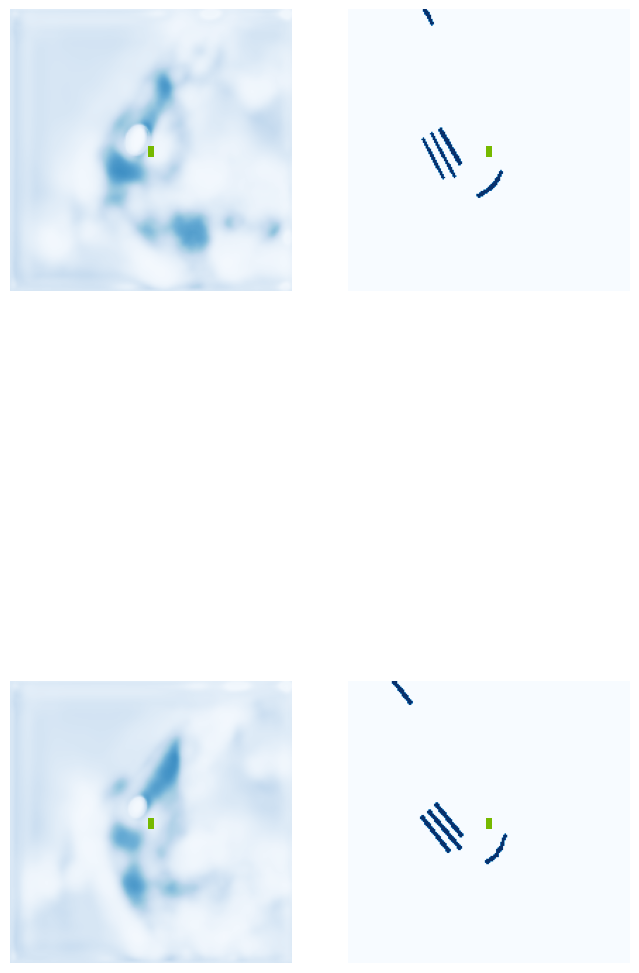

  5%|▌         | 2/40 [00:13<03:32,  5.59s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.03.jpg


 12%|█▎        | 5/40 [00:36<04:15,  7.30s/it]

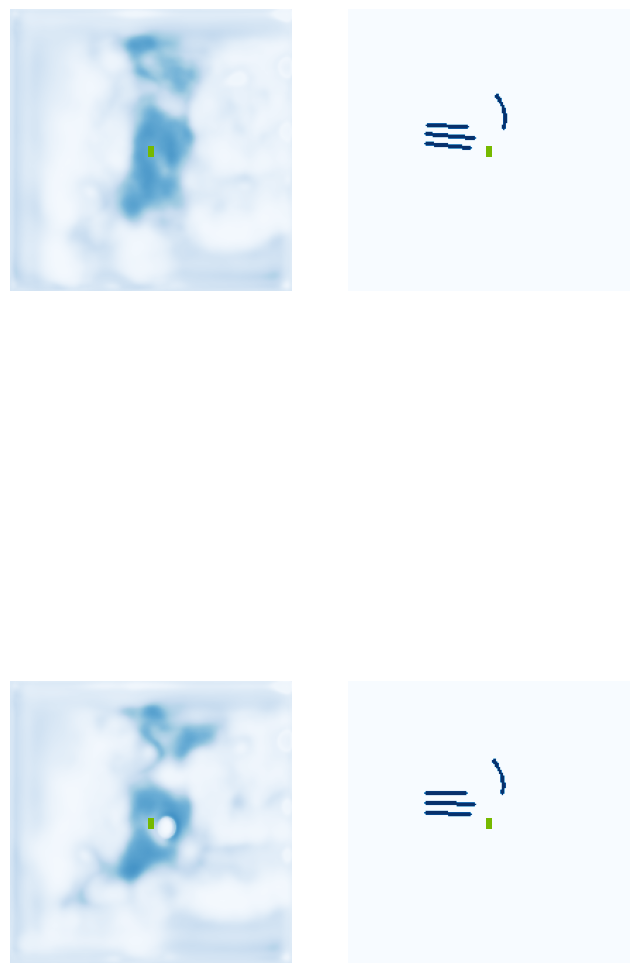

 15%|█▌        | 6/40 [00:36<02:52,  5.08s/it]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [01:00<02:27,  4.93s/it]

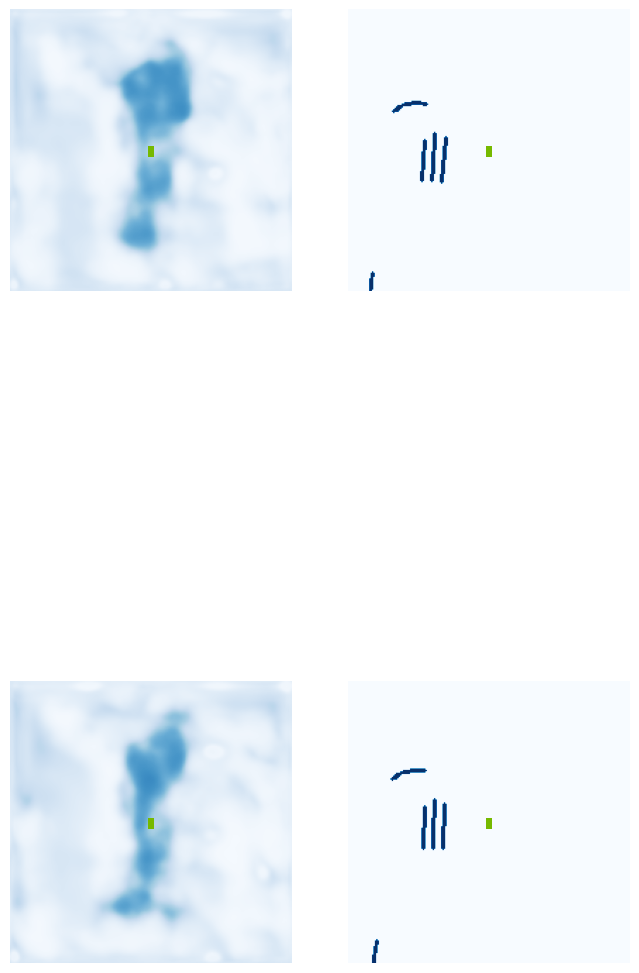

 30%|███       | 12/40 [01:12<02:19,  4.97s/it]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [01:35<02:49,  6.79s/it]

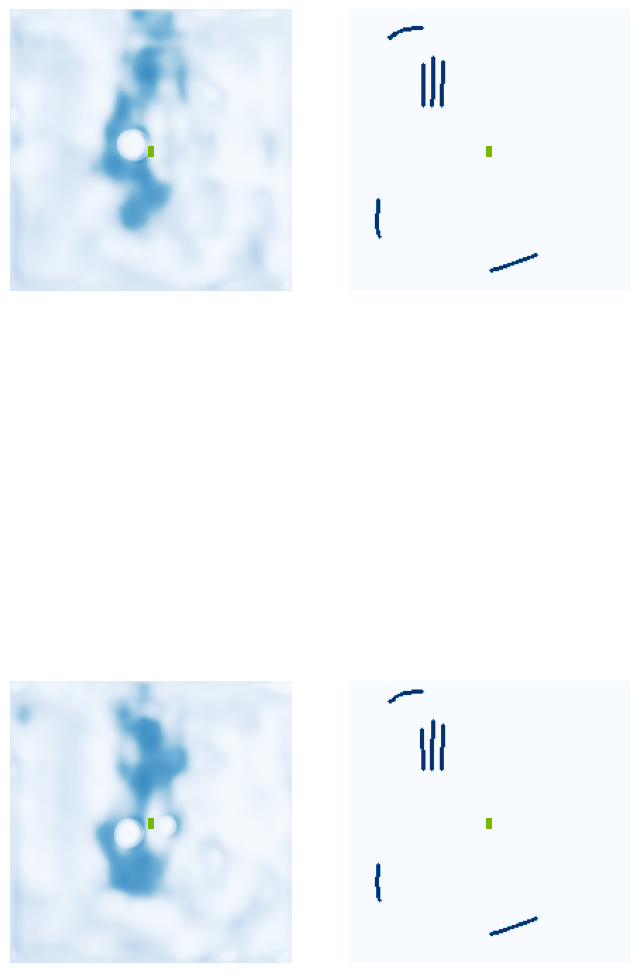

 40%|████      | 16/40 [01:35<01:56,  4.87s/it]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [01:59<01:40,  5.03s/it]

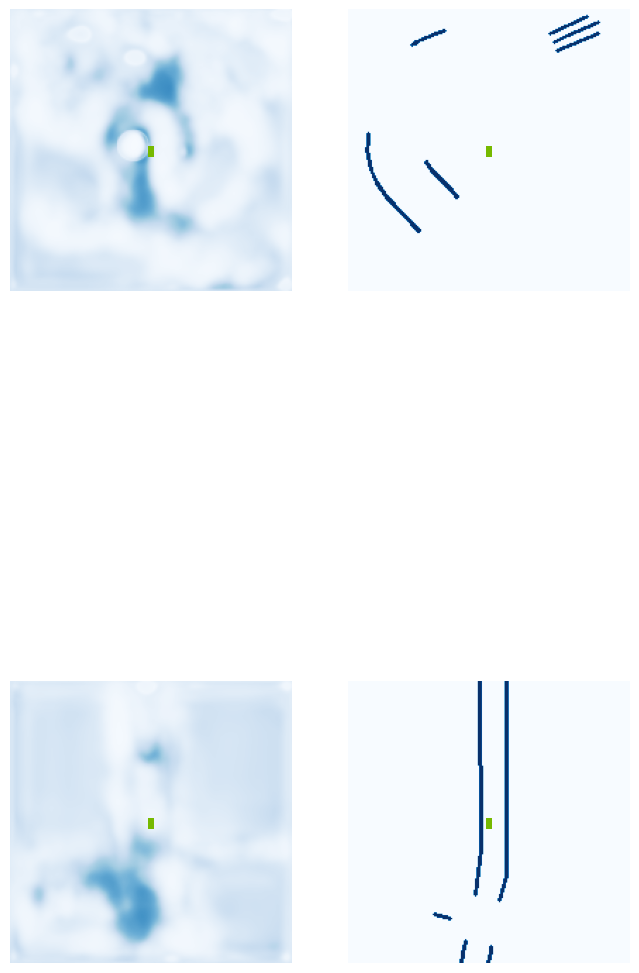

 52%|█████▎    | 21/40 [02:11<02:15,  7.16s/it]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [02:36<01:47,  7.18s/it]

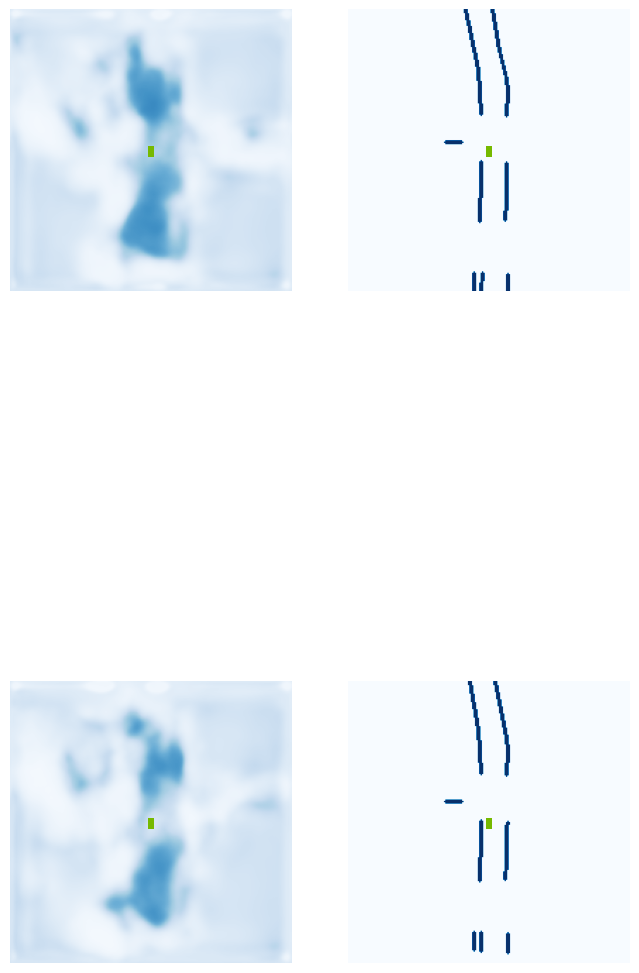

 65%|██████▌   | 26/40 [02:37<01:12,  5.19s/it]

Image saved! ... ./runs/get_val_info/25-iou-0.08.jpg


 75%|███████▌  | 30/40 [03:01<00:51,  5.14s/it]

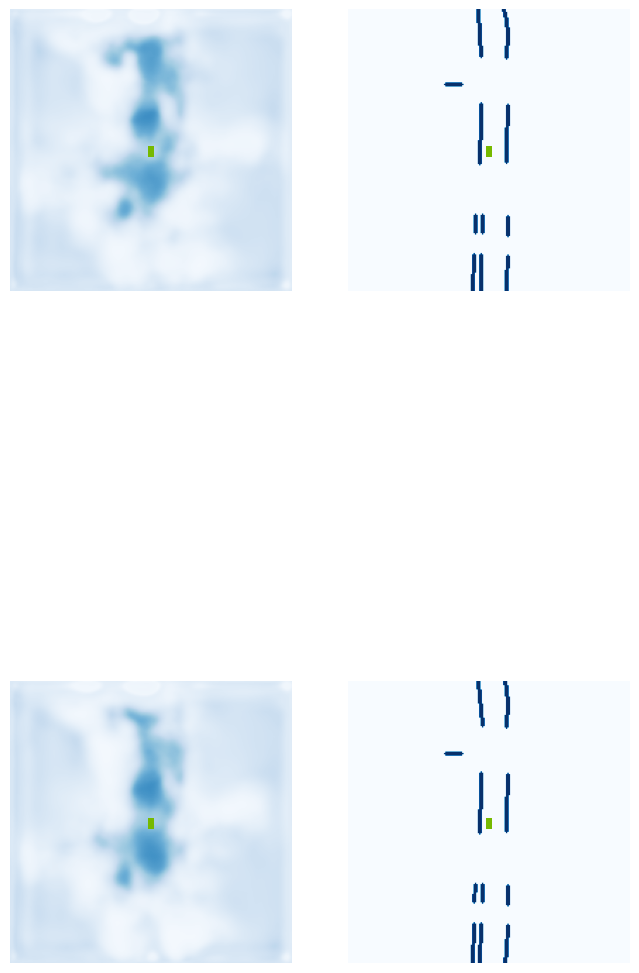

 80%|████████  | 32/40 [03:14<00:41,  5.22s/it]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg


 88%|████████▊ | 35/40 [03:38<00:35,  7.08s/it]

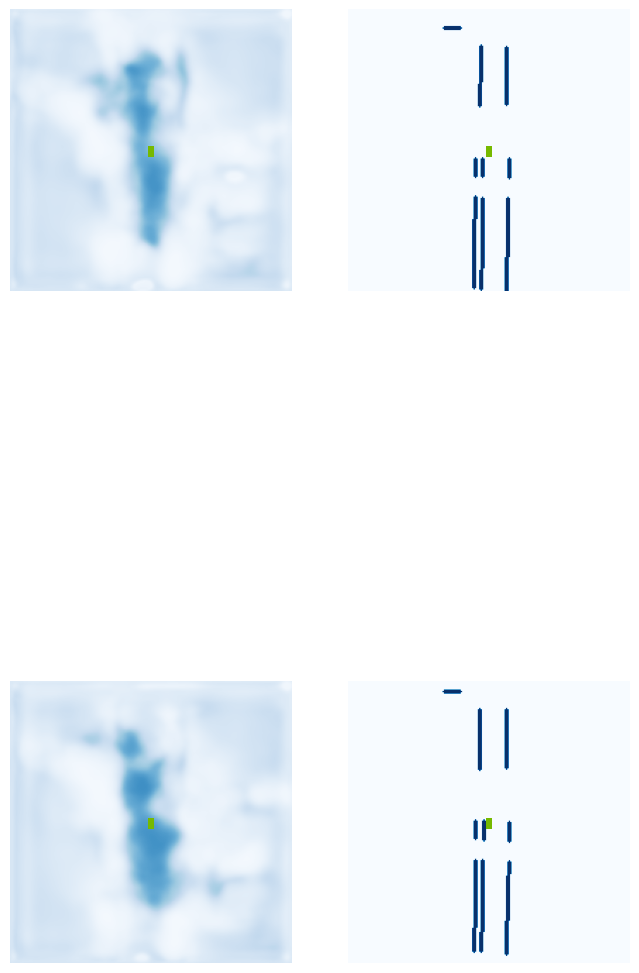

 90%|█████████ | 36/40 [03:38<00:20,  5.07s/it]

Image saved! ... ./runs/get_val_info/35-iou-0.07.jpg


100%|██████████| 40/40 [04:04<00:00,  6.10s/it]


VAL {'loss': 0.2417824853349615, 'iou': 0.024763515587170166}
saving ...  ./runs/model500.pt
510 0.2274821251630783
520 0.27451324462890625
530 0.29526010155677795
540 0.21552284061908722
550 0.2013603150844574
560 0.28557366132736206
570 0.18391719460487366
580 0.2830139696598053
590 0.2795209288597107
600 0.18884438276290894
610 0.2783130407333374
620 0.22304078936576843
630 0.21292228996753693
640 0.17784814536571503
Epoch: 5/60
650 0.16690300405025482
660 0.19811803102493286
670 0.26177290081977844
680 0.21965792775154114
690 0.19760431349277496
700 0.20701444149017334
710 0.2882828414440155
720 0.24181441962718964
730 0.17324714362621307
740 0.22842583060264587
750 0.1806199848651886
760 0.31164994835853577
770 0.22908315062522888
780 0.18218864500522614
790 0.23264215886592865
800 0.27422308921813965
Epoch: 6/60
810 0.295442134141922
820 0.20292048156261444
830 0.21870969235897064
840 0.23339056968688965
850 0.1828543096780777
860 0.17258229851722717
870 0.19621486961841583
880 0

  0%|          | 0/40 [00:00<?, ?it/s]

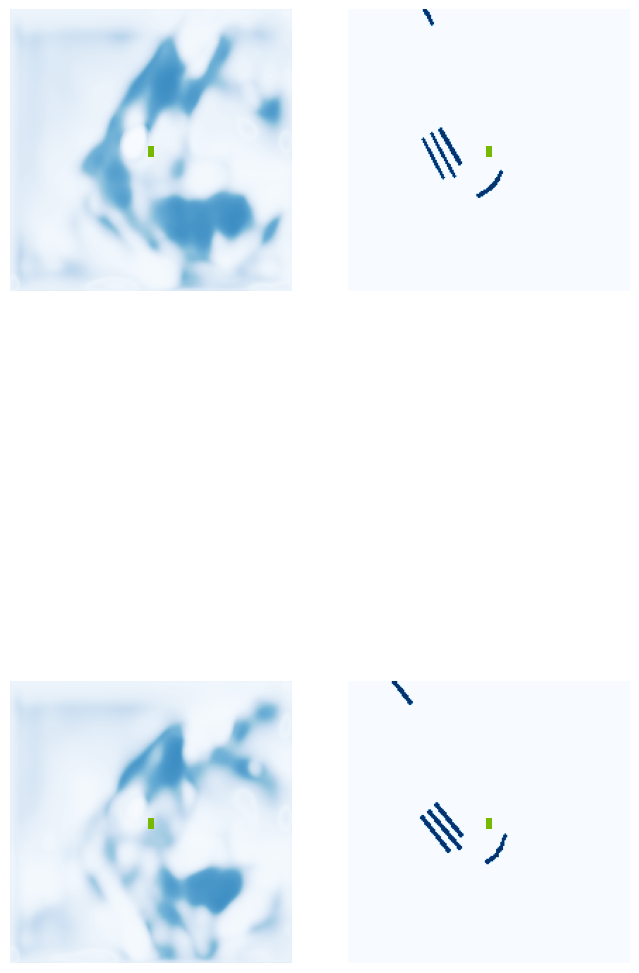

  5%|▌         | 2/40 [00:01<00:19,  1.99it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.01.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.29it/s]

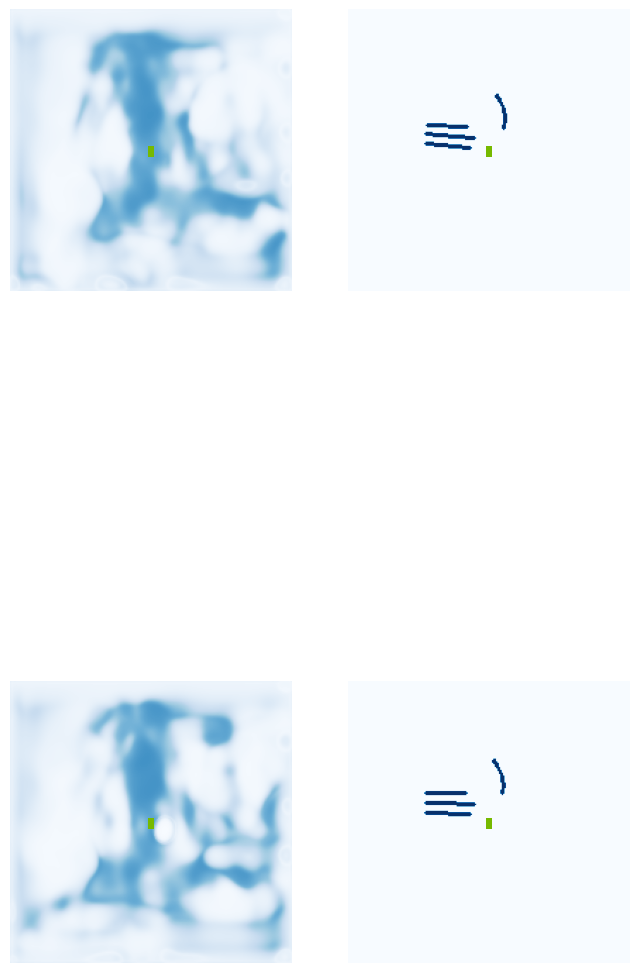

 18%|█▊        | 7/40 [00:02<00:07,  4.71it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.26it/s]

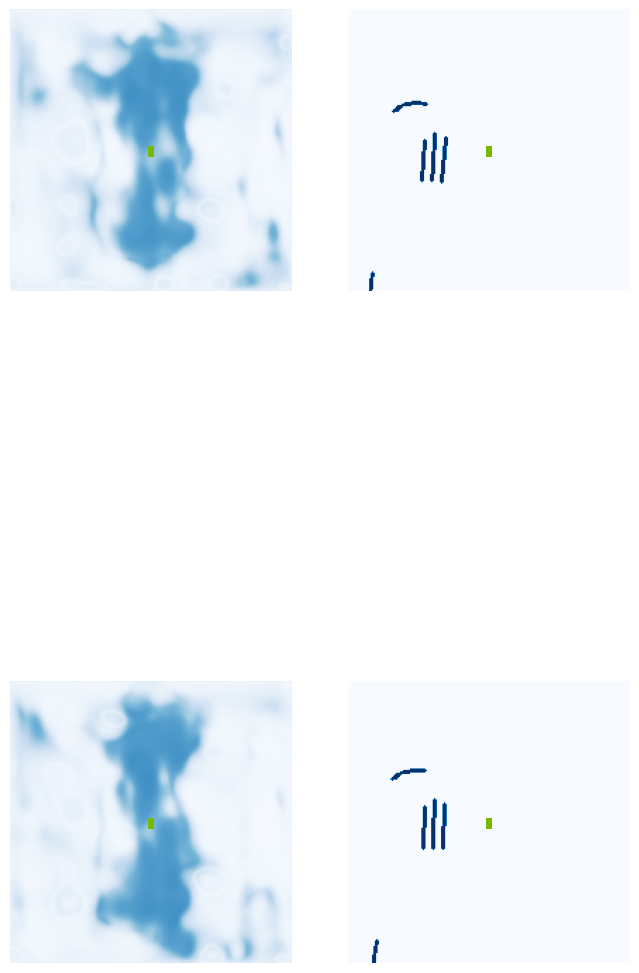

 30%|███       | 12/40 [00:02<00:05,  5.25it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.53it/s]

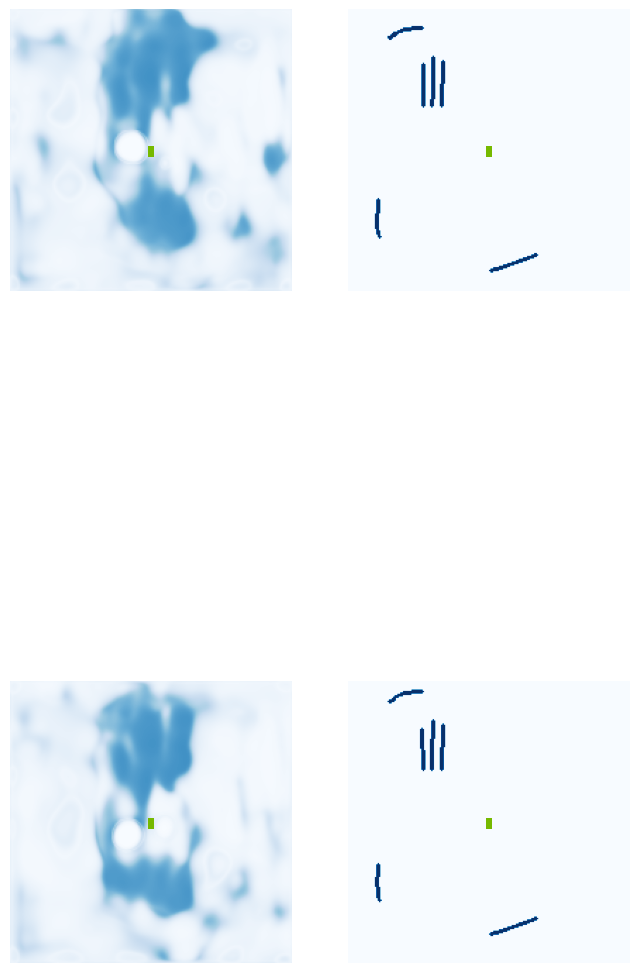

 42%|████▎     | 17/40 [00:03<00:04,  5.40it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:03<00:02,  7.66it/s]

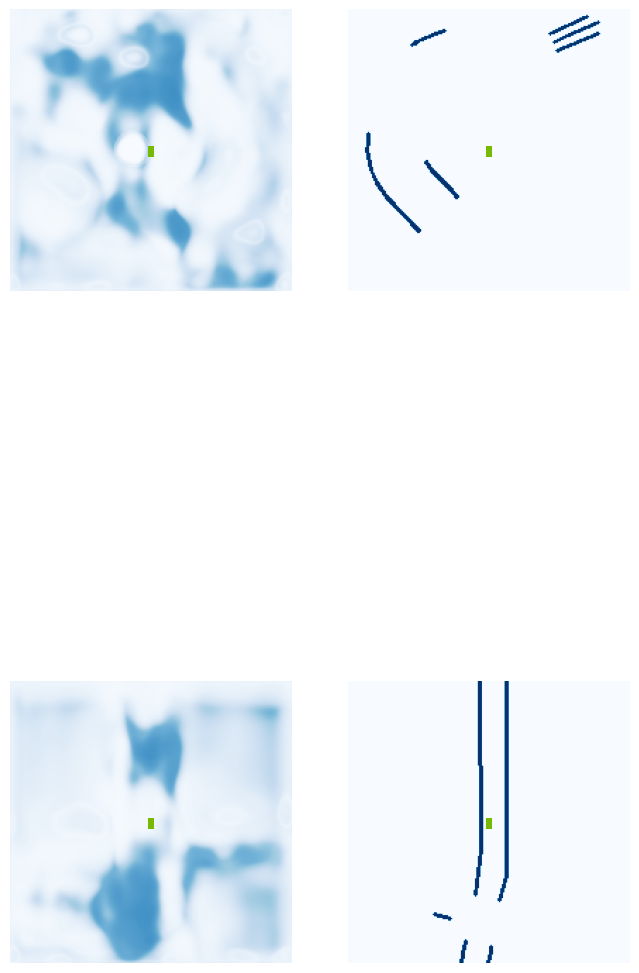

 55%|█████▌    | 22/40 [00:05<00:05,  3.39it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.04.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  5.98it/s]

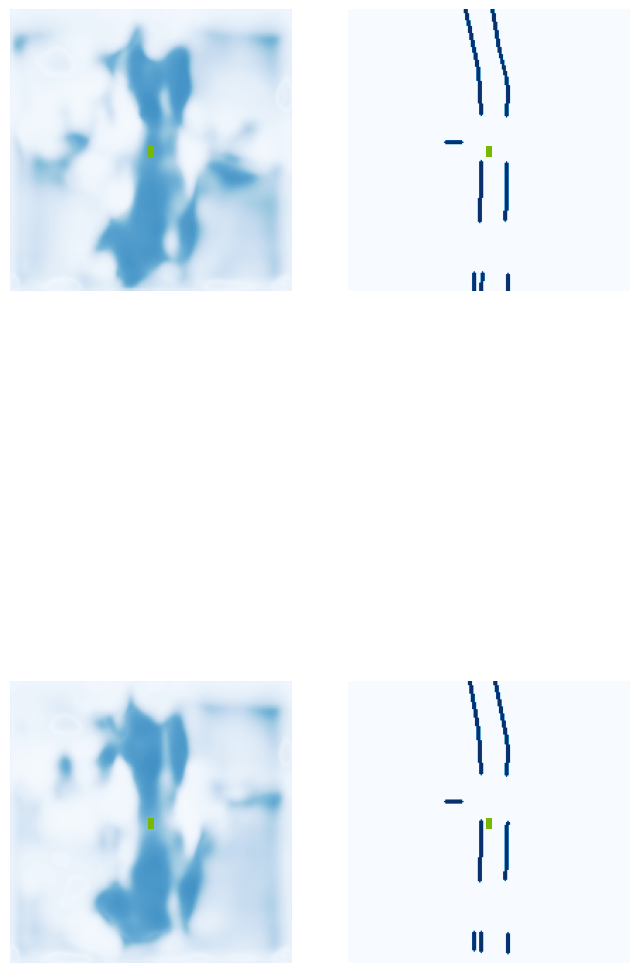

 68%|██████▊   | 27/40 [00:05<00:02,  5.06it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.07.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.79it/s]

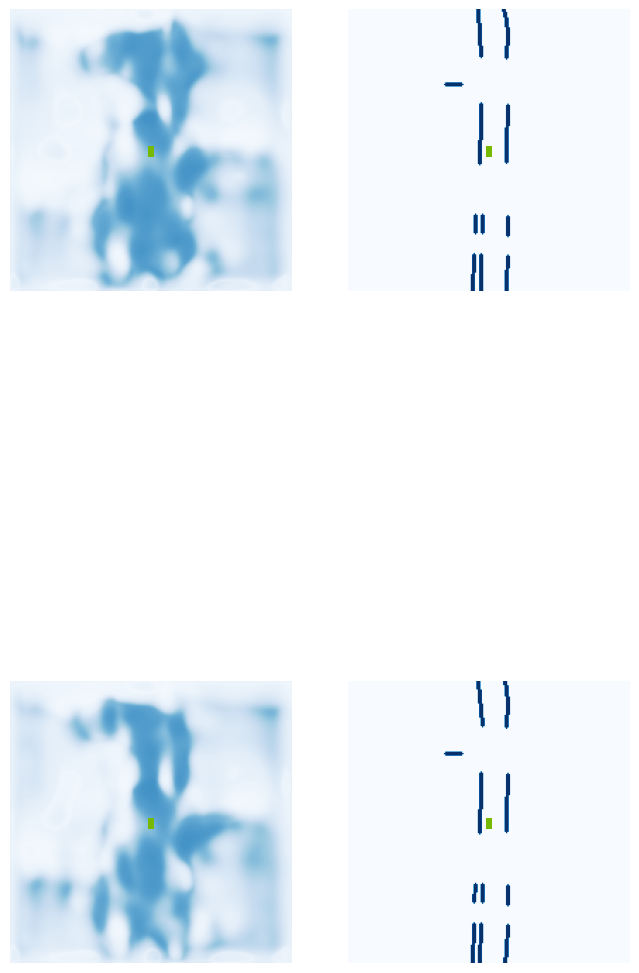

 80%|████████  | 32/40 [00:06<00:01,  5.15it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  7.26it/s]

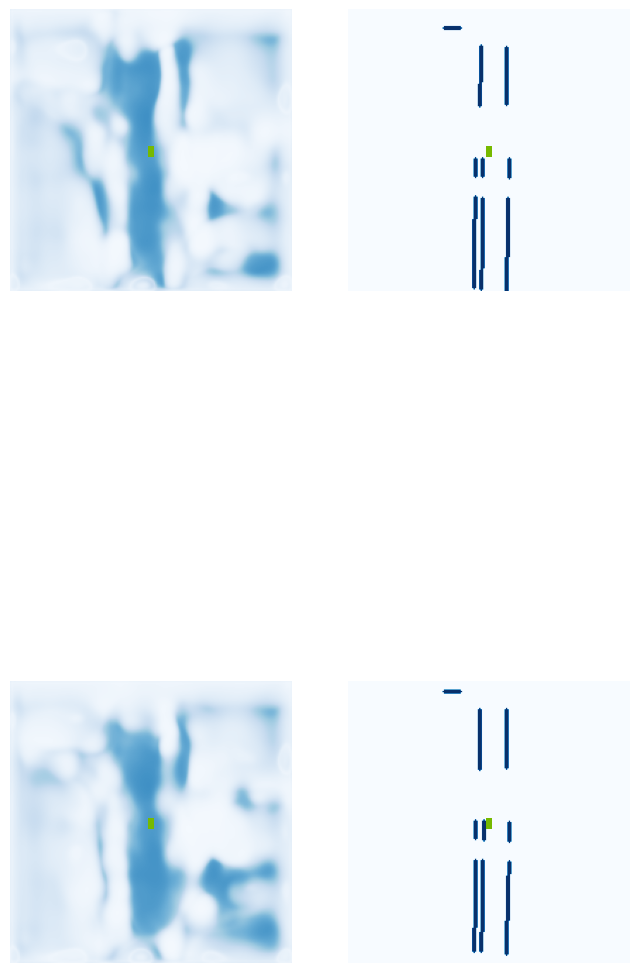

 92%|█████████▎| 37/40 [00:07<00:00,  4.45it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.10.jpg


100%|██████████| 40/40 [00:08<00:00,  4.92it/s]


VAL {'loss': 0.28487765163551143, 'iou': 0.042091132064896834}
saving ...  ./runs/model1000.pt
1010 0.188049778342247
1020 0.2054959386587143
1030 0.14567416906356812
1040 0.18283013999462128
1050 0.23152485489845276
1060 0.1991328001022339
1070 0.17099037766456604
1080 0.2048208862543106
1090 0.2074948400259018
1100 0.15904884040355682
1110 0.15810994803905487
1120 0.22048109769821167
Epoch: 8/60
1130 0.18188324570655823
1140 0.16251526772975922
1150 0.22641053795814514
1160 0.1474221646785736
1170 0.1974351704120636
1180 0.19090905785560608
1190 0.14771965146064758
1200 0.2048211395740509
1210 0.23594491183757782
1220 0.313437819480896
1230 0.23099814355373383
1240 0.2332739233970642
1250 0.17728301882743835
1260 0.14397132396697998
1270 0.16538026928901672
1280 0.2342168092727661
Epoch: 9/60
1290 0.2455294132232666
1300 0.12123698741197586
1310 0.30282267928123474
1320 0.19304794073104858
1330 0.23411720991134644
1340 0.12978647649288177
1350 0.12086345255374908
1360 0.1662454307079

  0%|          | 0/40 [00:00<?, ?it/s]

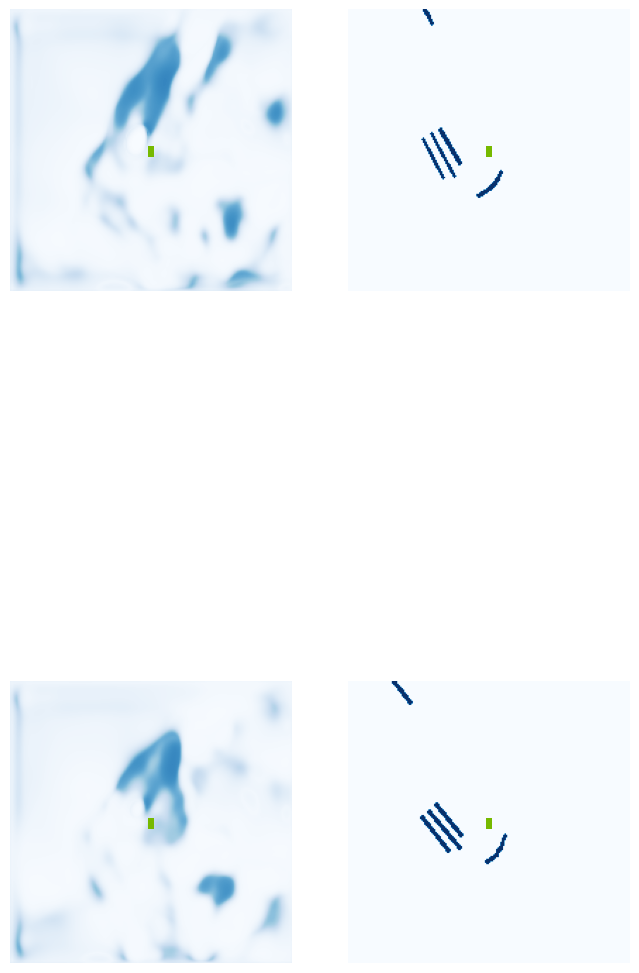

  5%|▌         | 2/40 [00:01<00:19,  1.95it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.14it/s]

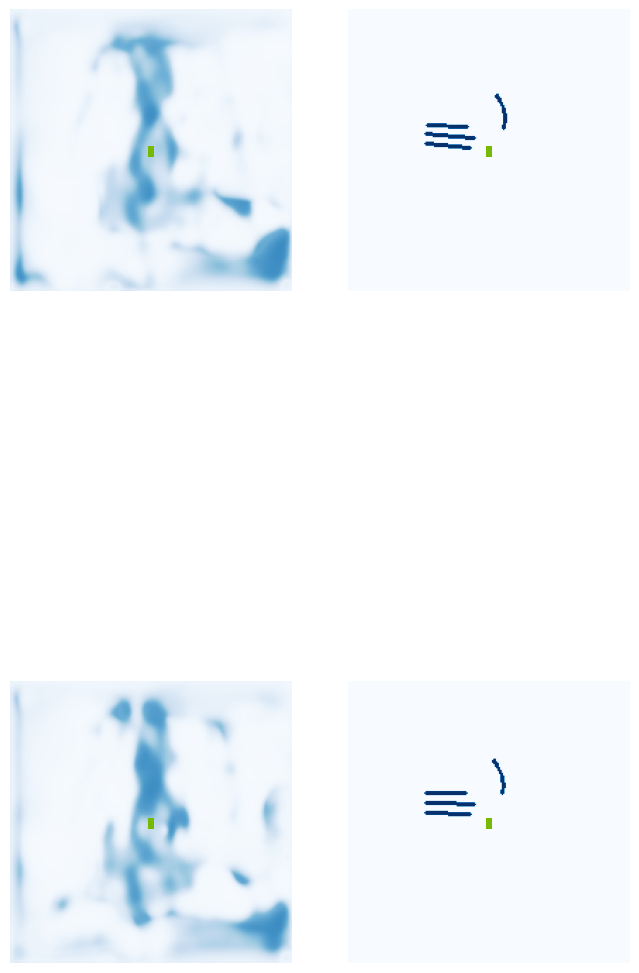

 18%|█▊        | 7/40 [00:02<00:07,  4.70it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.04it/s]

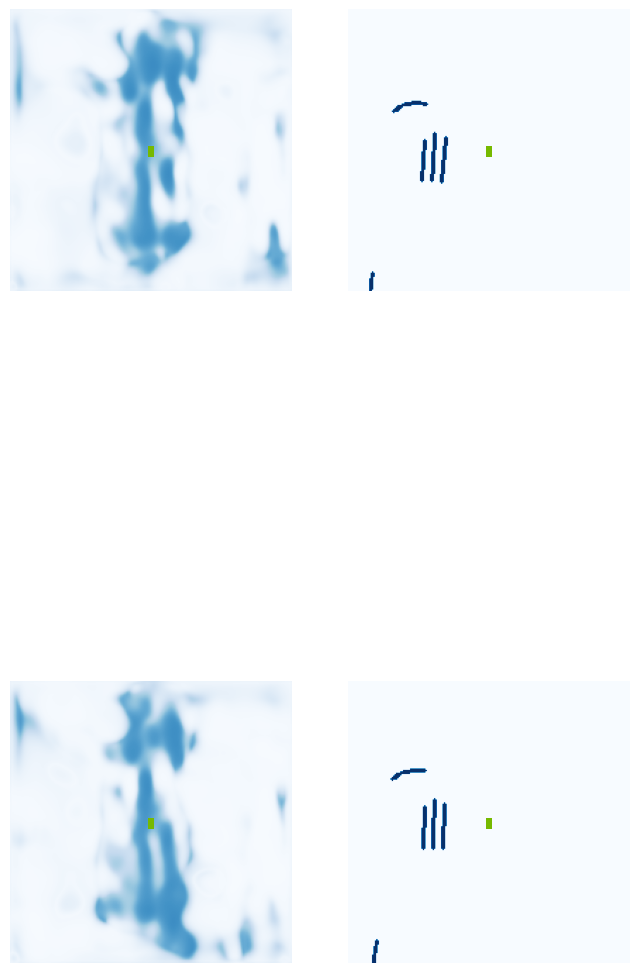

 30%|███       | 12/40 [00:02<00:06,  4.66it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.78it/s]

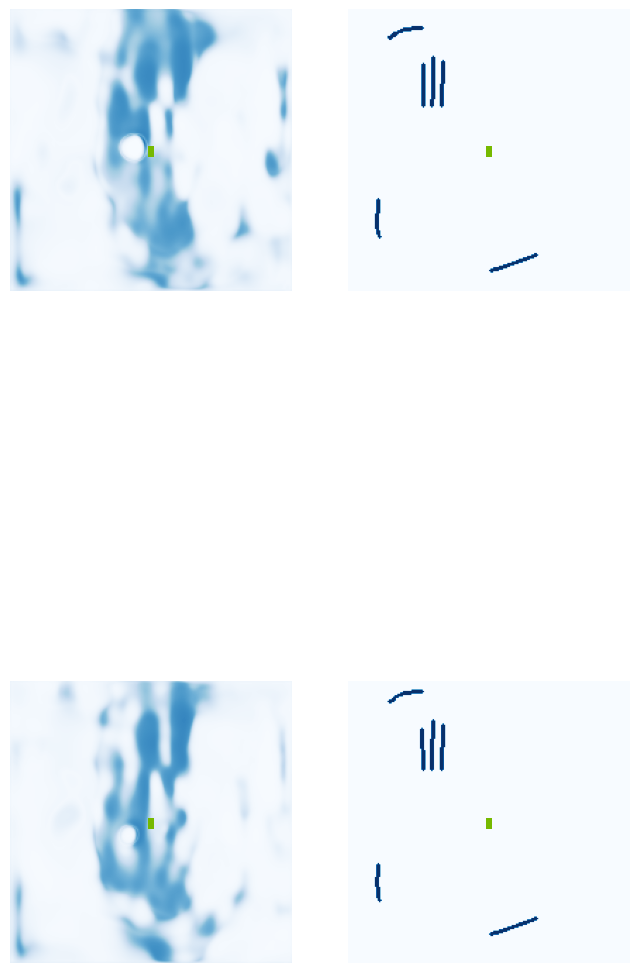

 42%|████▎     | 17/40 [00:03<00:04,  4.88it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.20it/s]

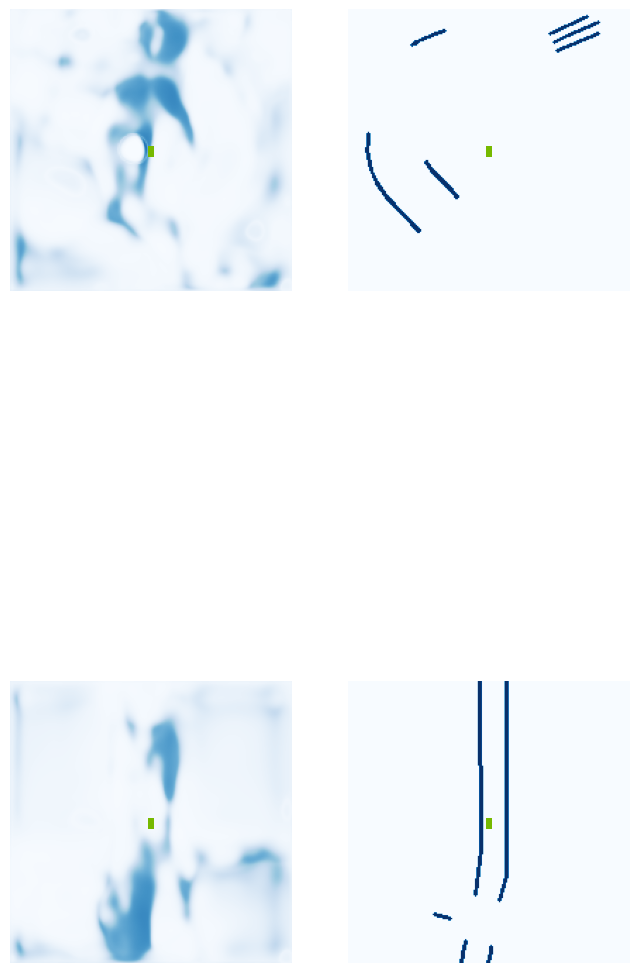

 55%|█████▌    | 22/40 [00:04<00:03,  4.87it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.05.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  7.16it/s]

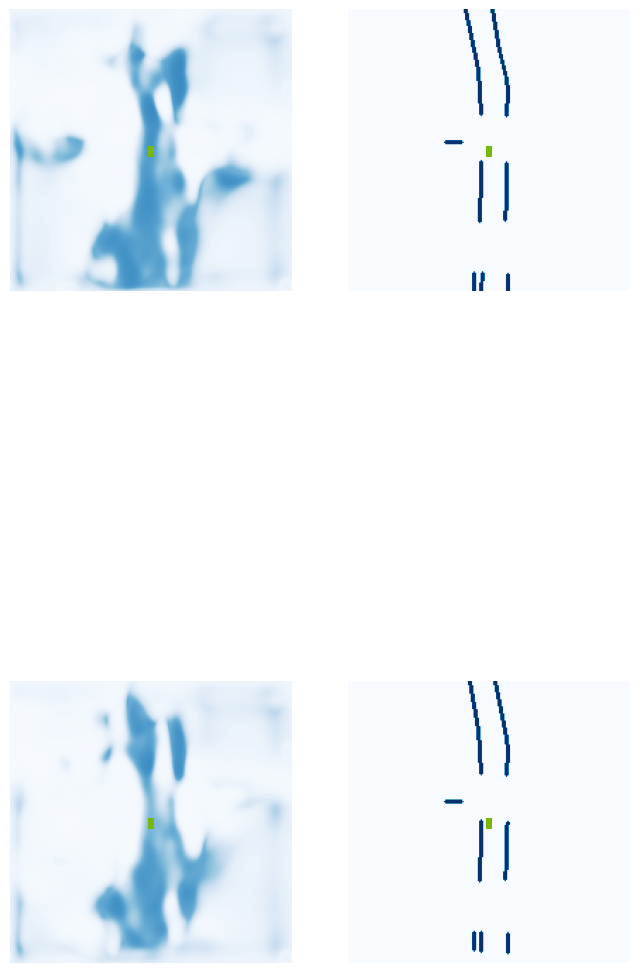

 68%|██████▊   | 27/40 [00:05<00:02,  5.42it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.07.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.87it/s]

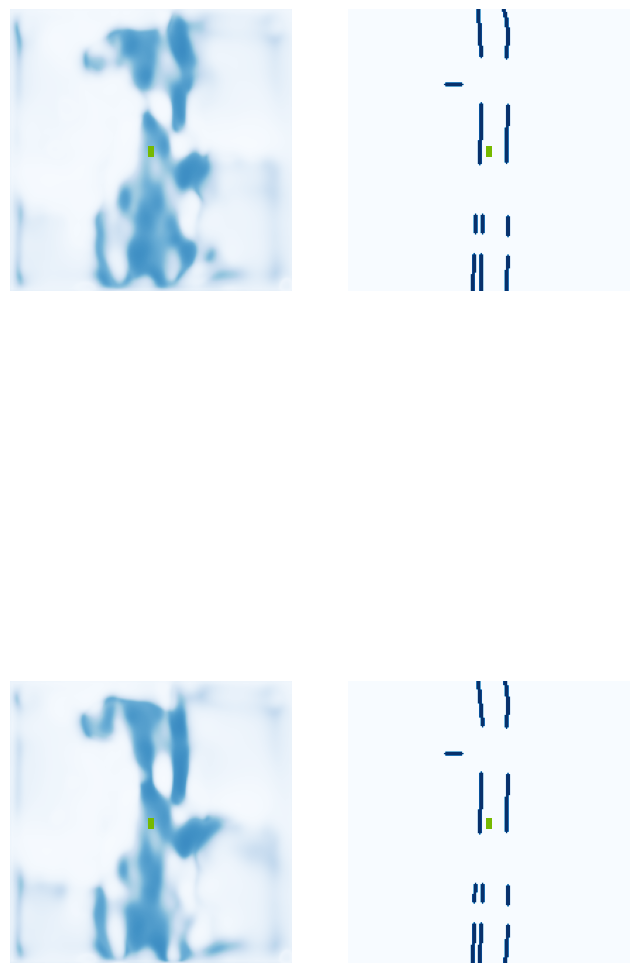

 80%|████████  | 32/40 [00:06<00:01,  4.37it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.53it/s]

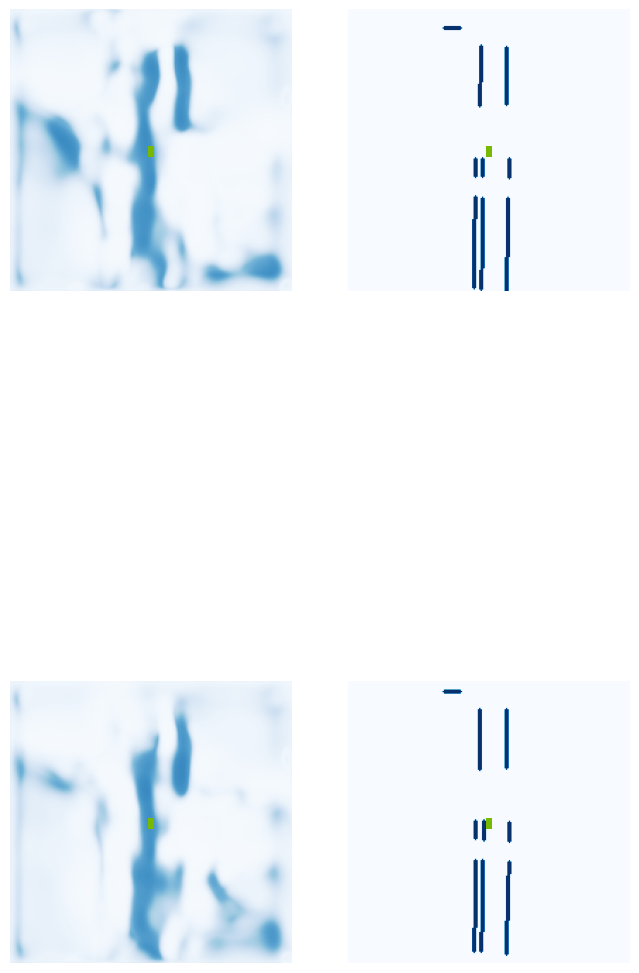

 92%|█████████▎| 37/40 [00:07<00:00,  3.68it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.11.jpg


100%|██████████| 40/40 [00:08<00:00,  4.81it/s]


VAL {'loss': 0.23255290550950133, 'iou': 0.0431149323349005}
saving ...  ./runs/model1500.pt
1510 0.20900724828243256
1520 0.17287904024124146
1530 0.16839642822742462
1540 0.13138459622859955
1550 0.17041054368019104
1560 0.14286541938781738
1570 0.20336490869522095
1580 0.1988261193037033
1590 0.13737182319164276
1600 0.16534782946109772
1610 0.25039932131767273
Epoch: 11/60
1620 0.19448204338550568
1630 0.13472910225391388
1640 0.15688031911849976
1650 0.13256408274173737
1660 0.21893614530563354
1670 0.1793898493051529
1680 0.1731746792793274
1690 0.18847915530204773
1700 0.20068280398845673
1710 0.16372527182102203
1720 0.16644150018692017
1730 0.1961711198091507
1740 0.15783411264419556
1750 0.18642836809158325
1760 0.2327406257390976
1770 0.20601969957351685
Epoch: 12/60
1780 0.10907189548015594
1790 0.21291722357273102
1800 0.17921589314937592
1810 0.15606147050857544
1820 0.16947688162326813
1830 0.16860398650169373
1840 0.12450683116912842
1850 0.109388068318367
1860 0.124346

  0%|          | 0/40 [00:00<?, ?it/s]

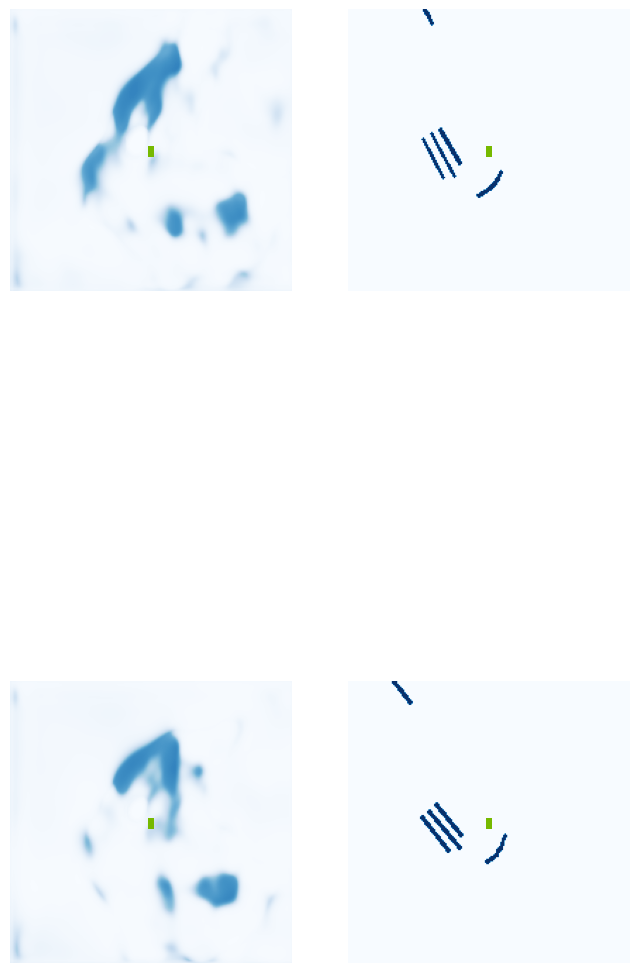

  5%|▌         | 2/40 [00:01<00:18,  2.01it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.01.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.37it/s]

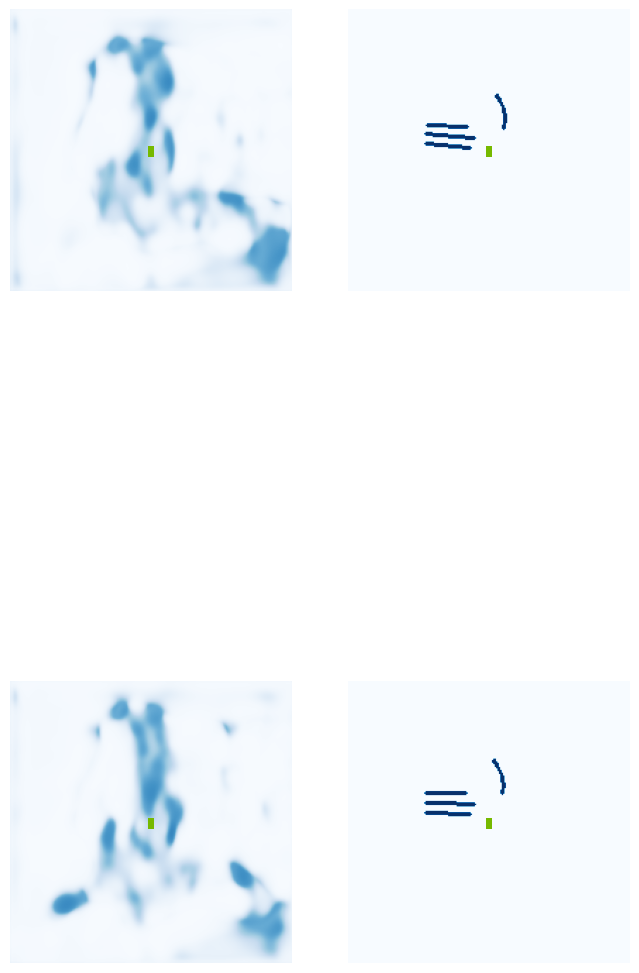

 18%|█▊        | 7/40 [00:02<00:07,  4.55it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.12it/s]

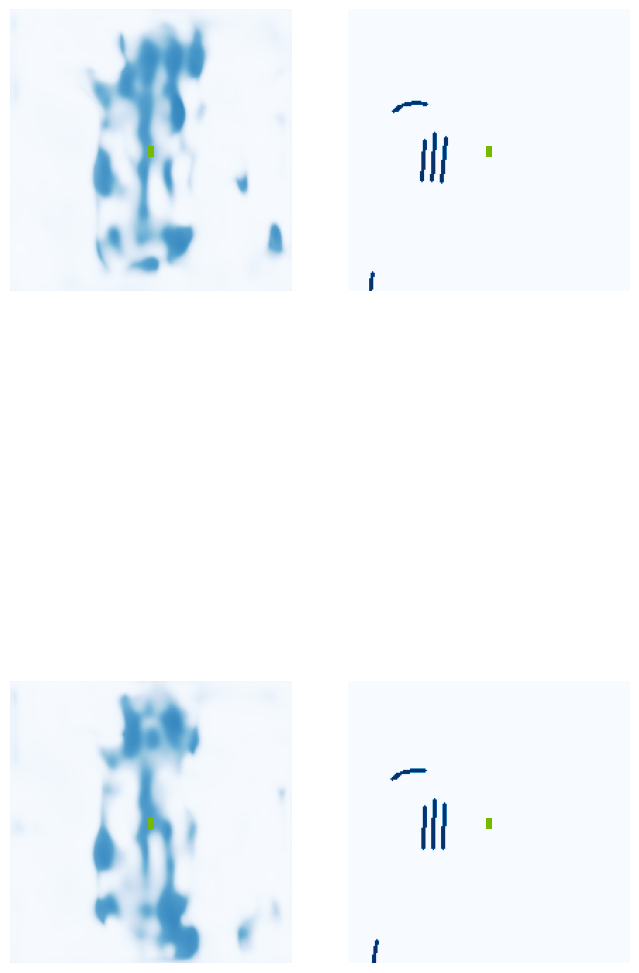

 30%|███       | 12/40 [00:02<00:05,  5.25it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.02.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.41it/s]

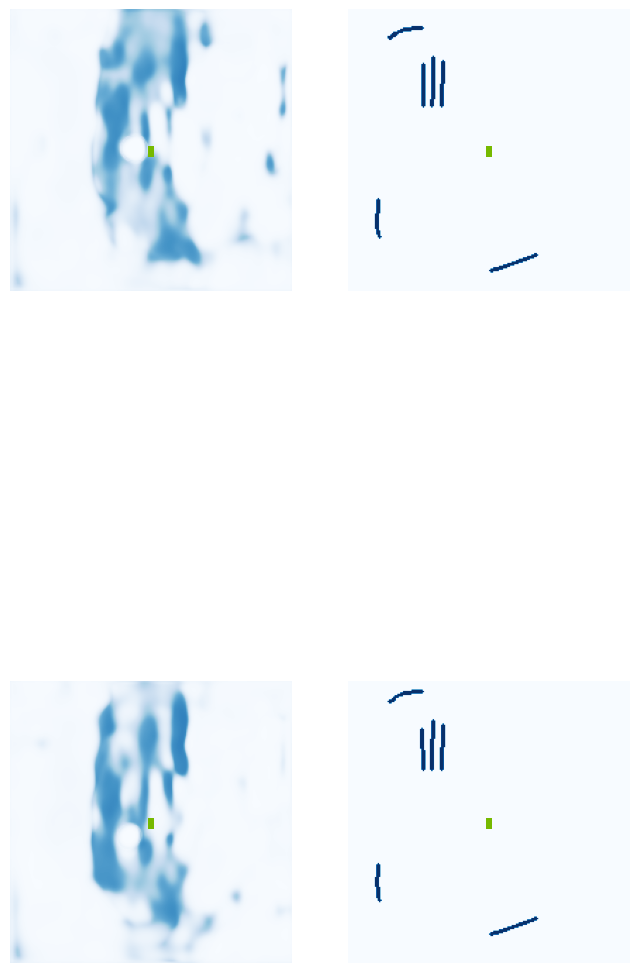

 42%|████▎     | 17/40 [00:03<00:04,  4.66it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.02.jpg


 50%|█████     | 20/40 [00:04<00:02,  6.92it/s]

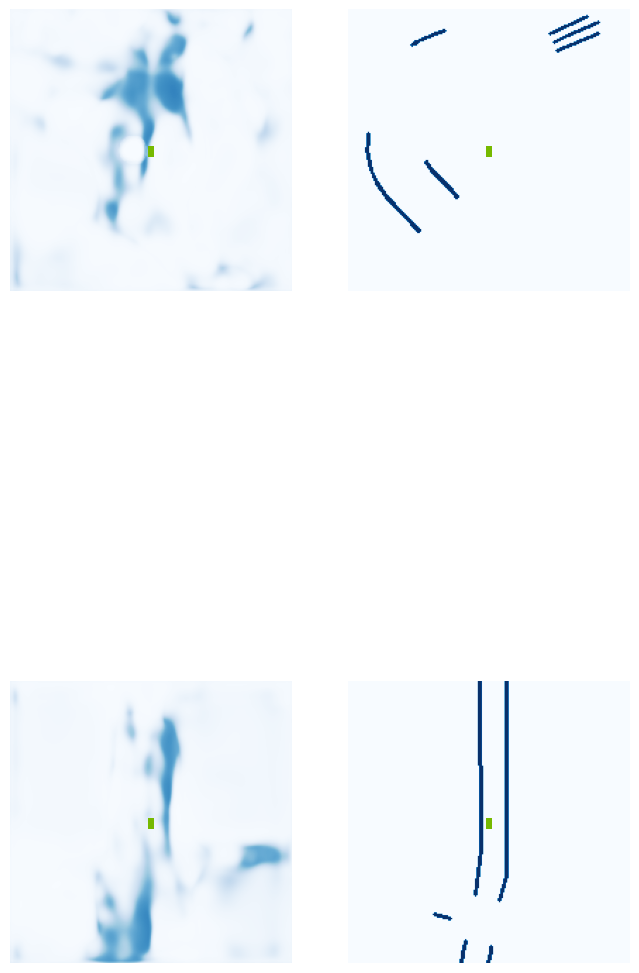

 55%|█████▌    | 22/40 [00:04<00:03,  5.03it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.05.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.22it/s]

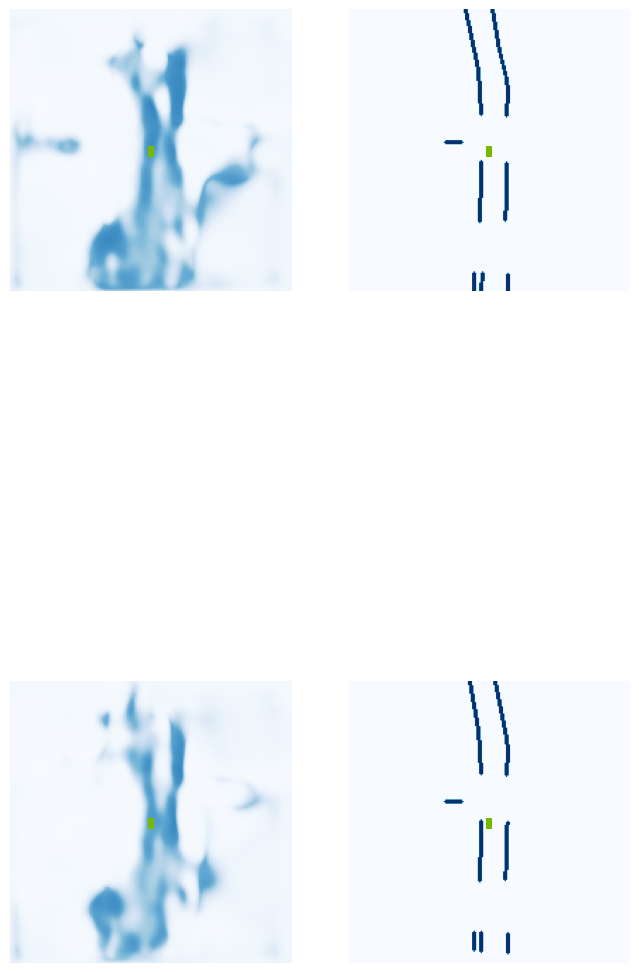

 68%|██████▊   | 27/40 [00:05<00:02,  4.62it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.05.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.57it/s]

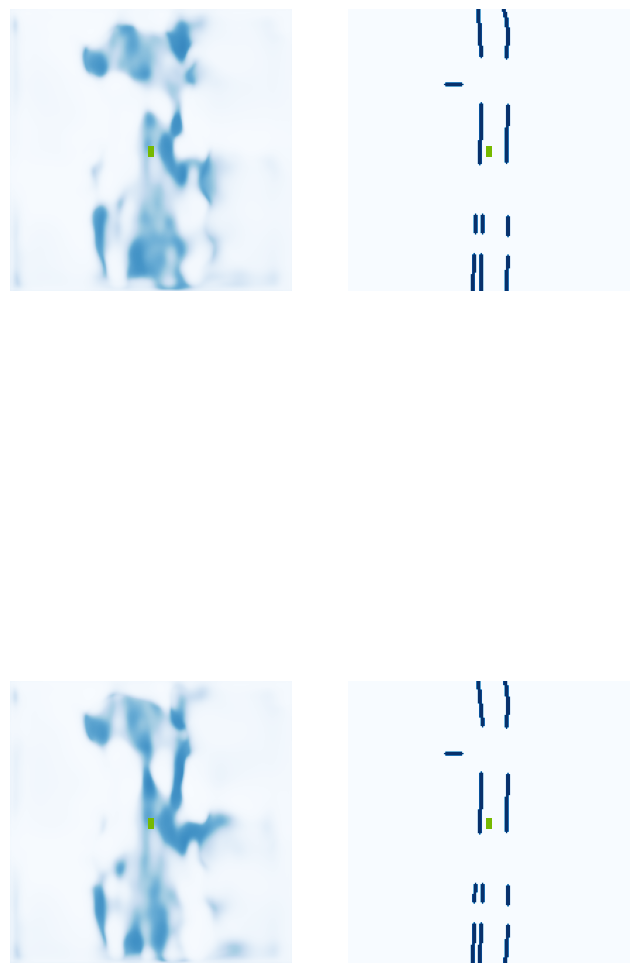

 80%|████████  | 32/40 [00:06<00:01,  4.50it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.42it/s]

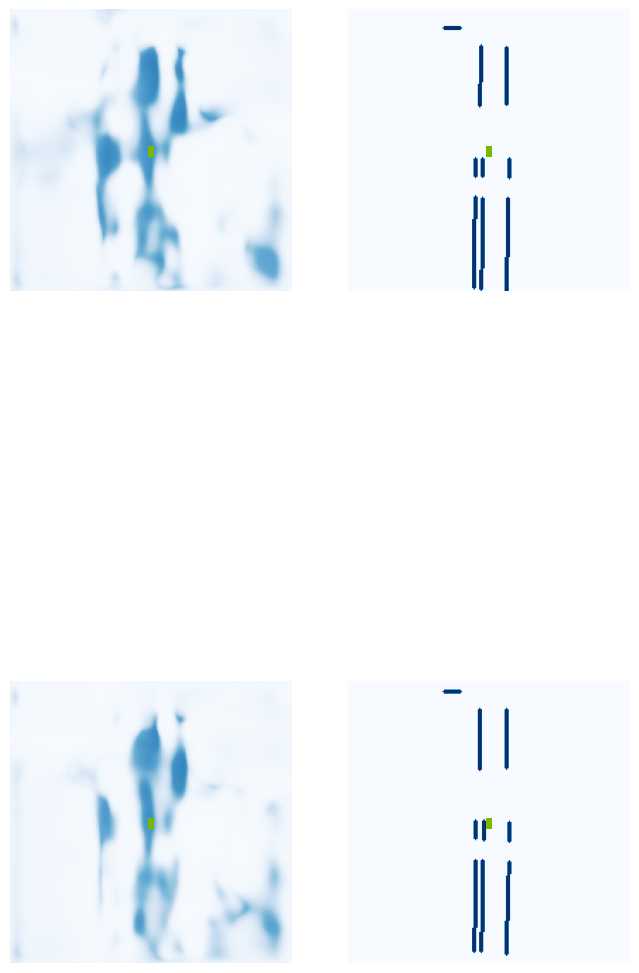

 92%|█████████▎| 37/40 [00:07<00:00,  5.10it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.08.jpg


100%|██████████| 40/40 [00:08<00:00,  4.99it/s]


VAL {'loss': 0.1989718351835086, 'iou': 0.04711812505188205}
saving ...  ./runs/model2000.pt
2010 0.12530352175235748
2020 0.25182080268859863
2030 0.17132779955863953
2040 0.11730451136827469
2050 0.17371943593025208
2060 0.20821693539619446
2070 0.19906270503997803
2080 0.13089726865291595
2090 0.17374274134635925
Epoch: 14/60
2100 0.16747570037841797
2110 0.11741122603416443
2120 0.21650946140289307
2130 0.14568839967250824
2140 0.16512392461299896
2150 0.12476462125778198
2160 0.15205374360084534
2170 0.18804378807544708
2180 0.19033603370189667
2190 0.17752724885940552
2200 0.20352214574813843
2210 0.14568668603897095
2220 0.17219625413417816
2230 0.2512199282646179
2240 0.15760555863380432
2250 0.12069345265626907
Epoch: 15/60
2260 0.1026988998055458
2270 0.1498347669839859
2280 0.161637544631958
2290 0.1522865742444992
2300 0.20241162180900574
2310 0.11429645866155624
2320 0.1461281031370163
2330 0.11810590326786041
2340 0.176004096865654
2350 0.14720918238162994
2360 0.16929492

  0%|          | 0/40 [00:00<?, ?it/s]

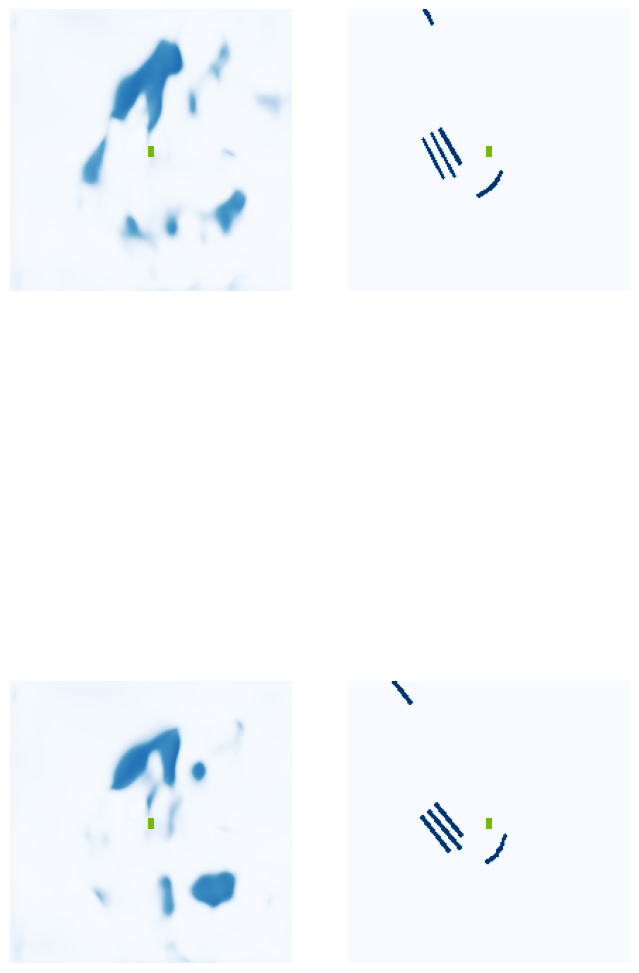

  5%|▌         | 2/40 [00:01<00:17,  2.14it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.01.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.48it/s]

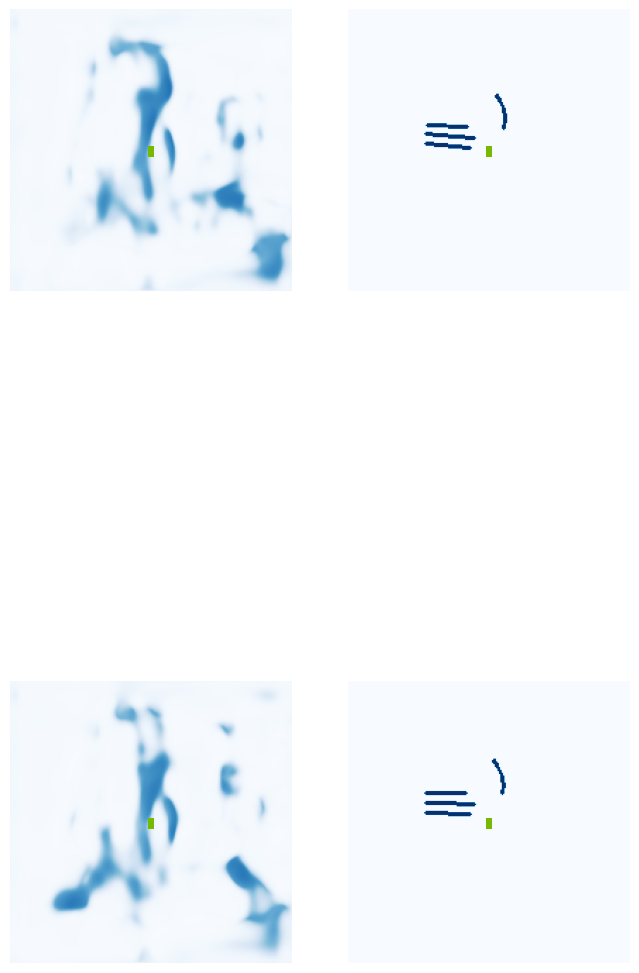

 18%|█▊        | 7/40 [00:01<00:07,  4.67it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.20it/s]

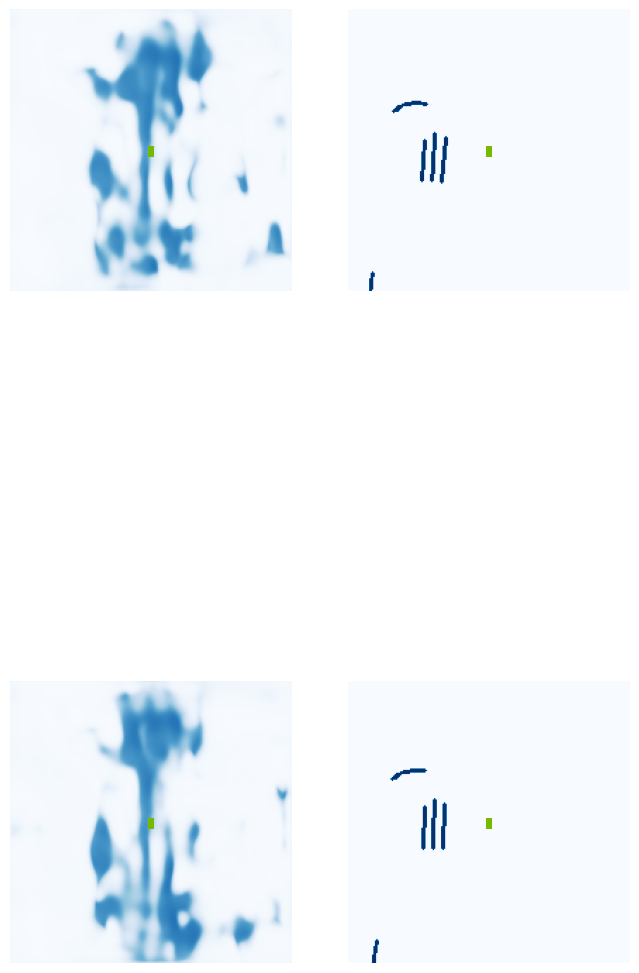

 30%|███       | 12/40 [00:02<00:05,  4.67it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.02.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.02it/s]

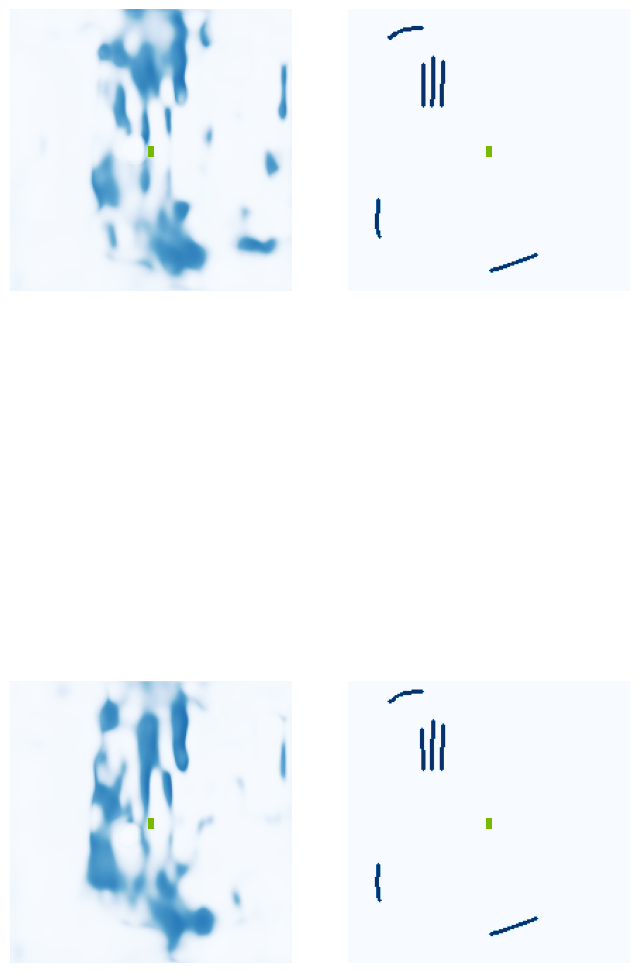

 45%|████▌     | 18/40 [00:03<00:03,  5.96it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.02.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.07it/s]

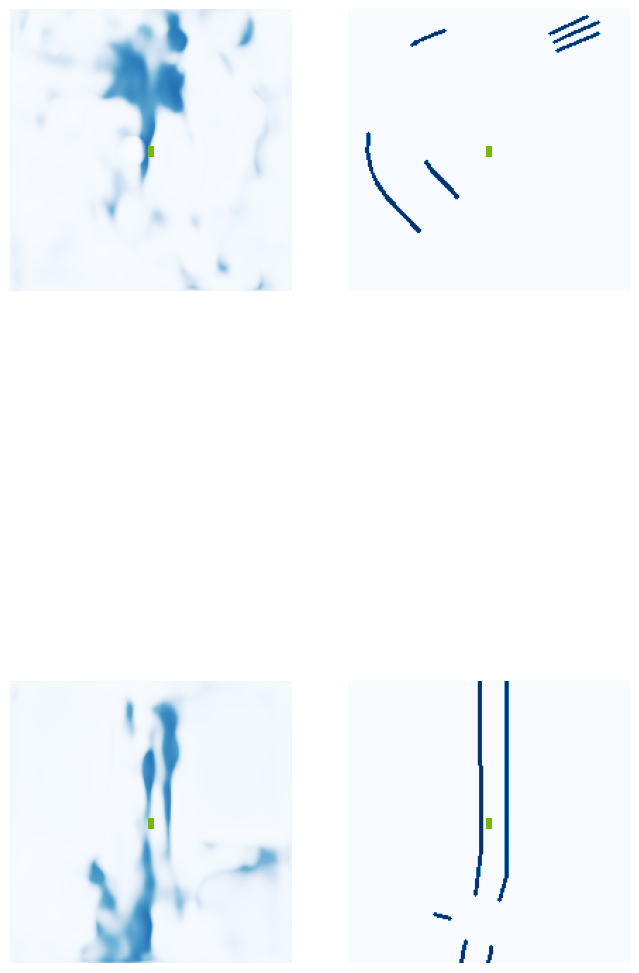

 55%|█████▌    | 22/40 [00:04<00:03,  5.31it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.06.jpg


 62%|██████▎   | 25/40 [00:04<00:02,  6.25it/s]

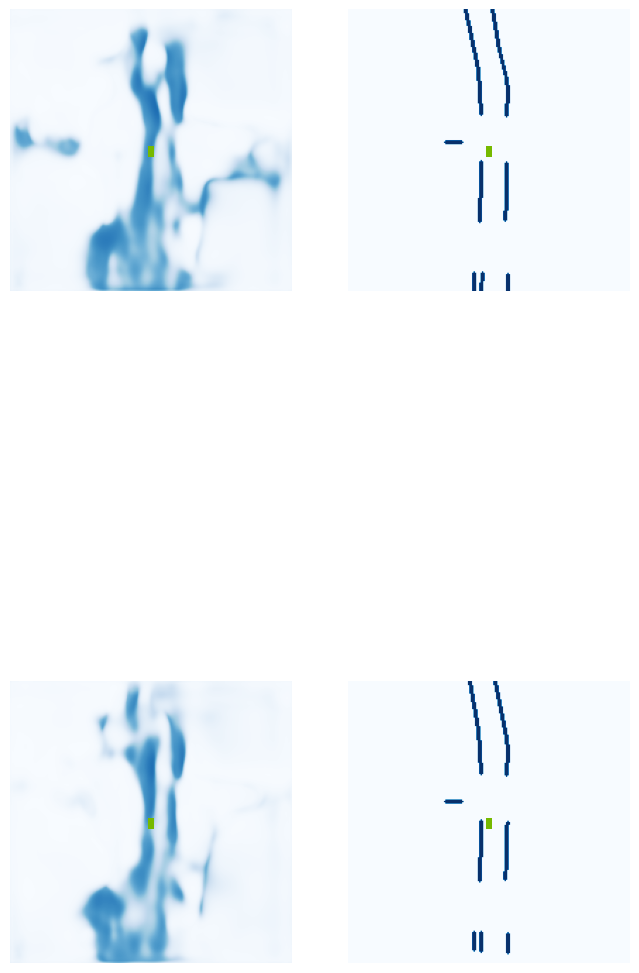

 68%|██████▊   | 27/40 [00:05<00:02,  4.55it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.07.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.98it/s]

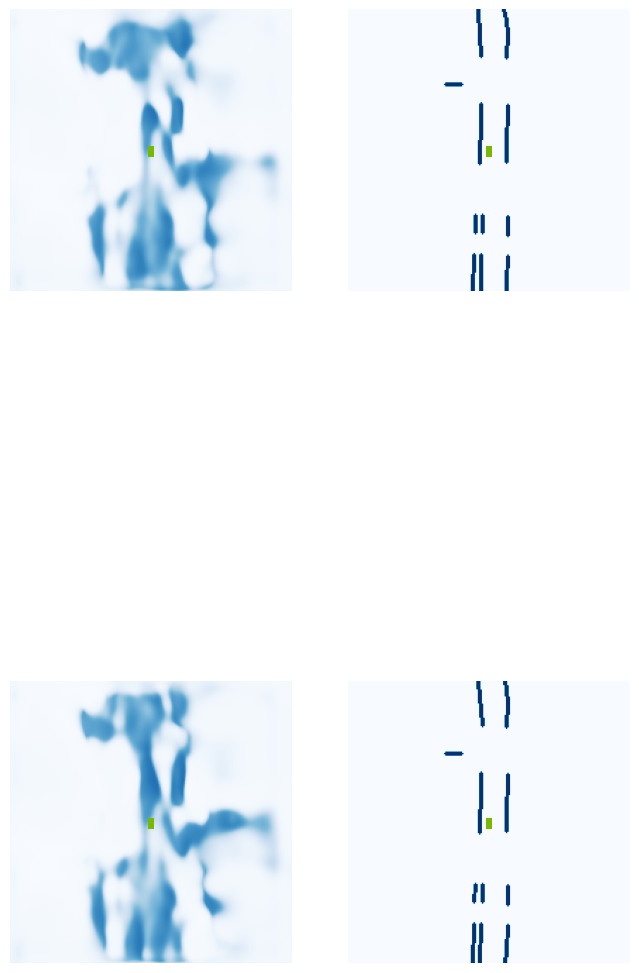

 80%|████████  | 32/40 [00:06<00:01,  4.27it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.08.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.71it/s]

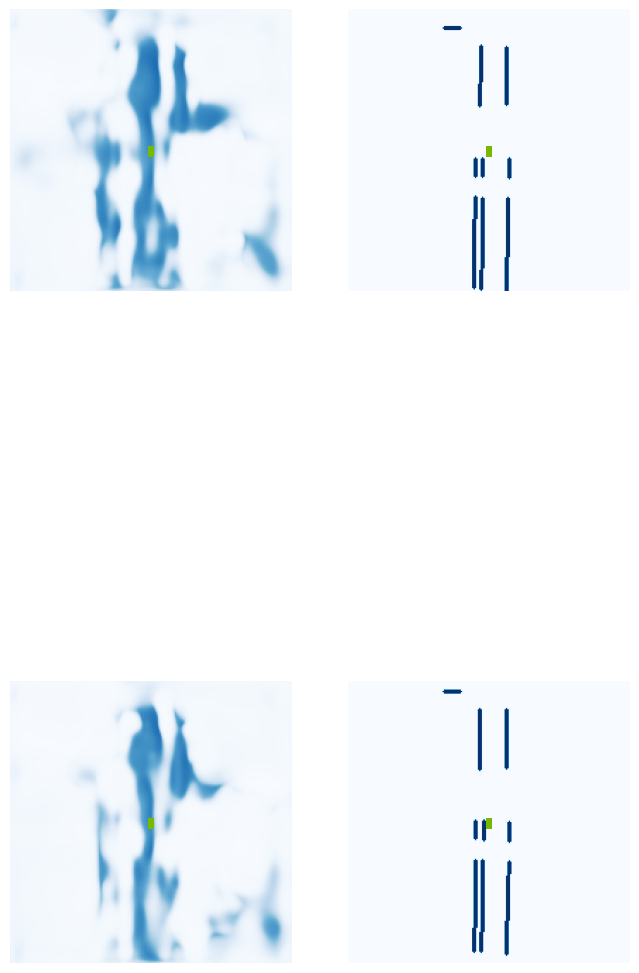

 92%|█████████▎| 37/40 [00:07<00:00,  4.19it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.12.jpg


100%|██████████| 40/40 [00:08<00:00,  4.93it/s]


VAL {'loss': 0.2084205757688593, 'iou': 0.06096993171205701}
saving ...  ./runs/model2500.pt
2510 0.17847931385040283
2520 0.17665208876132965
2530 0.10535546392202377
2540 0.17239229381084442
2550 0.18270377814769745
2560 0.11710995435714722
2570 0.13986459374427795
Epoch: 17/60
2580 0.08840996026992798
2590 0.12940040230751038
2600 0.17341972887516022
2610 0.1504376232624054
2620 0.12680582702159882
2630 0.14441779255867004
2640 0.11369333416223526
2650 0.14656813442707062
2660 0.14757907390594482
2670 0.13857410848140717
2680 0.194236159324646
2690 0.216959148645401
2700 0.0962742492556572
2710 0.19914203882217407
2720 0.14041168987751007
2730 0.09573613107204437
Epoch: 18/60
2740 0.08956333994865417
2750 0.12872952222824097
2760 0.1150682345032692
2770 0.1694774180650711
2780 0.12823784351348877
2790 0.11879195272922516
2800 0.11896037310361862
2810 0.16810622811317444
2820 0.19157803058624268
2830 0.12009324878454208
2840 0.113679438829422
2850 0.16213585436344147
2860 0.152144983

  0%|          | 0/40 [00:00<?, ?it/s]

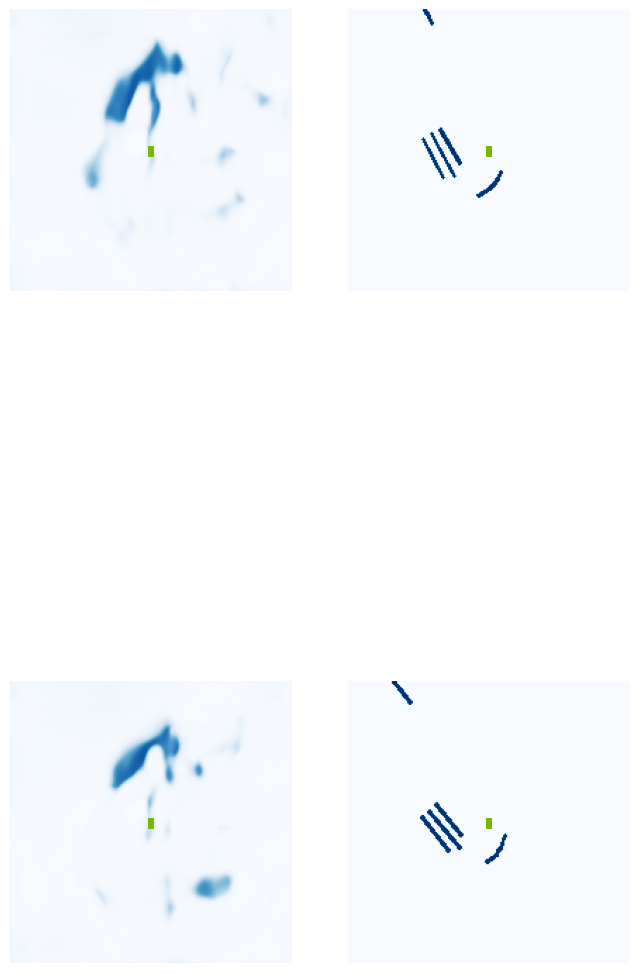

  5%|▌         | 2/40 [00:01<00:18,  2.05it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.44it/s]

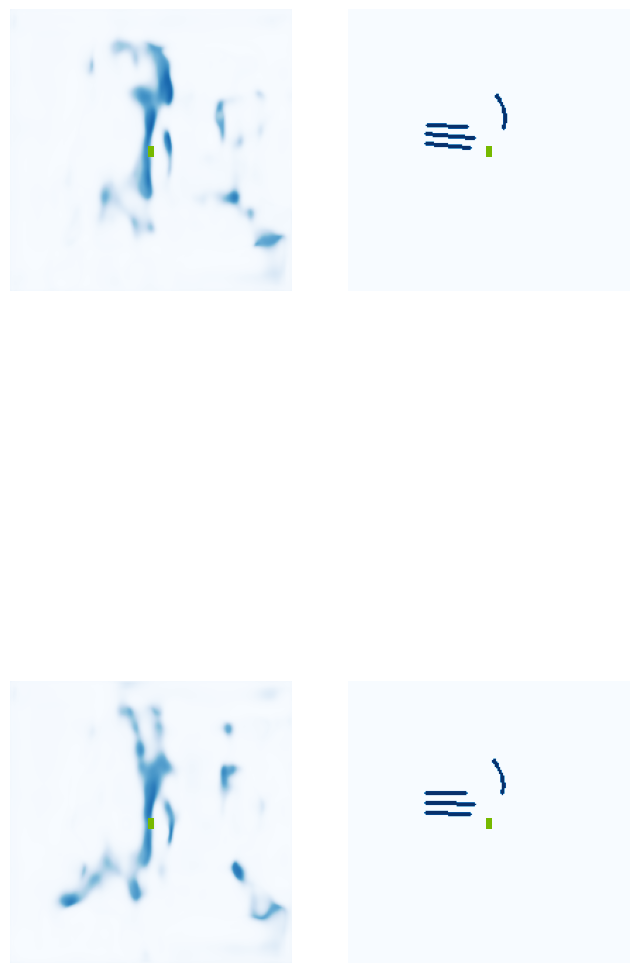

 18%|█▊        | 7/40 [00:01<00:07,  4.59it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.02.jpg


 25%|██▌       | 10/40 [00:02<00:04,  6.55it/s]

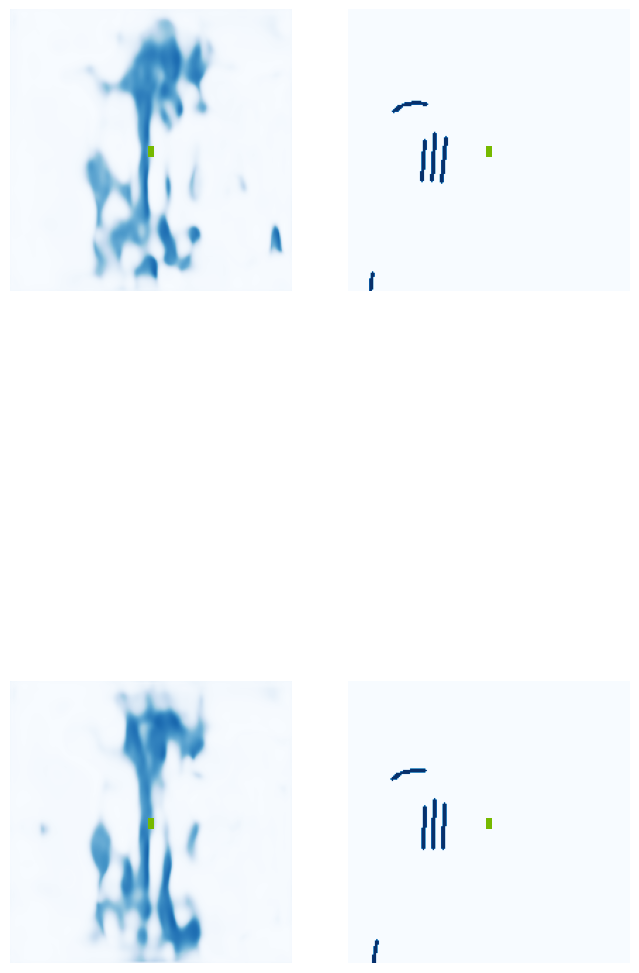

 30%|███       | 12/40 [00:02<00:05,  5.29it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.61it/s]

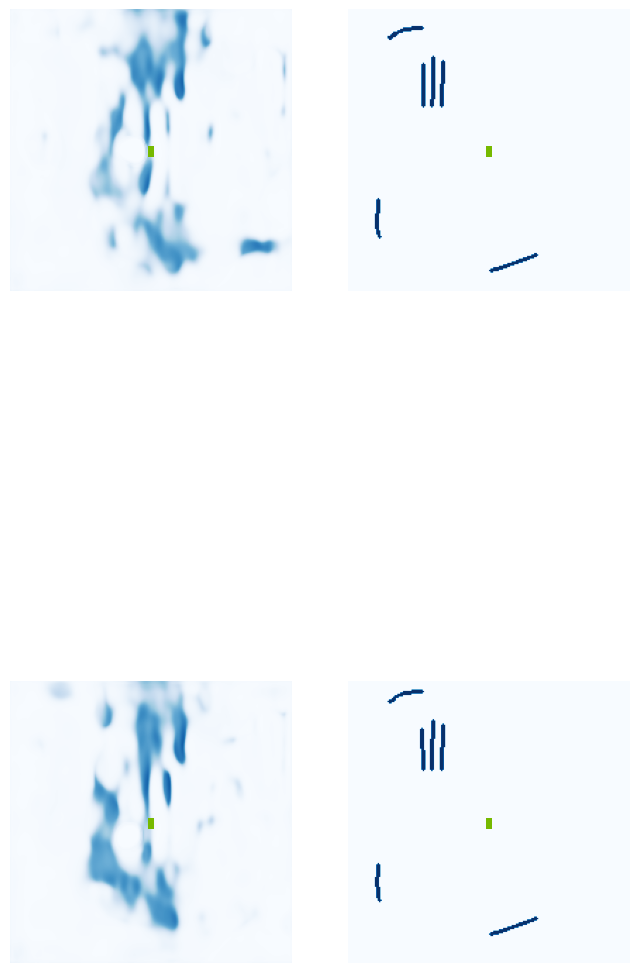

 42%|████▎     | 17/40 [00:03<00:04,  4.89it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.01.jpg


 50%|█████     | 20/40 [00:04<00:02,  6.91it/s]

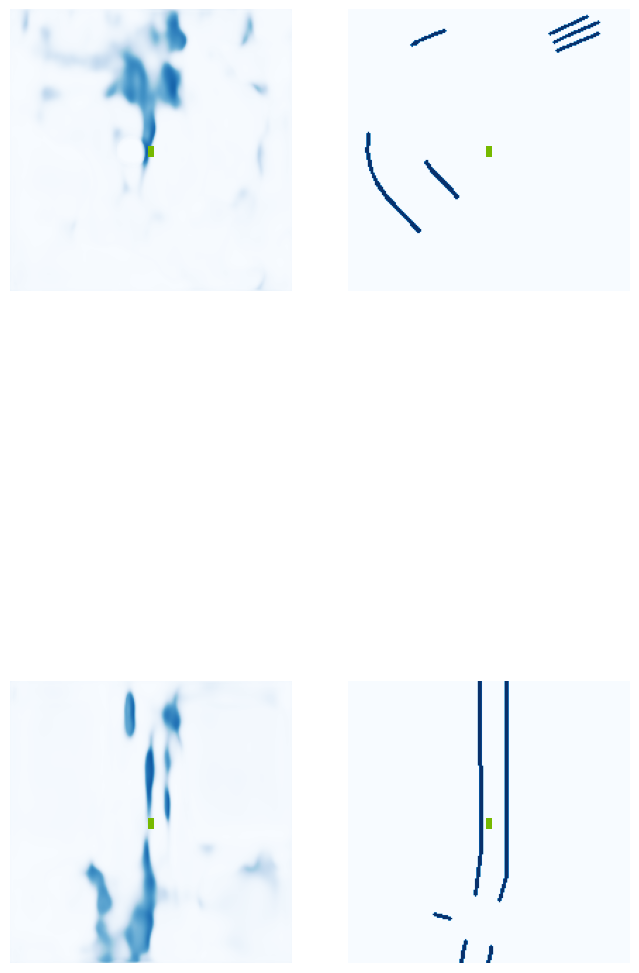

 55%|█████▌    | 22/40 [00:04<00:03,  5.33it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.03.jpg


 60%|██████    | 24/40 [00:04<00:02,  5.84it/s]

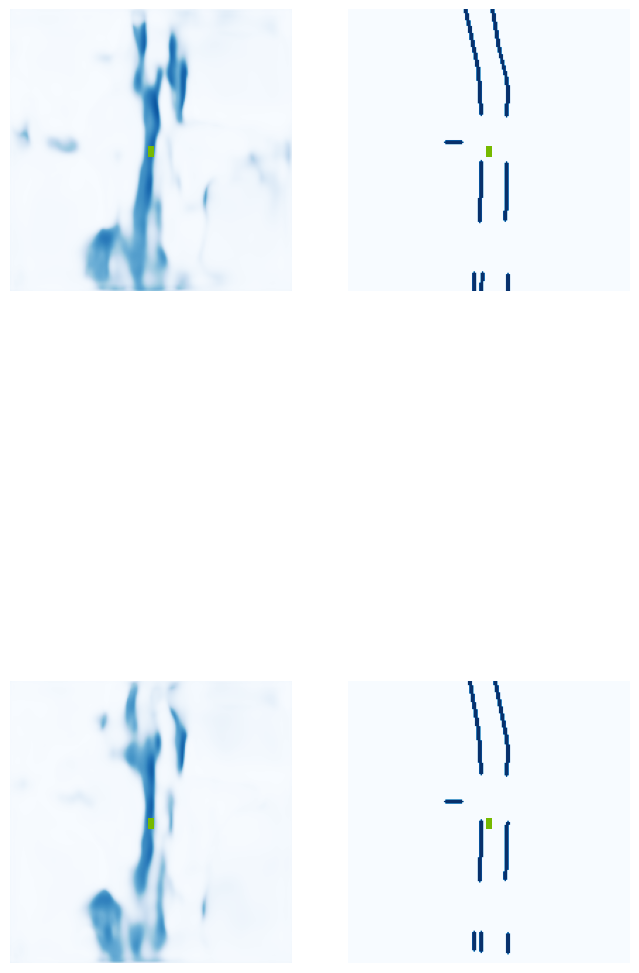

 68%|██████▊   | 27/40 [00:05<00:02,  4.76it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.08.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.22it/s]

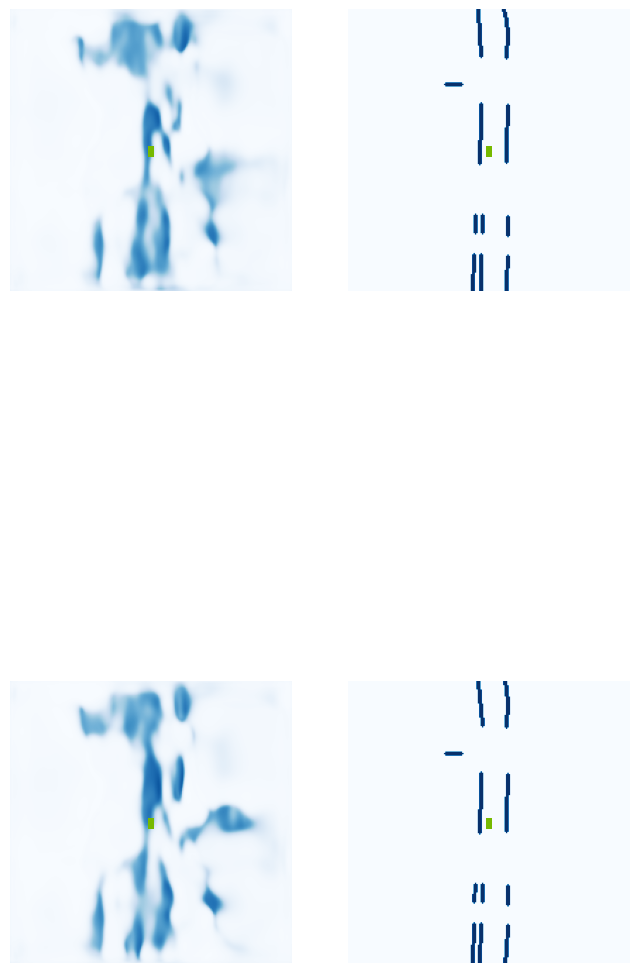

 80%|████████  | 32/40 [00:06<00:01,  5.25it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.07.jpg


 88%|████████▊ | 35/40 [00:06<00:00,  6.33it/s]

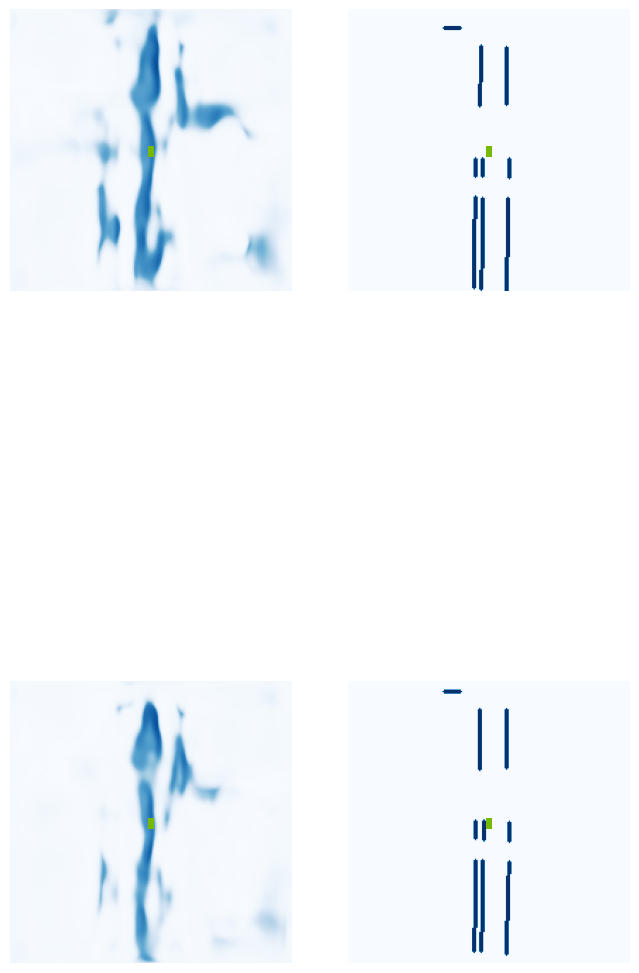

 92%|█████████▎| 37/40 [00:07<00:00,  4.43it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.14.jpg


100%|██████████| 40/40 [00:08<00:00,  4.95it/s]


VAL {'loss': 0.19069821470313603, 'iou': 0.05859063173831261}
saving ...  ./runs/model3000.pt
3010 0.1737486571073532
3020 0.2185467779636383
3030 0.1302240937948227
3040 0.11592812091112137
3050 0.2021382749080658
Epoch: 20/60
3060 0.1292358785867691
3070 0.08746545016765594
3080 0.15271197259426117
3090 0.12802468240261078
3100 0.14519640803337097
3110 0.11780185252428055
3120 0.10406767576932907
3130 0.14911618828773499
3140 0.2920847237110138
3150 0.13472485542297363
3160 0.11573886126279831
3170 0.1531132459640503
3180 0.13554155826568604
3190 0.09290564805269241
3200 0.1514824479818344
3210 0.11749430000782013
3220 0.11499077826738358
Epoch: 21/60
3230 0.14710187911987305
3240 0.1095382571220398
3250 0.2434573918581009
3260 0.16725435853004456
3270 0.08947308361530304
3280 0.23173964023590088
3290 0.12098235636949539
3300 0.10507629066705704
3310 0.12650080025196075
3320 0.14762386679649353
3330 0.12494223564863205
3340 0.16679221391677856
3350 0.13857755064964294
3360 0.12475295

  0%|          | 0/40 [00:00<?, ?it/s]

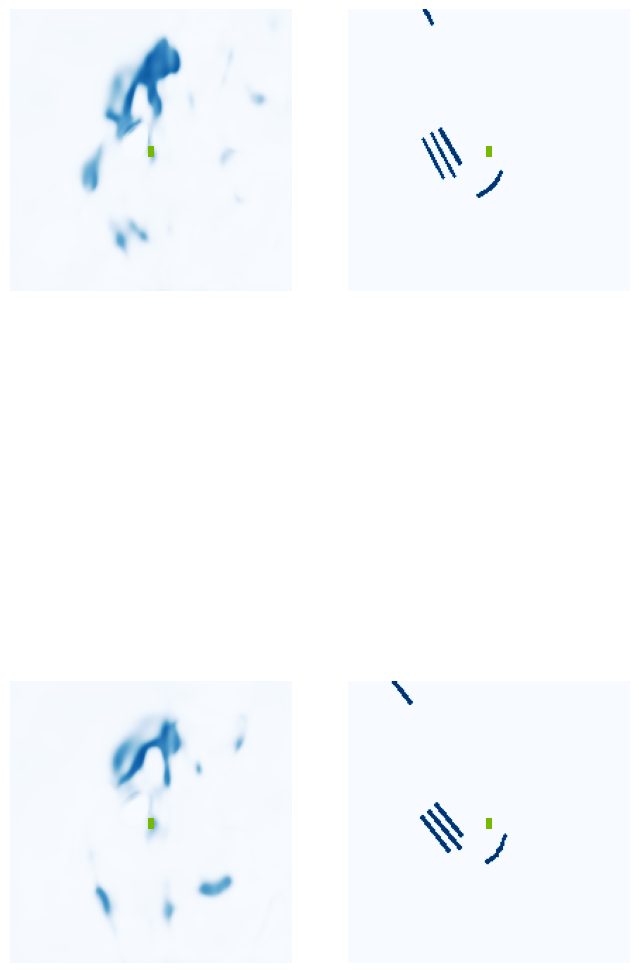

  5%|▌         | 2/40 [00:01<00:24,  1.55it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.50it/s]

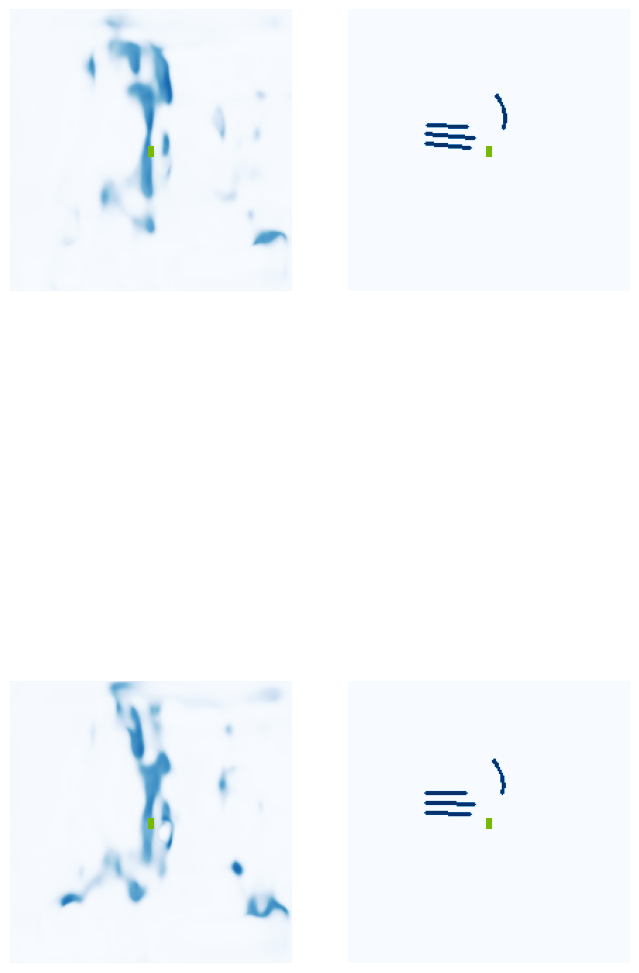

 18%|█▊        | 7/40 [00:02<00:07,  4.46it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.01.jpg


 25%|██▌       | 10/40 [00:02<00:04,  6.89it/s]

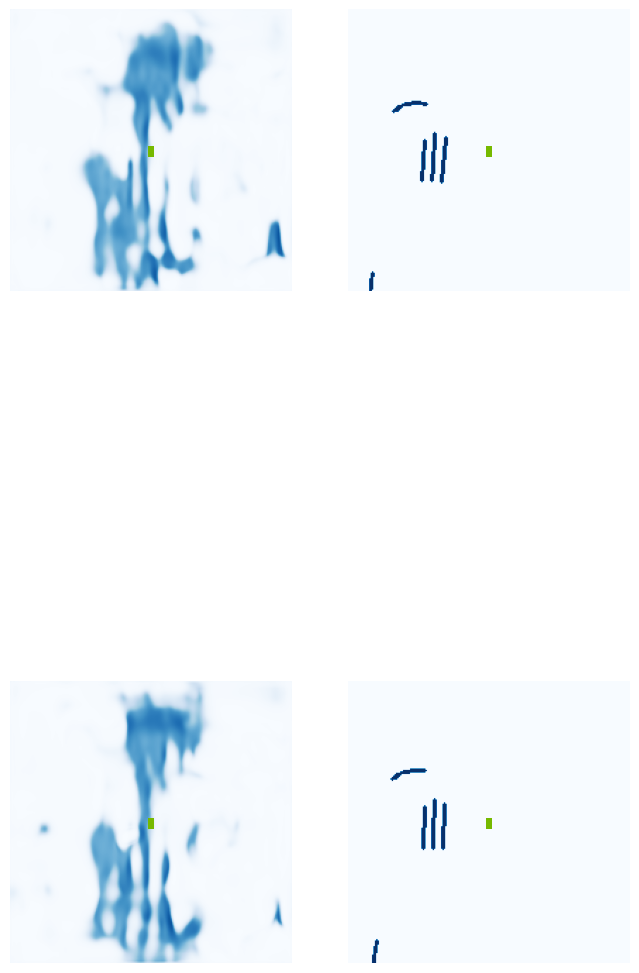

 30%|███       | 12/40 [00:03<00:05,  5.37it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.44it/s]

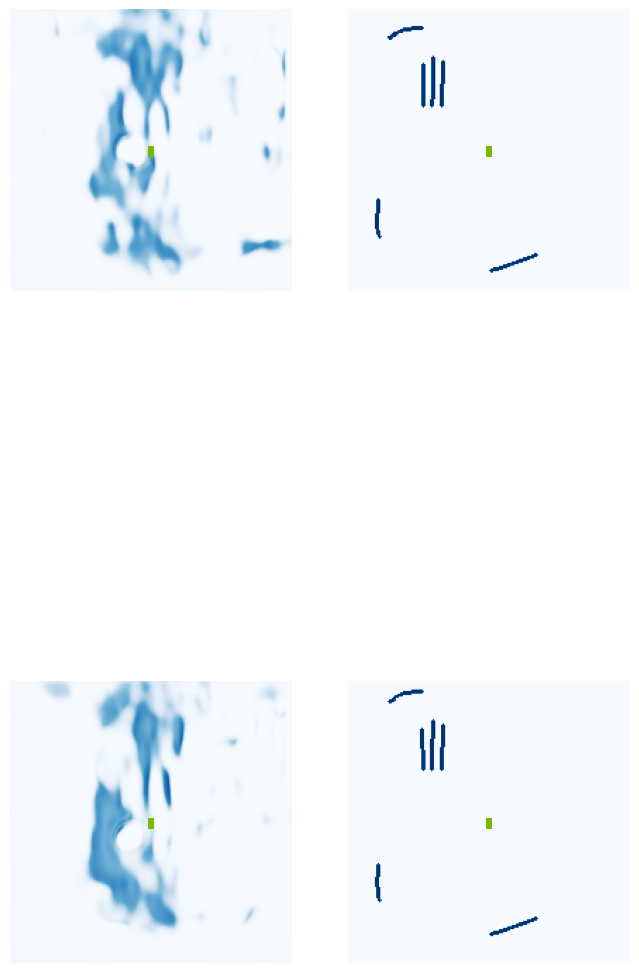

 42%|████▎     | 17/40 [00:04<00:04,  5.36it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.42it/s]

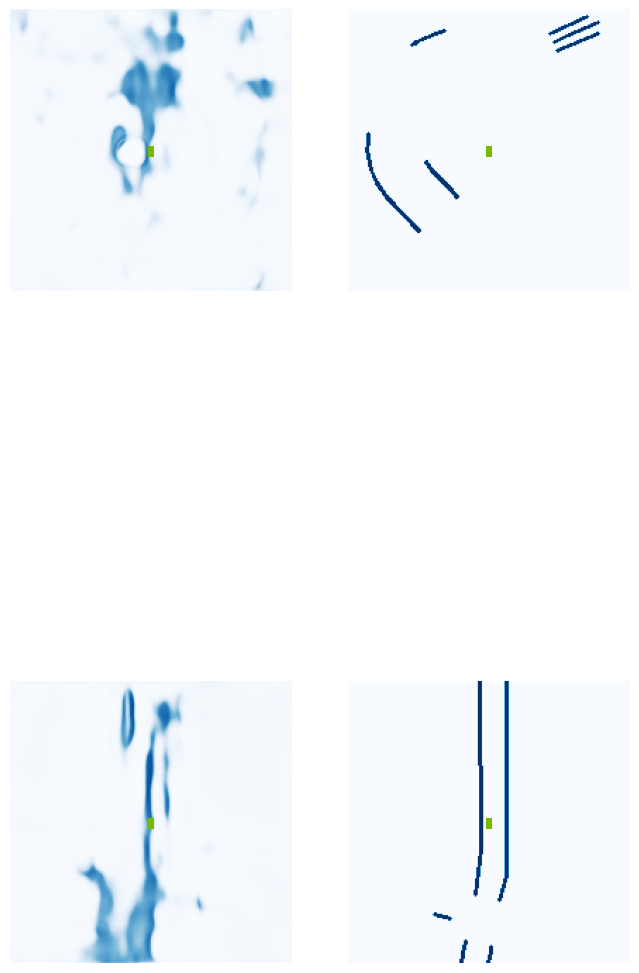

 55%|█████▌    | 22/40 [00:04<00:03,  5.06it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  7.33it/s]

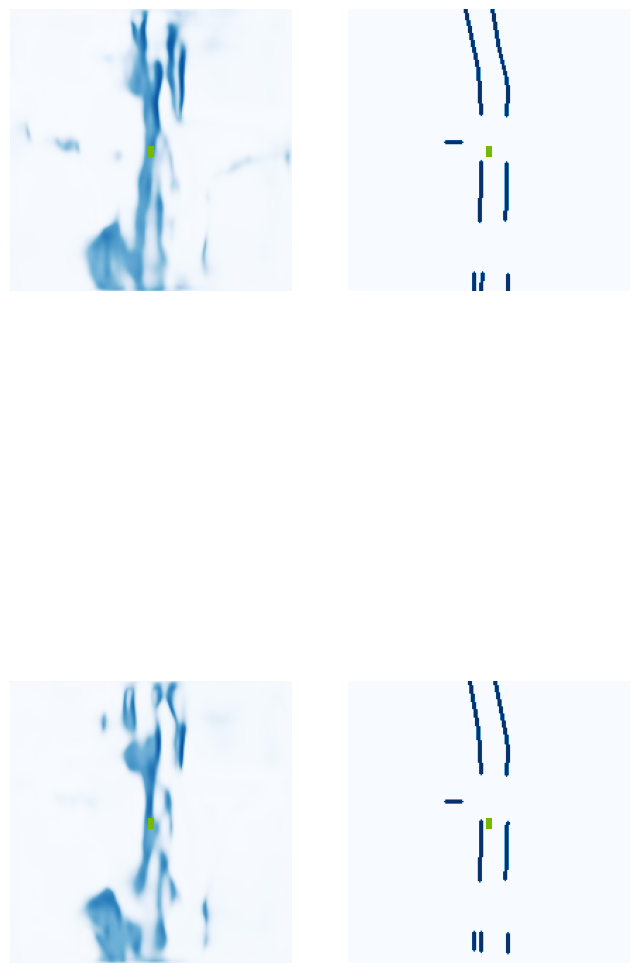

 68%|██████▊   | 27/40 [00:05<00:02,  4.95it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.07.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.85it/s]

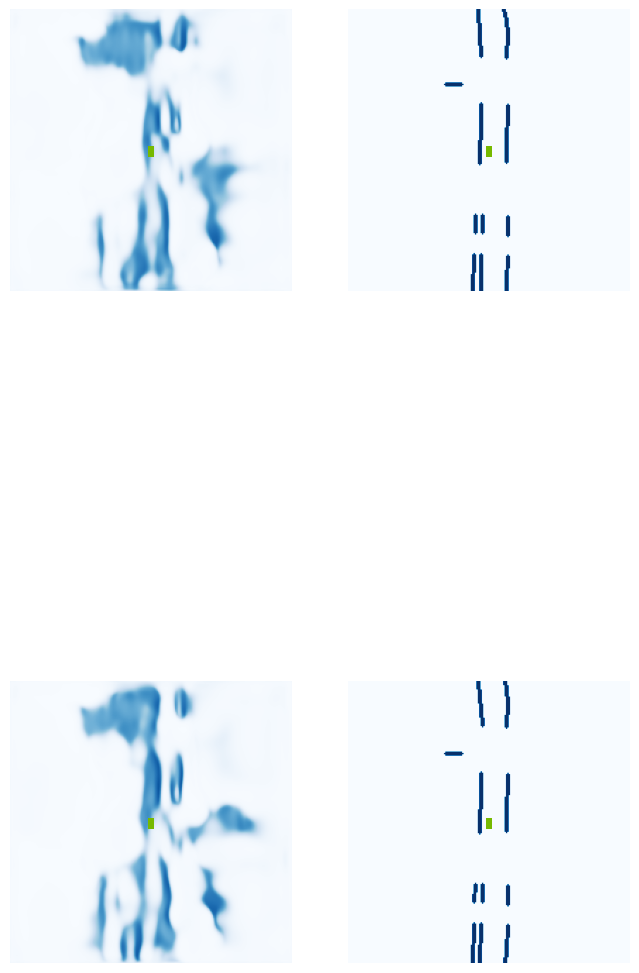

 80%|████████  | 32/40 [00:06<00:01,  4.69it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.08.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.64it/s]

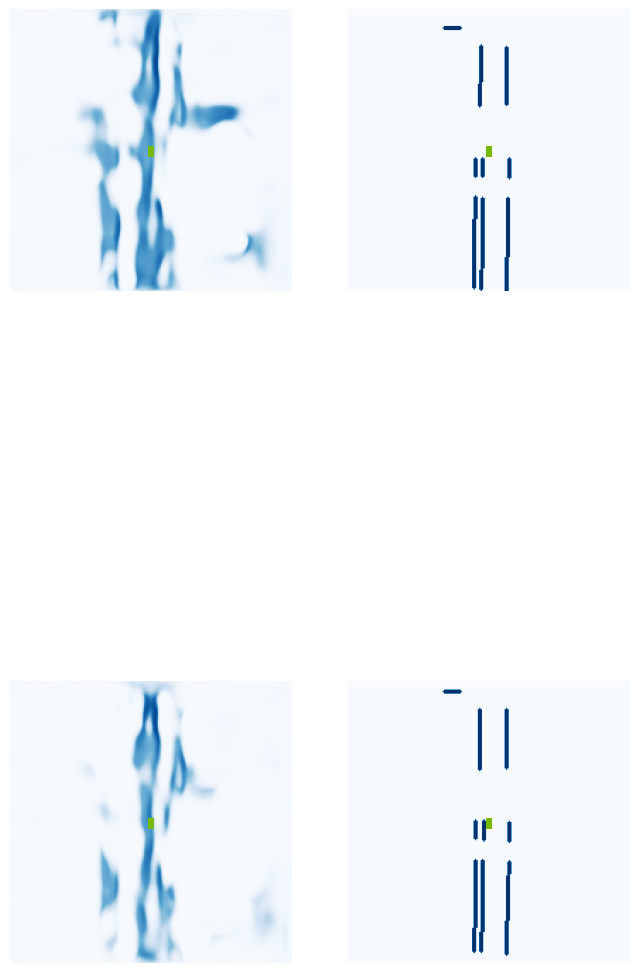

 92%|█████████▎| 37/40 [00:07<00:00,  4.97it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.11.jpg


100%|██████████| 40/40 [00:08<00:00,  4.90it/s]


VAL {'loss': 0.20010872571556657, 'iou': 0.05121976977505544}
saving ...  ./runs/model3500.pt
3510 0.07984814792871475
3520 0.09575376659631729
3530 0.12077467888593674
3540 0.10768072307109833
Epoch: 23/60
3550 0.0994647964835167
3560 0.13210737705230713
3570 0.16948974132537842
3580 0.12649191915988922
3590 0.0990028902888298
3600 0.10213642567396164
3610 0.10969654470682144
3620 0.14444592595100403
3630 0.11095336824655533
3640 0.11953208595514297
3650 0.12927716970443726
3660 0.1135152280330658
3670 0.10022538155317307
3680 0.0899219885468483
3690 0.10491889715194702
3700 0.17539381980895996
Epoch: 24/60
3710 0.11566948145627975
3720 0.07562314718961716
3730 0.15418000519275665
3740 0.11495903134346008
3750 0.11584992706775665
3760 0.14282913506031036
3770 0.10208289325237274
3780 0.13603898882865906
3790 0.09490658342838287
3800 0.09230180084705353
3810 0.11571510881185532
3820 0.11710811406373978
3830 0.14608536660671234
3840 0.11040634661912918
3850 0.1526692658662796
3860 0.092

  0%|          | 0/40 [00:00<?, ?it/s]

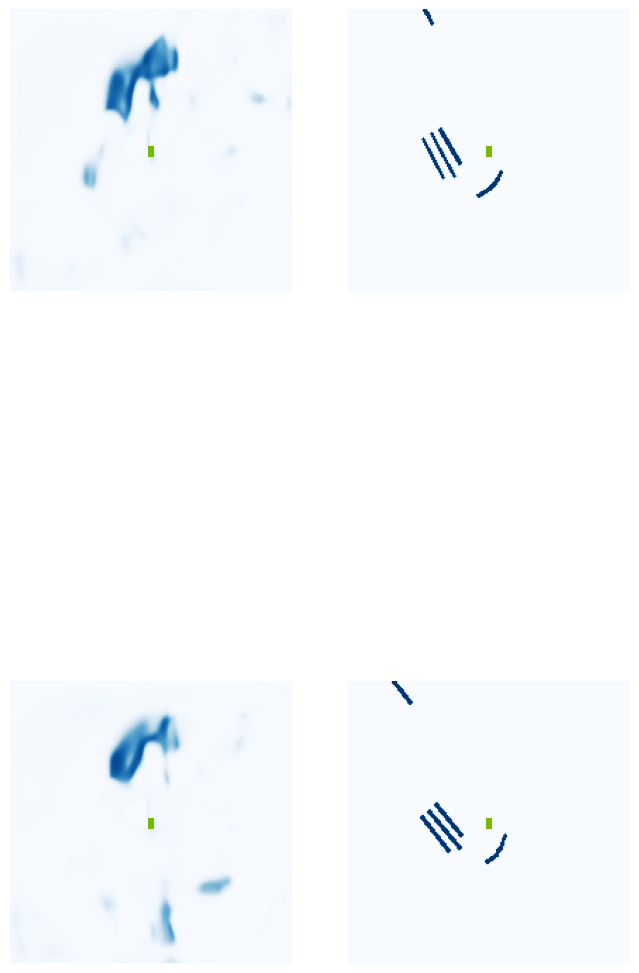

  5%|▌         | 2/40 [00:01<00:18,  2.07it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.40it/s]

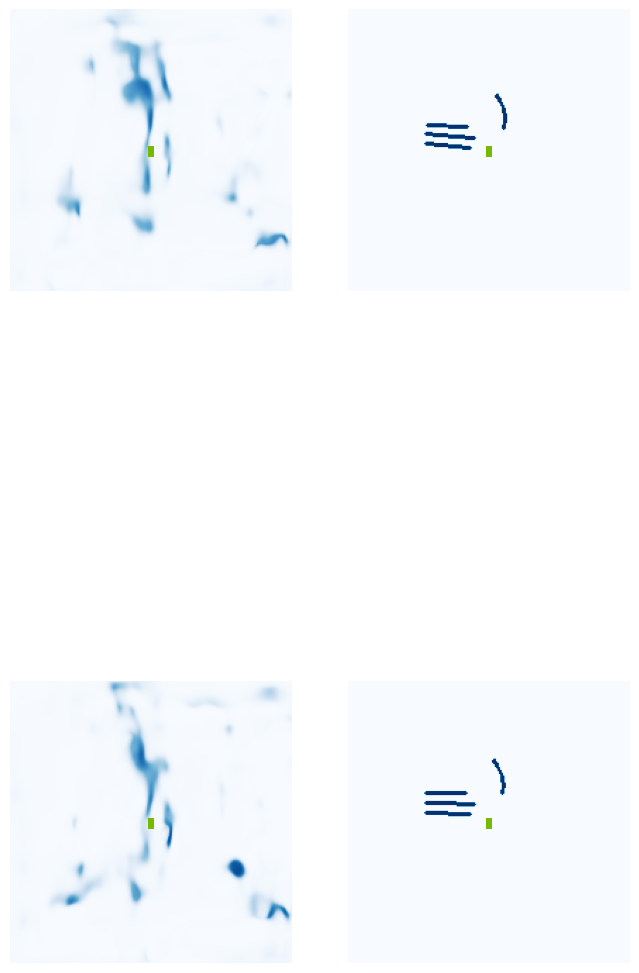

 18%|█▊        | 7/40 [00:01<00:07,  4.70it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.30it/s]

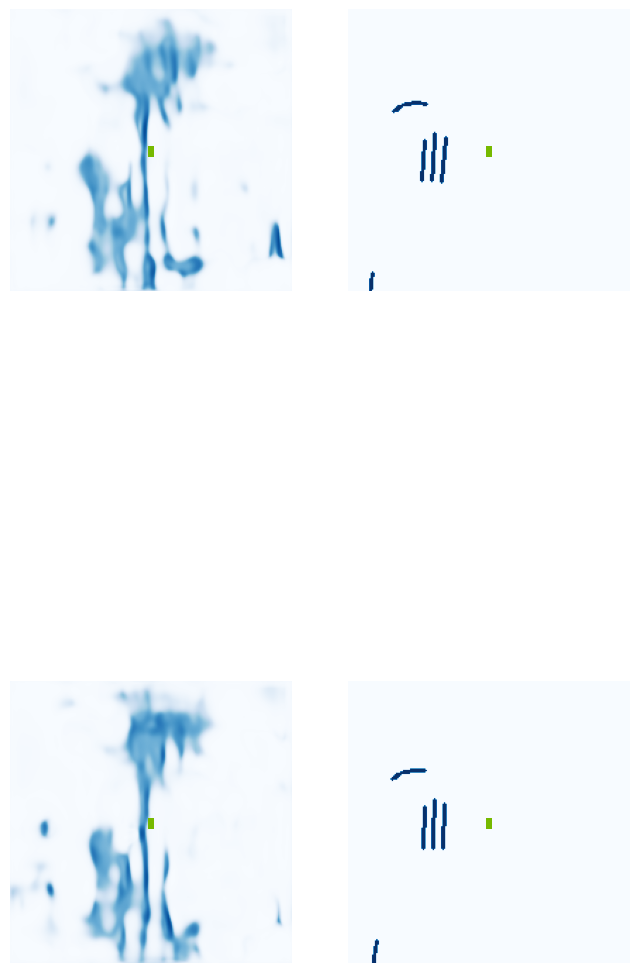

 30%|███       | 12/40 [00:02<00:05,  4.90it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.02.jpg


 35%|███▌      | 14/40 [00:03<00:04,  6.35it/s]

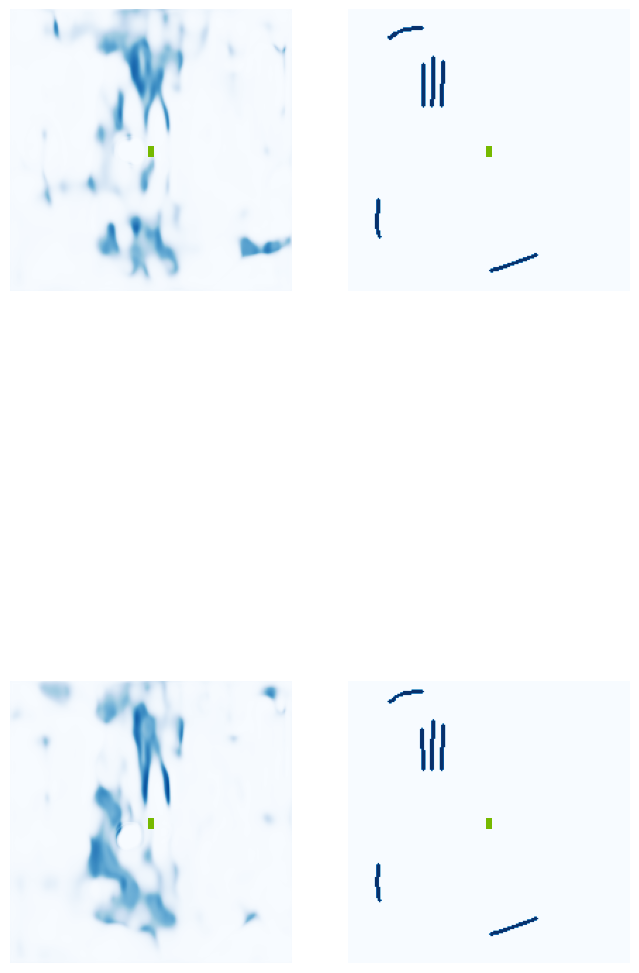

 45%|████▌     | 18/40 [00:04<00:04,  4.72it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.90it/s]

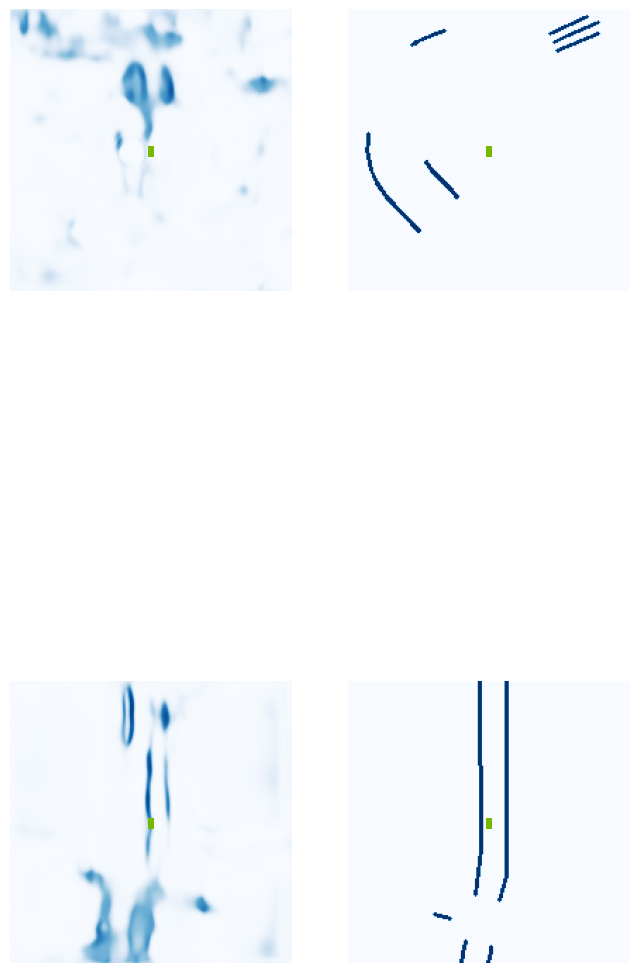

 55%|█████▌    | 22/40 [00:04<00:03,  4.94it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  7.05it/s]

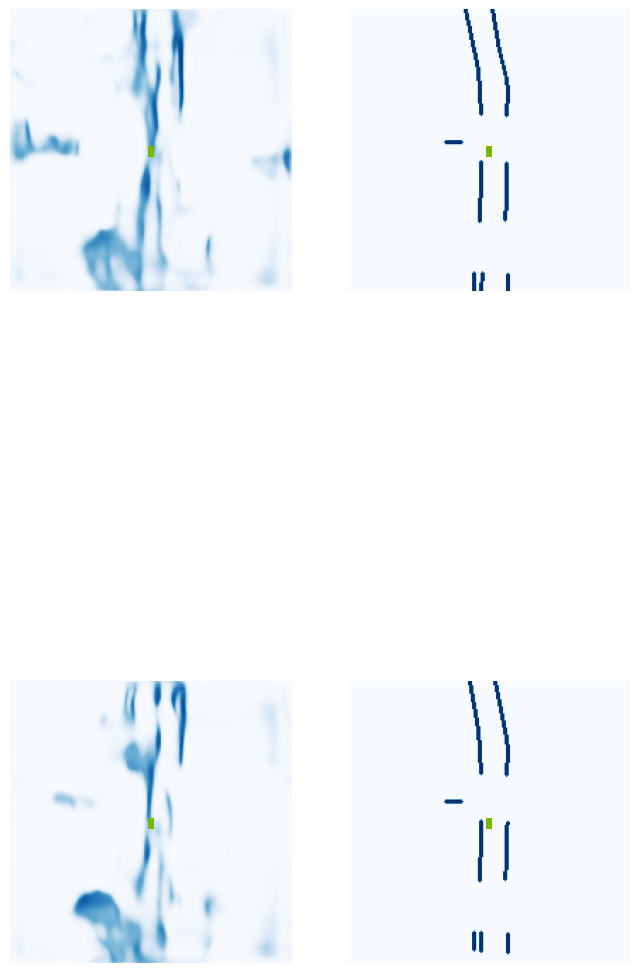

 68%|██████▊   | 27/40 [00:05<00:02,  5.41it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.05.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.64it/s]

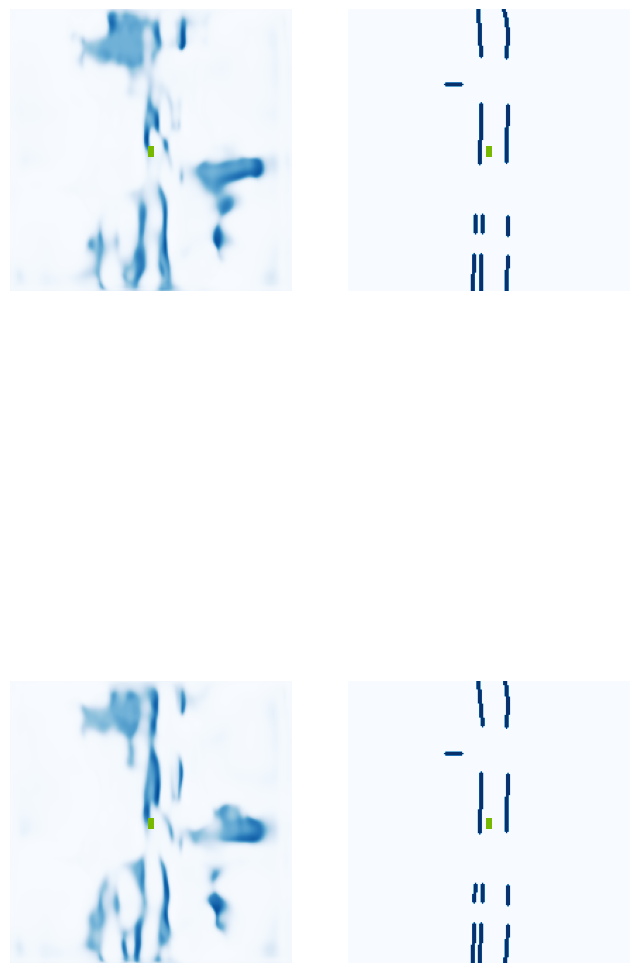

 80%|████████  | 32/40 [00:06<00:01,  4.95it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.21it/s]

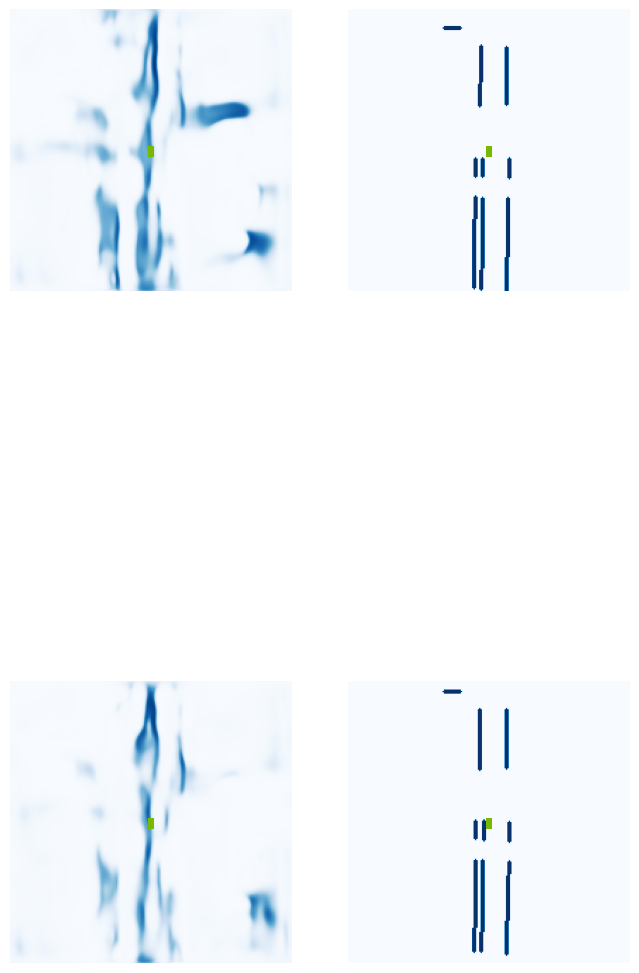

 92%|█████████▎| 37/40 [00:07<00:00,  4.61it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.09.jpg


100%|██████████| 40/40 [00:08<00:00,  4.95it/s]


VAL {'loss': 0.19544360961443114, 'iou': 0.037663242207905276}
saving ...  ./runs/model4000.pt
4010 0.07487253099679947
4020 0.11715036630630493
Epoch: 26/60
4030 0.07136042416095734
4040 0.08418155461549759
4050 0.091262087225914
4060 0.1079663410782814
4070 0.07560630887746811
4080 0.10324152559041977
4090 0.09885112941265106
4100 0.17421582341194153
4110 0.08348401635885239
4120 0.10489877313375473
4130 0.13528434932231903
4140 0.11746850609779358
4150 0.11454655230045319
4160 0.08341333270072937
4170 0.0847652405500412
4180 0.08609798550605774
Epoch: 27/60
4190 0.10012777894735336
4200 0.15971806645393372
4210 0.09042184799909592
4220 0.14555032551288605
4230 0.049508366733789444
4240 0.11793696135282516
4250 0.08580241352319717
4260 0.05732515826821327
4270 0.14009830355644226
4280 0.07298598438501358
4290 0.0946260318160057
4300 0.04344189912080765
4310 0.09892009198665619
4320 0.06730342656373978
4330 0.13242216408252716
4340 0.060746148228645325
Epoch: 28/60
4350 0.121006906032

  0%|          | 0/40 [00:00<?, ?it/s]

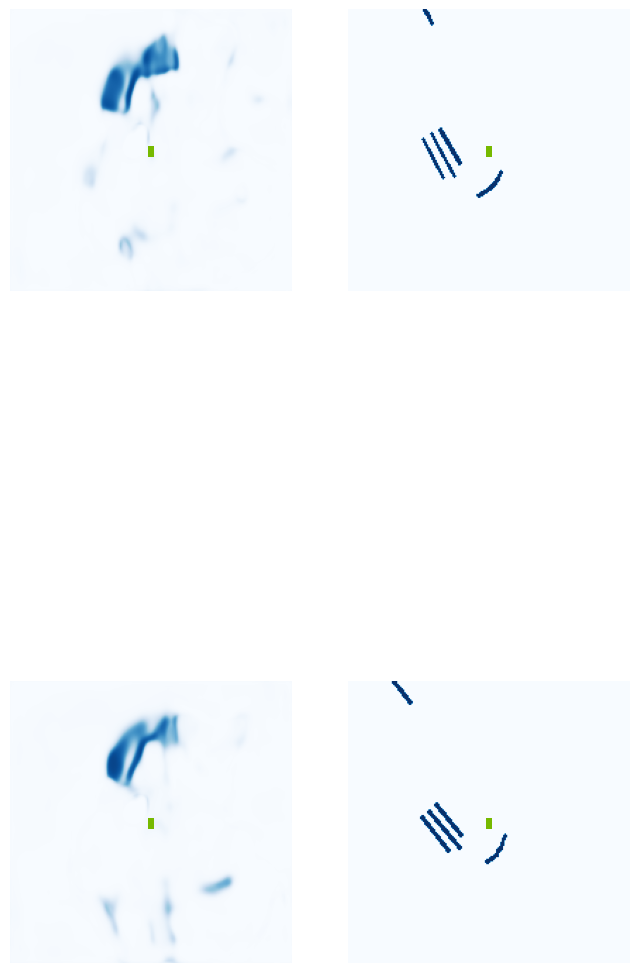

  5%|▌         | 2/40 [00:01<00:18,  2.05it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.36it/s]

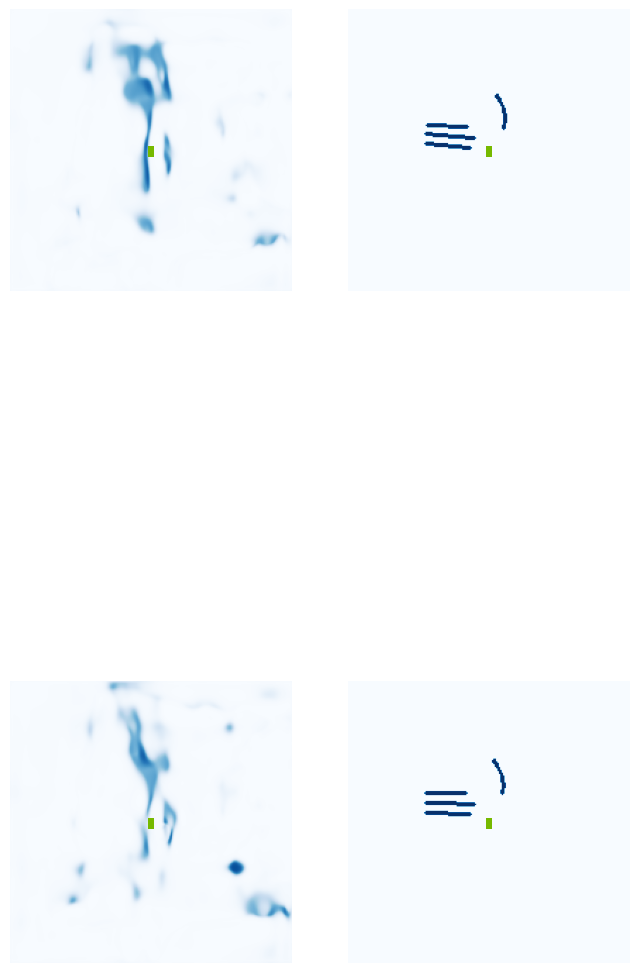

 18%|█▊        | 7/40 [00:01<00:07,  4.68it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.18it/s]

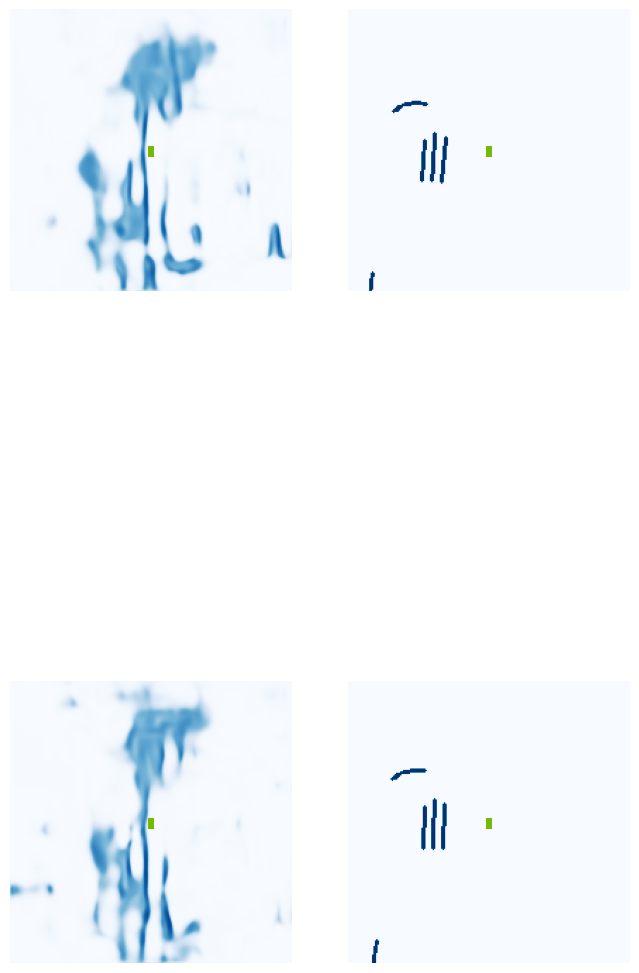

 30%|███       | 12/40 [00:02<00:05,  4.92it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.02.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.86it/s]

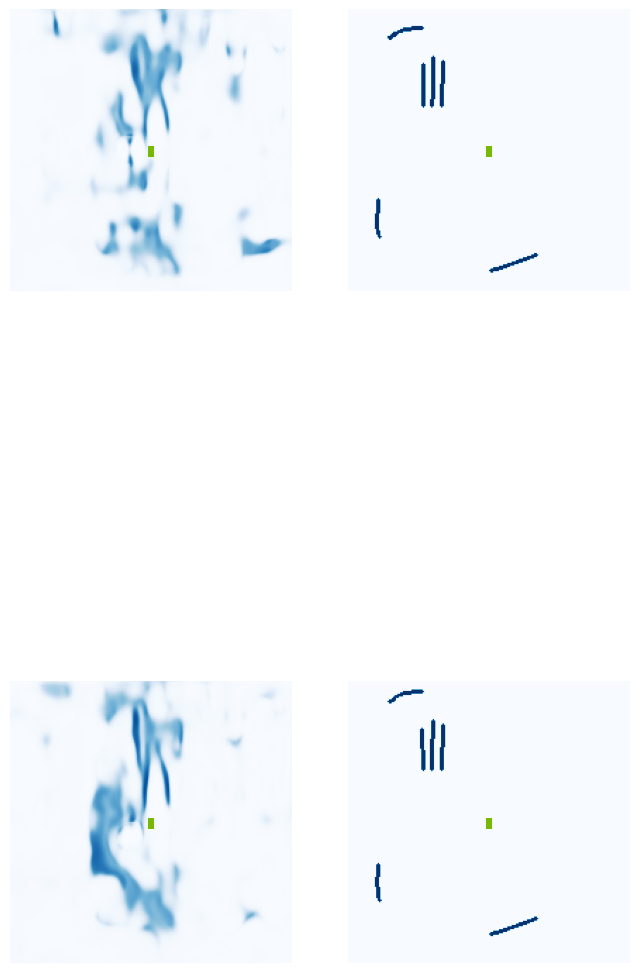

 42%|████▎     | 17/40 [00:03<00:04,  5.32it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 48%|████▊     | 19/40 [00:04<00:03,  5.94it/s]

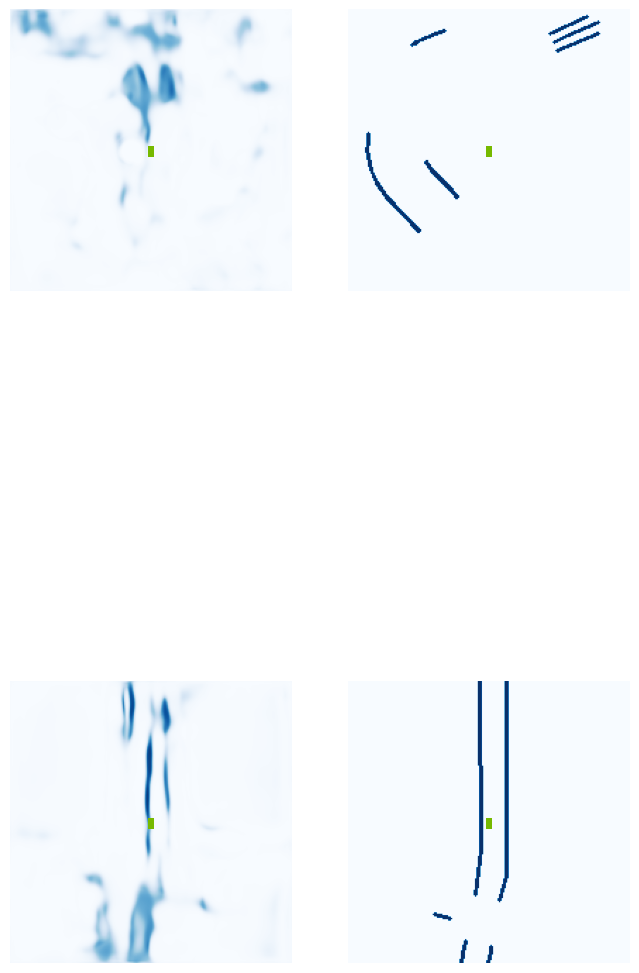

 55%|█████▌    | 22/40 [00:04<00:03,  4.86it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.03.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.52it/s]

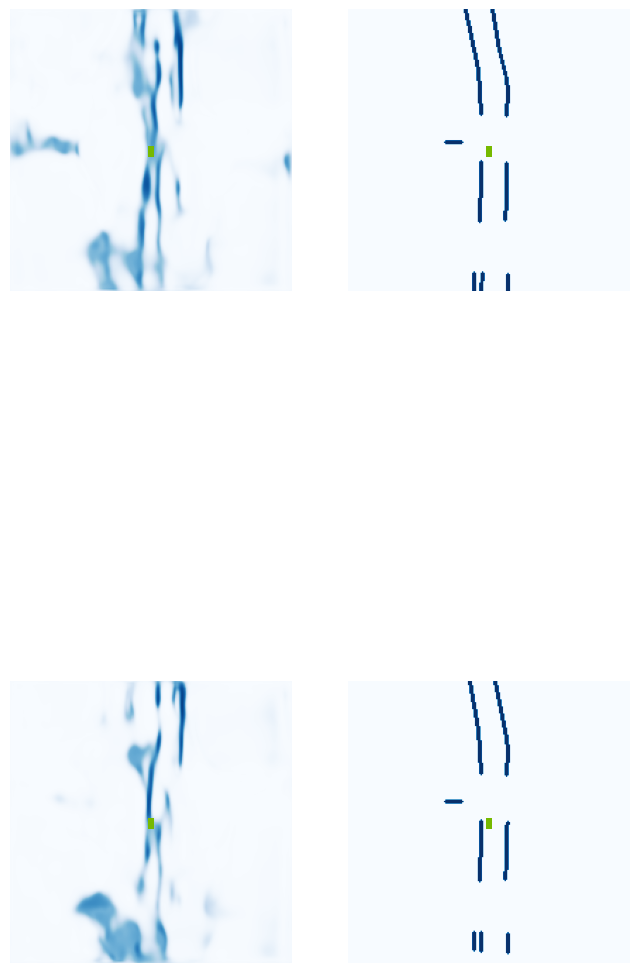

 68%|██████▊   | 27/40 [00:05<00:02,  5.22it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:05<00:01,  6.98it/s]

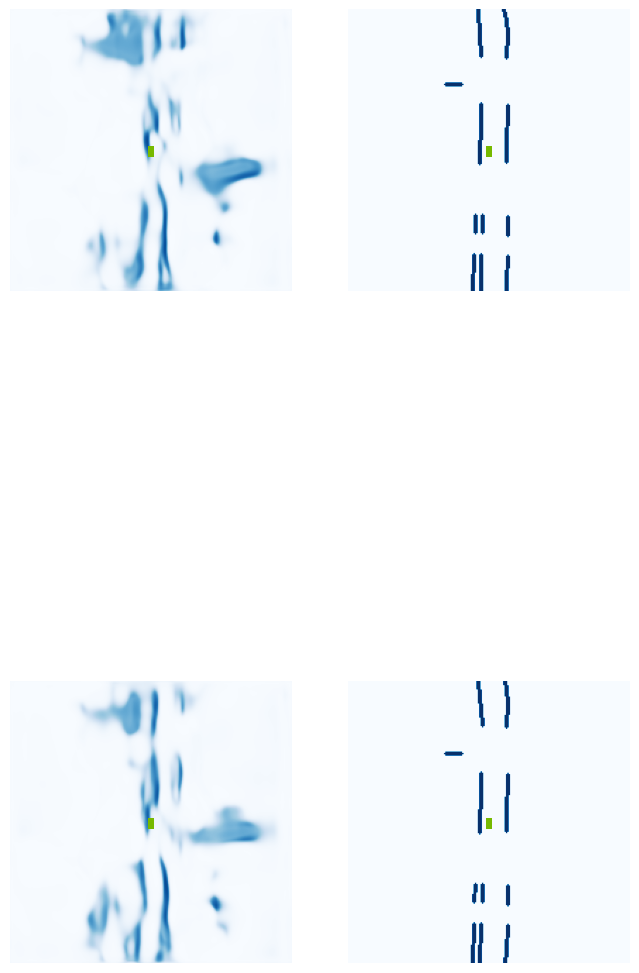

 80%|████████  | 32/40 [00:06<00:01,  4.65it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg


 88%|████████▊ | 35/40 [00:06<00:00,  6.54it/s]

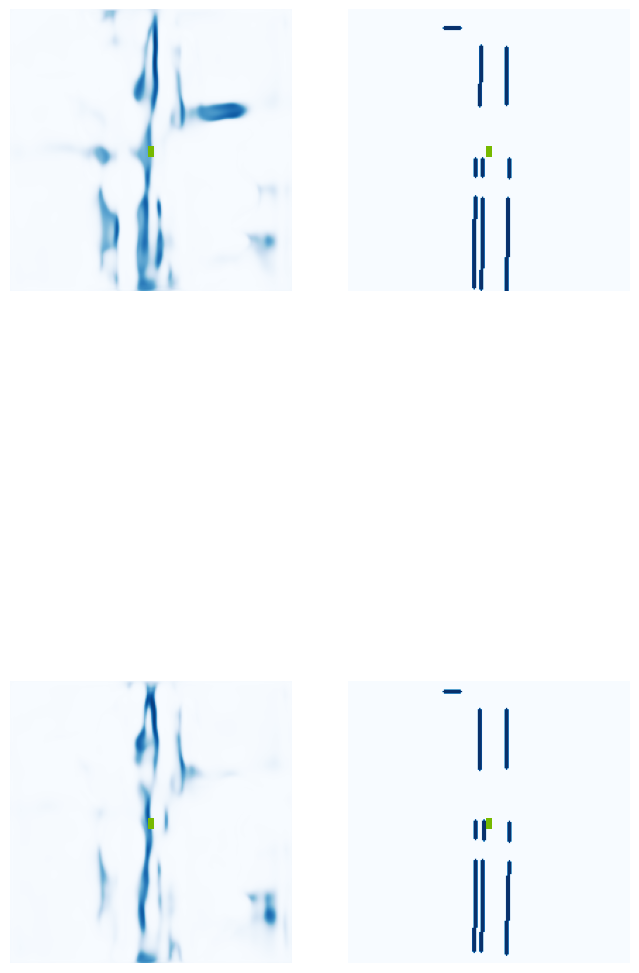

 92%|█████████▎| 37/40 [00:07<00:00,  5.31it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.12.jpg


100%|██████████| 40/40 [00:07<00:00,  5.08it/s]


VAL {'loss': 0.19319347798088451, 'iou': 0.0433132843712173}
saving ...  ./runs/model4500.pt
Epoch: 29/60
4510 0.16437548398971558
4520 0.12916401028633118
4530 0.09904356300830841
4540 0.0952703058719635
4550 0.13494530320167542
4560 0.06952491402626038
4570 0.06361217796802521
4580 0.17924506962299347
4590 0.07159716635942459
4600 0.10209529101848602
4610 0.073197141289711
4620 0.10259176045656204
4630 0.09160381555557251
4640 0.08330275863409042
4650 0.10490037500858307
4660 0.12408759444952011
Epoch: 30/60
4670 0.08660145103931427
4680 0.12002138048410416
4690 0.11612057685852051
4700 0.06986195594072342
4710 0.07873785495758057
4720 0.08973974734544754
4730 0.08337129652500153
4740 0.11345014721155167
4750 0.12352985888719559
4760 0.09130702912807465
4770 0.09729523956775665
4780 0.06111202389001846
4790 0.07960470765829086
4800 0.11358720064163208
4810 0.04692941531538963
4820 0.12472014129161835
4830 0.1528814136981964
Epoch: 31/60
4840 0.06934100389480591
4850 0.088454574346542

  0%|          | 0/40 [00:00<?, ?it/s]

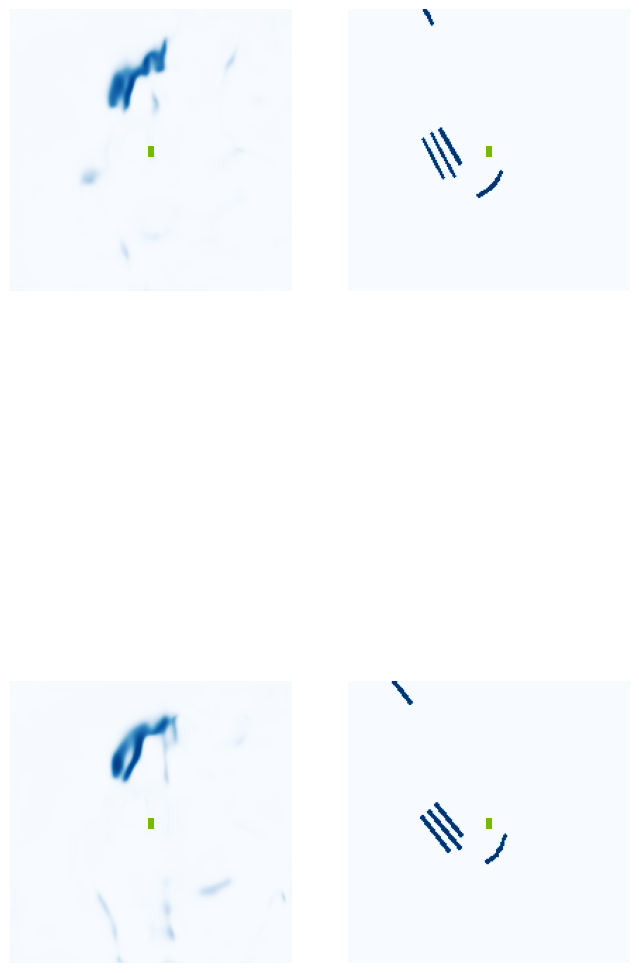

  5%|▌         | 2/40 [00:01<00:18,  2.00it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.19it/s]

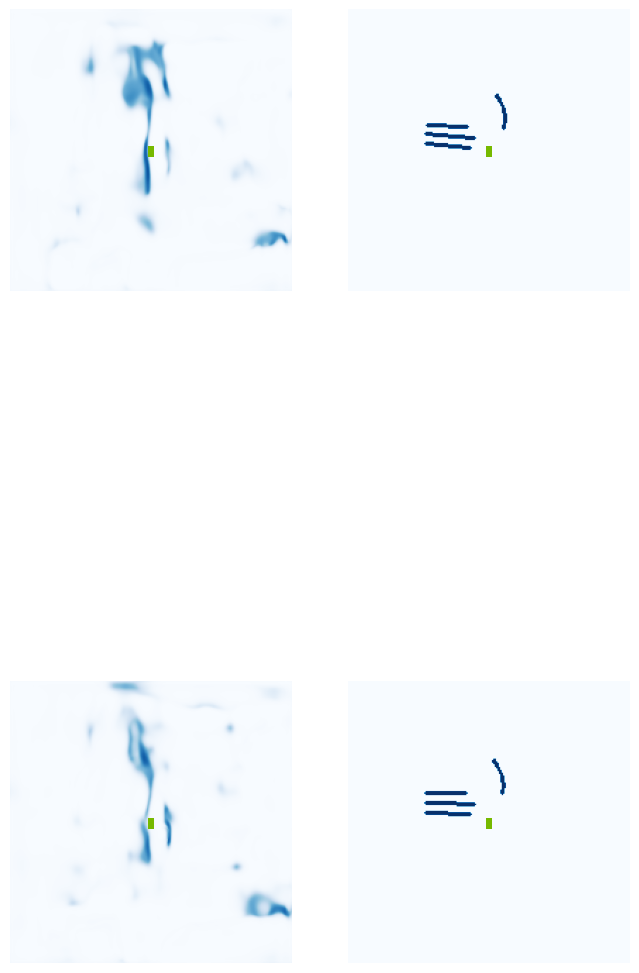

 18%|█▊        | 7/40 [00:01<00:06,  4.82it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.24it/s]

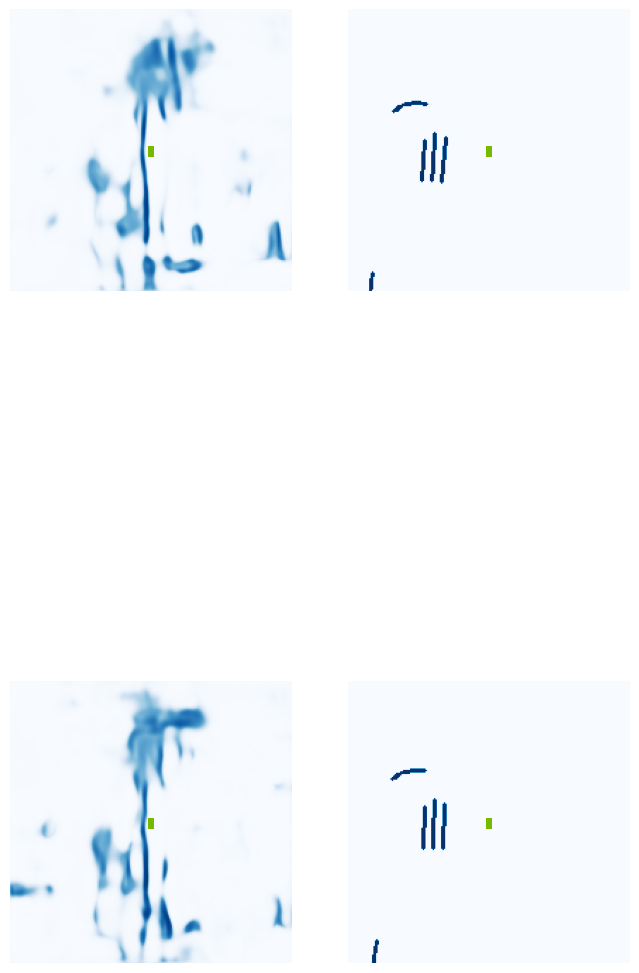

 30%|███       | 12/40 [00:02<00:05,  5.10it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.02.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.57it/s]

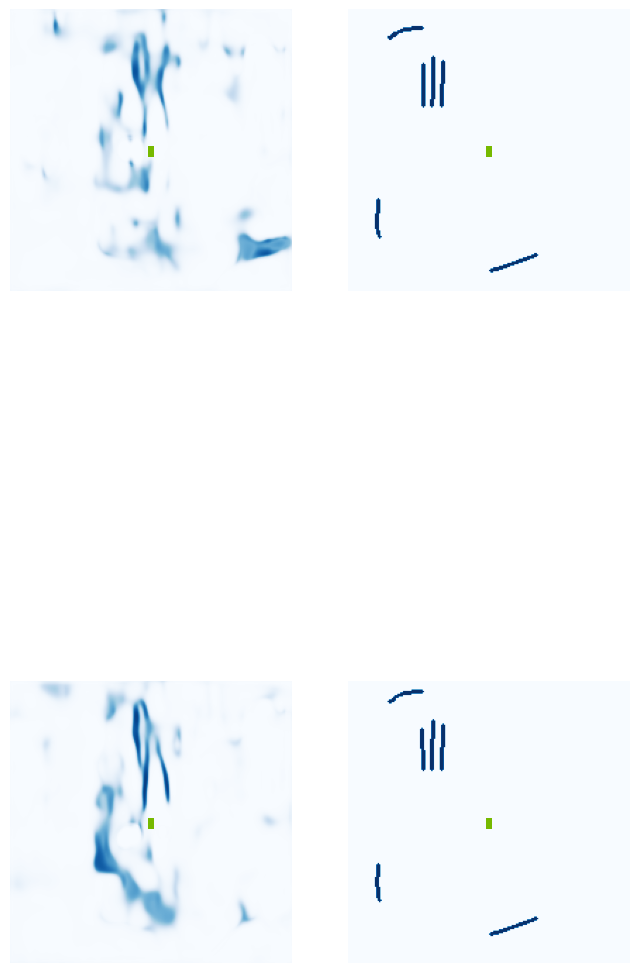

 42%|████▎     | 17/40 [00:03<00:04,  5.38it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.41it/s]

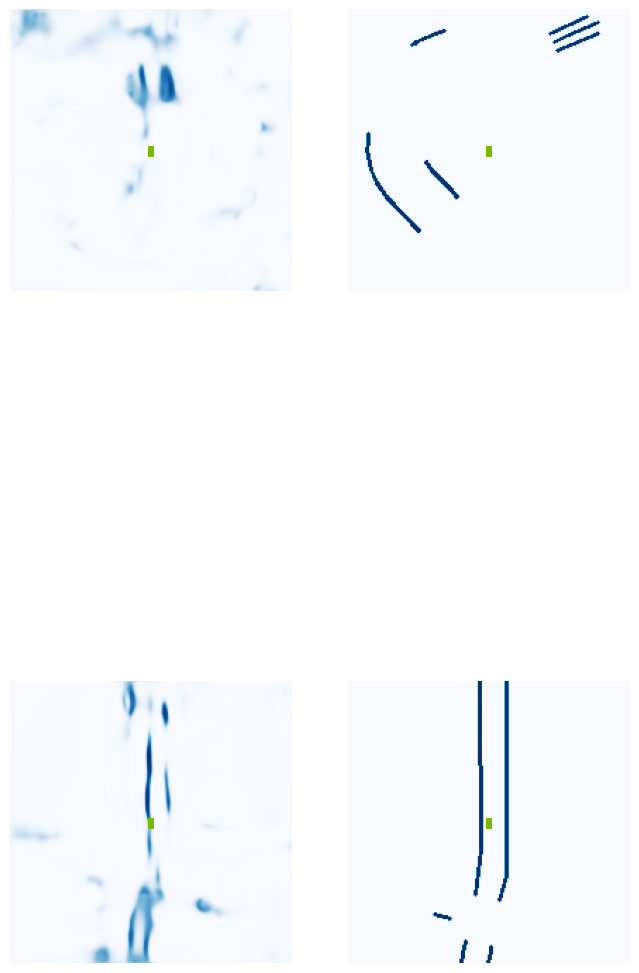

 52%|█████▎    | 21/40 [00:04<00:05,  3.67it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.30it/s]

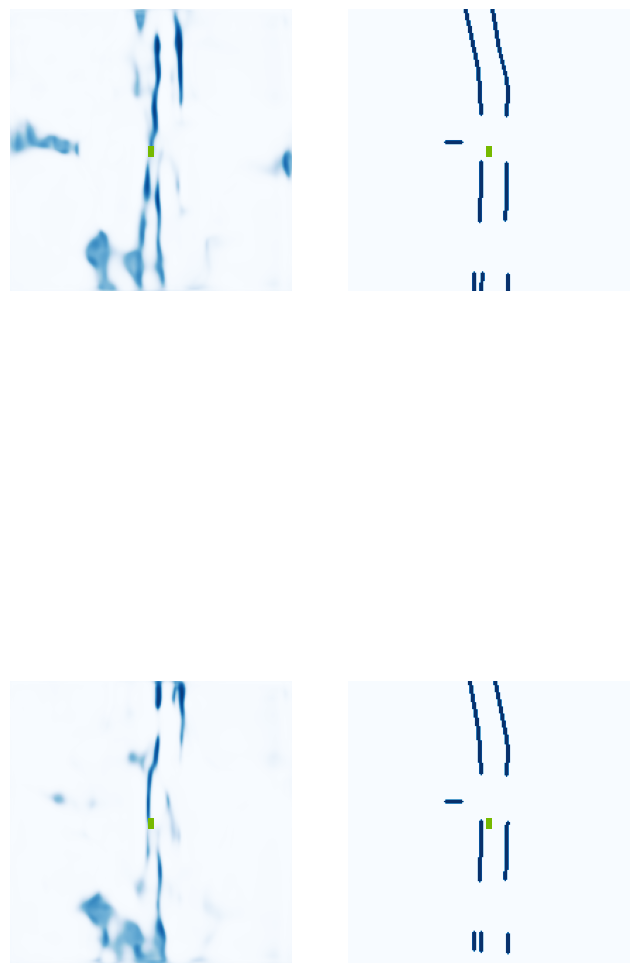

 68%|██████▊   | 27/40 [00:05<00:02,  5.13it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:05<00:01,  7.06it/s]

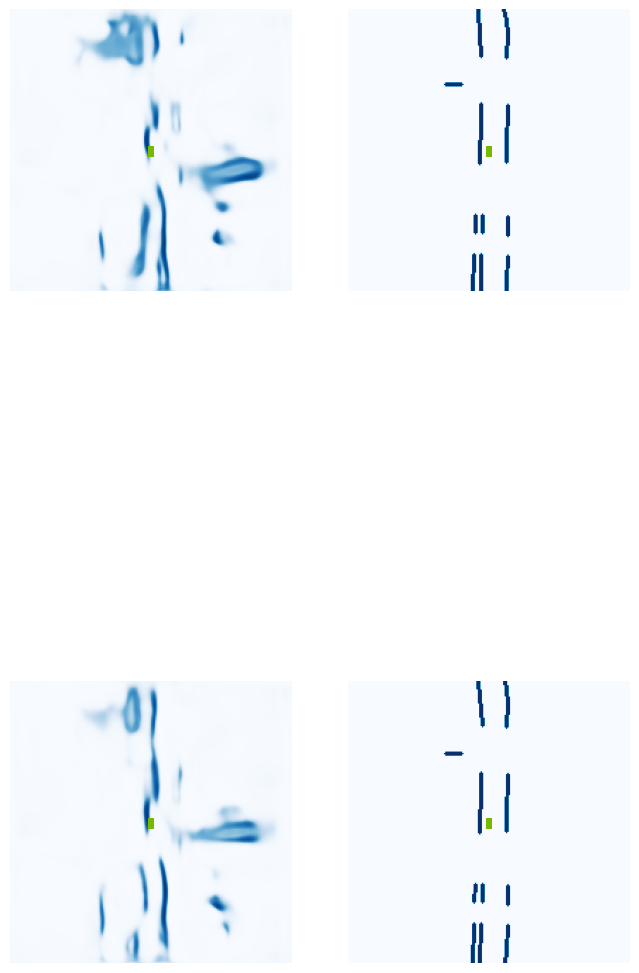

 80%|████████  | 32/40 [00:06<00:01,  4.62it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.06.jpg


 88%|████████▊ | 35/40 [00:06<00:00,  6.12it/s]

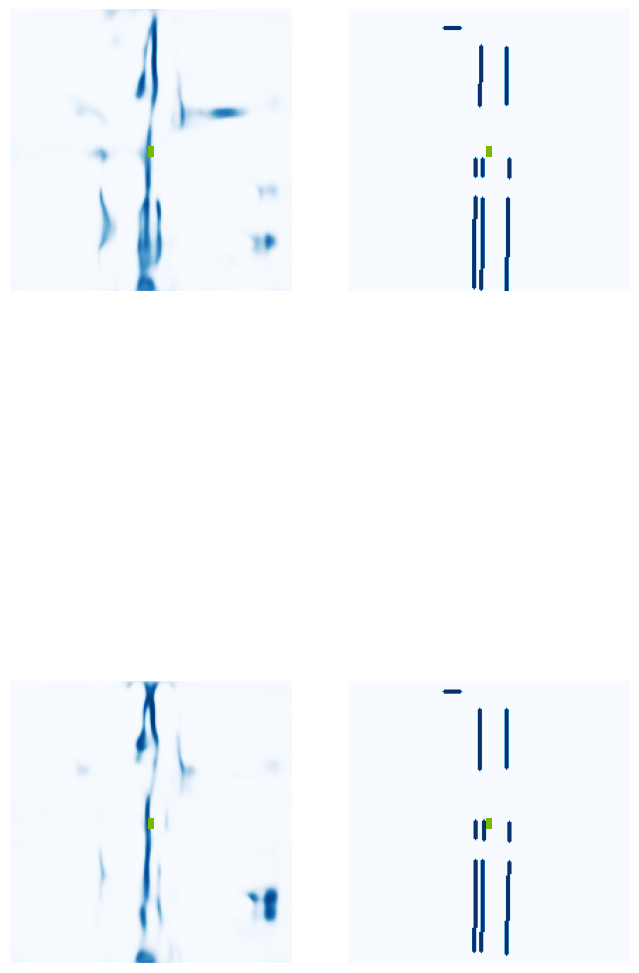

 92%|█████████▎| 37/40 [00:07<00:00,  5.21it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.11.jpg


100%|██████████| 40/40 [00:07<00:00,  5.03it/s]


VAL {'loss': 0.20509107539683213, 'iou': 0.037458449651557243}
saving ...  ./runs/model5000.pt
5010 0.09552107751369476
5020 0.0687388926744461
5030 0.09268645197153091
5040 0.10296393930912018
5050 0.07572147250175476
5060 0.09976577013731003
5070 0.07250480353832245
5080 0.06425046920776367
5090 0.07391723245382309
5100 0.07852842658758163
5110 0.0620383657515049
5120 0.07321343570947647
5130 0.05887819826602936
5140 0.09293472766876221
5150 0.05103077366948128
Epoch: 33/60
5160 0.10340629518032074
5170 0.13516804575920105
5180 0.10432137548923492
5190 0.07559697329998016
5200 0.08253317326307297
5210 0.06029600650072098
5220 0.09233823418617249
5230 0.060420647263526917
5240 0.08208759874105453
5250 0.0859045758843422
5260 0.050795115530490875
5270 0.10798662155866623
5280 0.05759431794285774
5290 0.12494350224733353
5300 0.07213324308395386
5310 0.06342481821775436
Epoch: 34/60
5320 0.03287206217646599
5330 0.0736270323395729
5340 0.05074732005596161
5350 0.07841257750988007
5360 0

  0%|          | 0/40 [00:00<?, ?it/s]

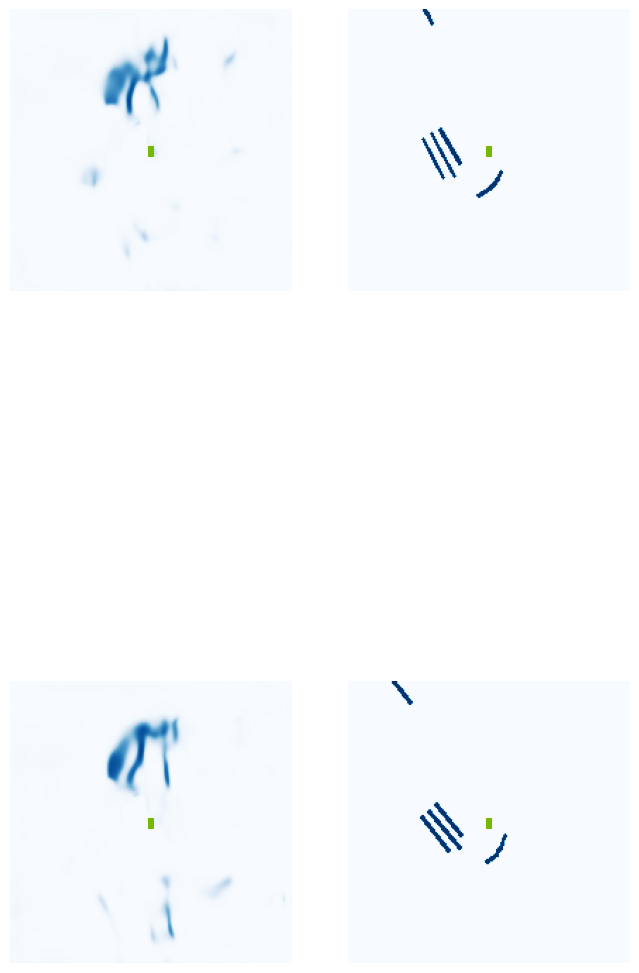

  5%|▌         | 2/40 [00:01<00:19,  1.91it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.09it/s]

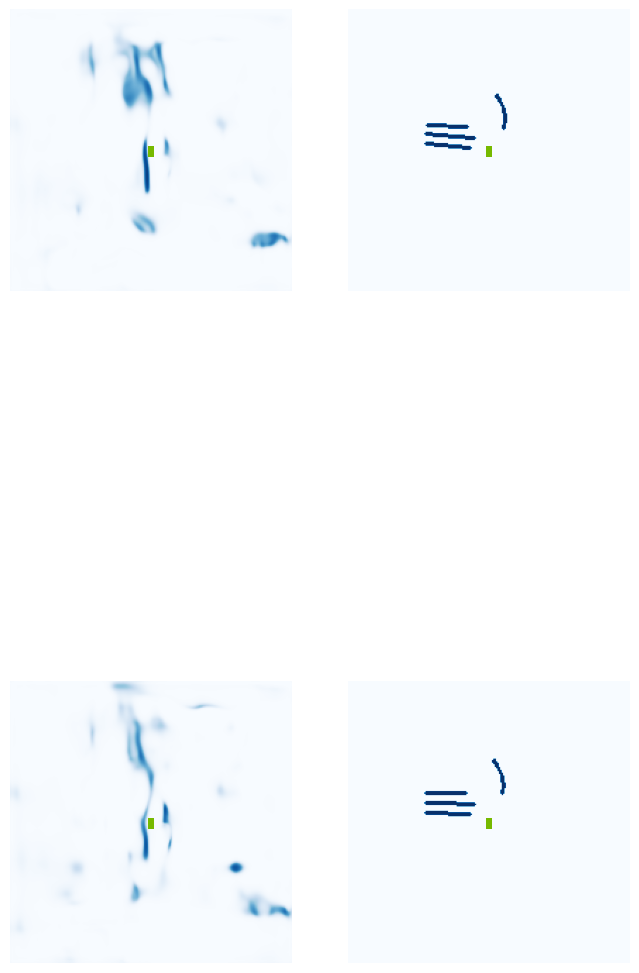

 18%|█▊        | 7/40 [00:02<00:07,  4.47it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  6.68it/s]

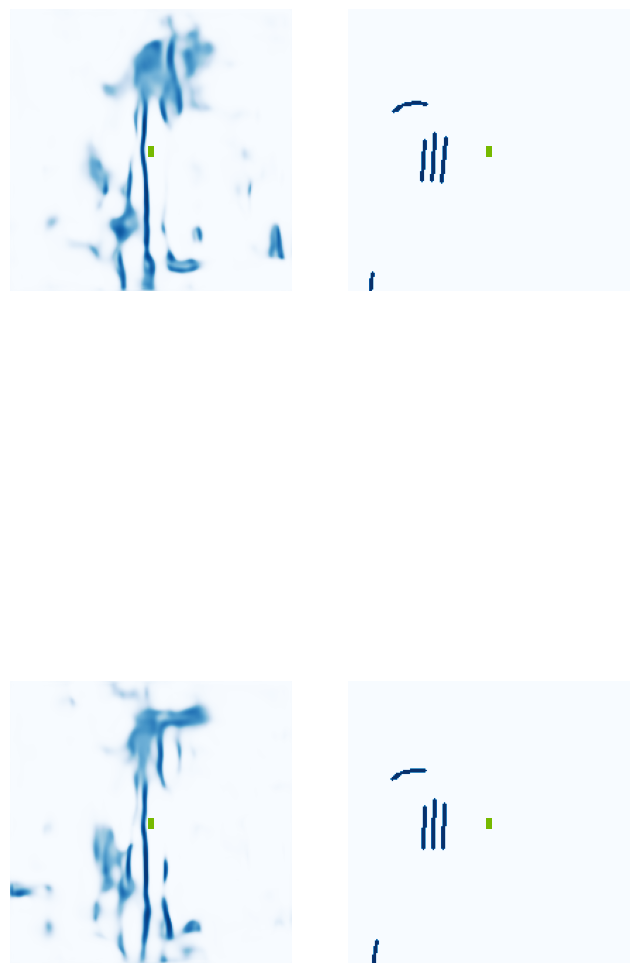

 30%|███       | 12/40 [00:03<00:05,  4.80it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.05it/s]

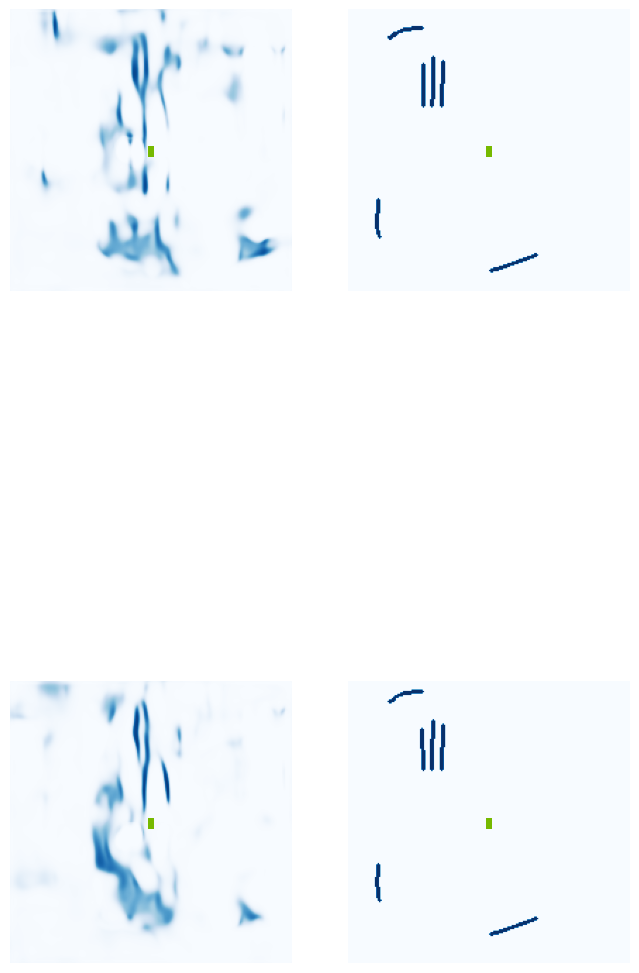

 42%|████▎     | 17/40 [00:03<00:04,  5.28it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.51it/s]

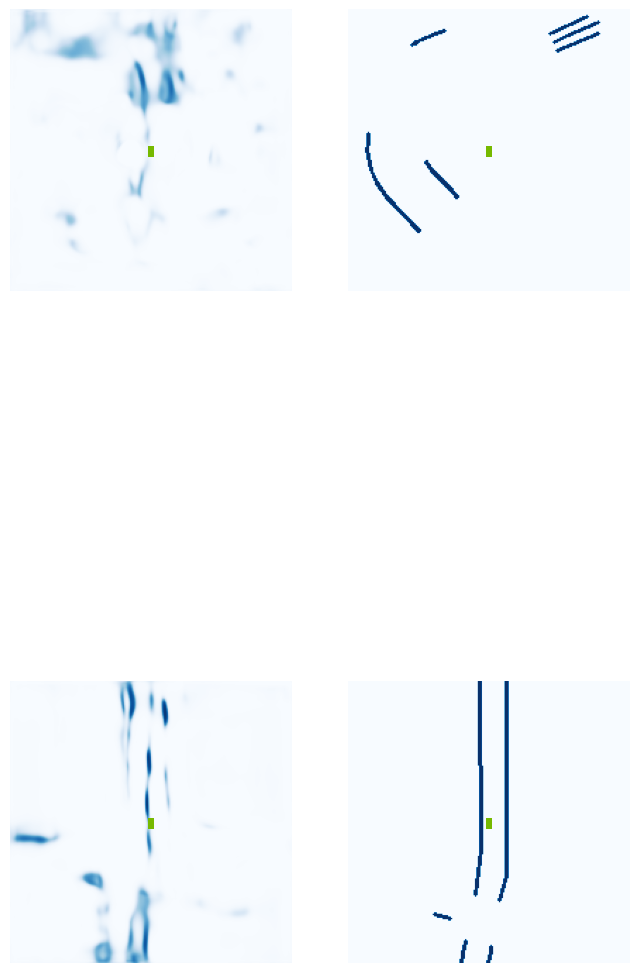

 55%|█████▌    | 22/40 [00:04<00:03,  4.95it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.92it/s]

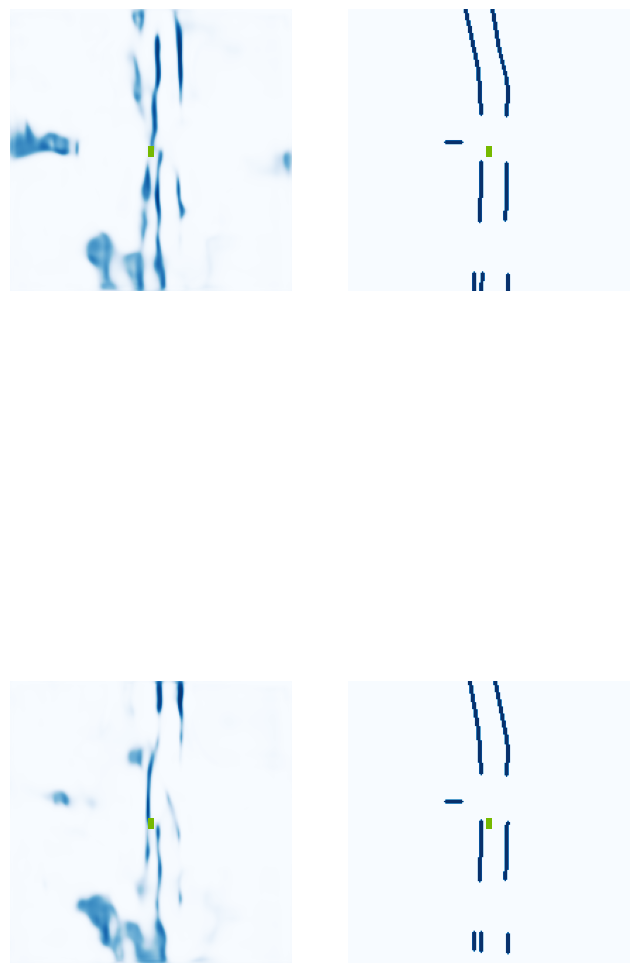

 68%|██████▊   | 27/40 [00:05<00:02,  5.32it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.69it/s]

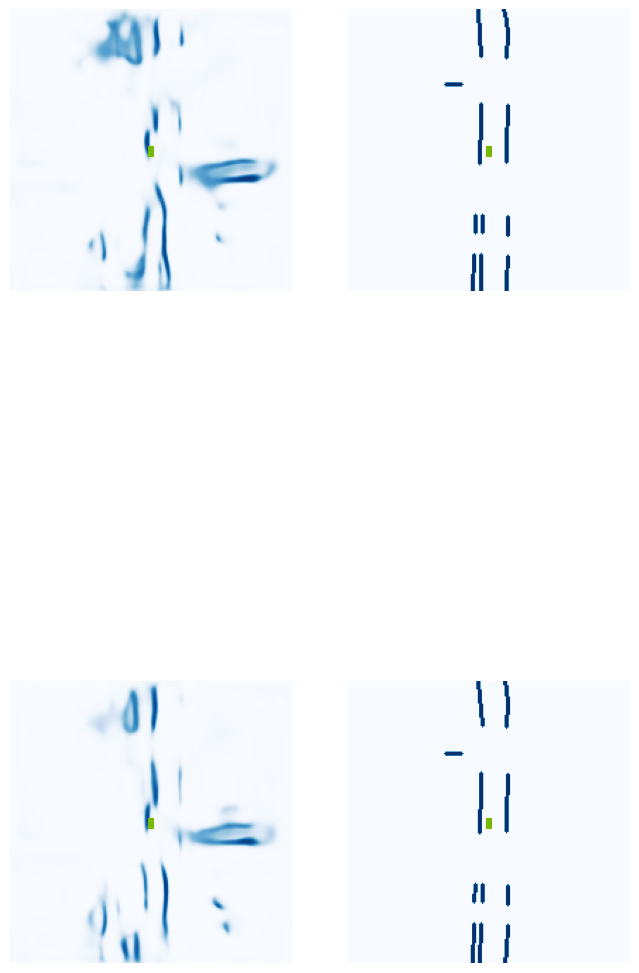

 80%|████████  | 32/40 [00:06<00:01,  4.88it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.15it/s]

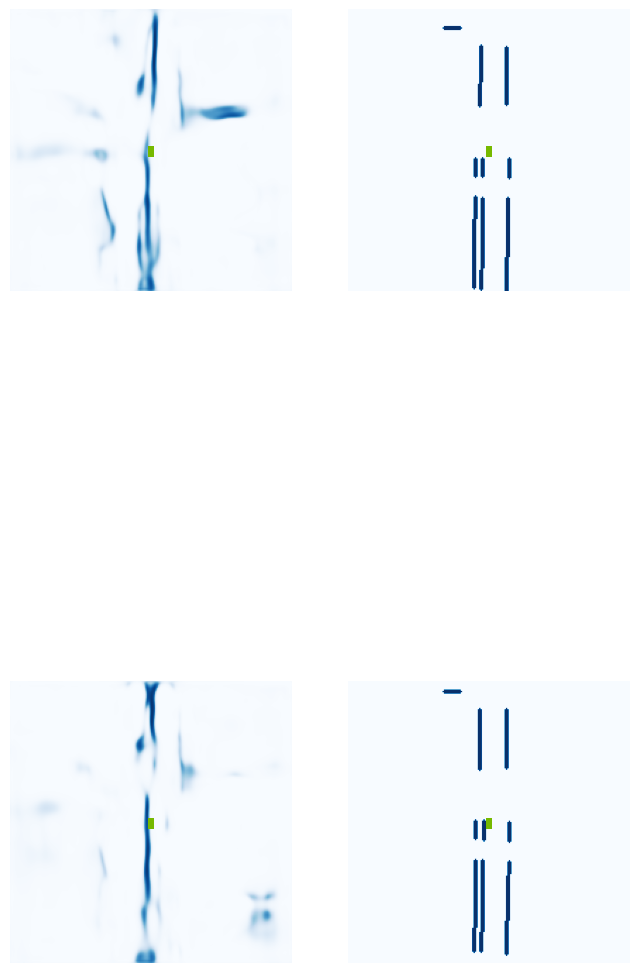

 92%|█████████▎| 37/40 [00:07<00:00,  4.64it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.07.jpg


100%|██████████| 40/40 [00:08<00:00,  4.96it/s]


VAL {'loss': 0.2146656064339626, 'iou': 0.029390808692554327}
saving ...  ./runs/model5500.pt
5510 0.08747603744268417
5520 0.06488709896802902
5530 0.06772030144929886
5540 0.14688944816589355
5550 0.05113549530506134
5560 0.0687745213508606
5570 0.06544630229473114
5580 0.055450595915317535
5590 0.08632516860961914
5600 0.05121663585305214
5610 0.10566233843564987
5620 0.0979509949684143
5630 0.06501563638448715
Epoch: 36/60
5640 0.0573456771671772
5650 0.0832042545080185
5660 0.05486864596605301
5670 0.06115025654435158
5680 0.09532951563596725
5690 0.14496807754039764
5700 0.07516904920339584
5710 0.09586421400308609
5720 0.05099794641137123
5730 0.055694956332445145
5740 0.08184743672609329
5750 0.05828488618135452
5760 0.10182048380374908
5770 0.06325866281986237
5780 0.11681366711854935
5790 0.07006391137838364
Epoch: 37/60
5800 0.09381809830665588
5810 0.043959375470876694
5820 0.04296870157122612
5830 0.043654561042785645
5840 0.0319092832505703
5850 0.060029808431863785
5860 

  0%|          | 0/40 [00:00<?, ?it/s]

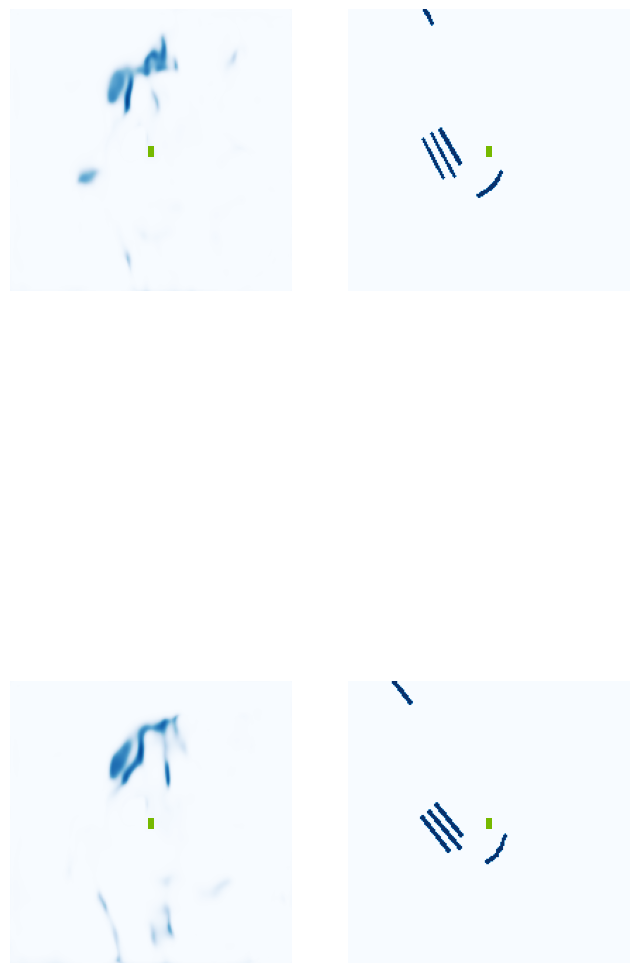

  5%|▌         | 2/40 [00:01<00:19,  1.94it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.17it/s]

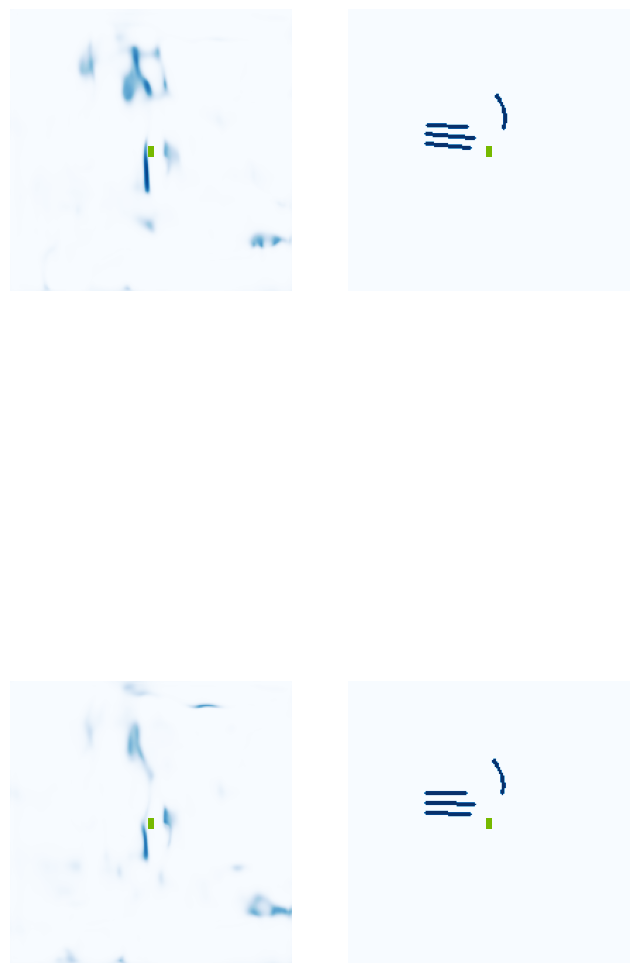

 18%|█▊        | 7/40 [00:02<00:07,  4.58it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.03it/s]

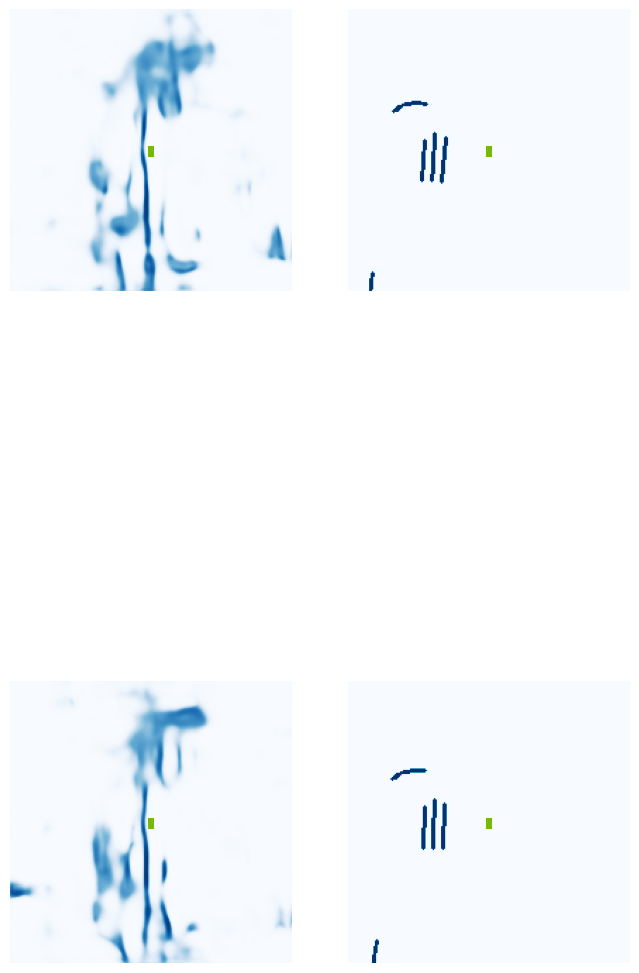

 30%|███       | 12/40 [00:03<00:05,  4.71it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.52it/s]

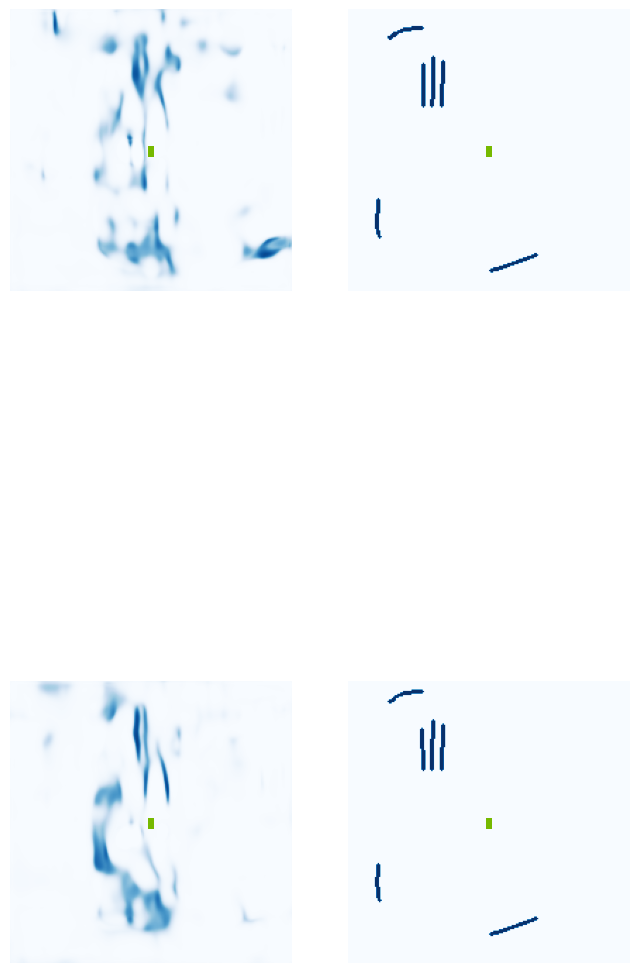

 42%|████▎     | 17/40 [00:03<00:04,  5.19it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.05it/s]

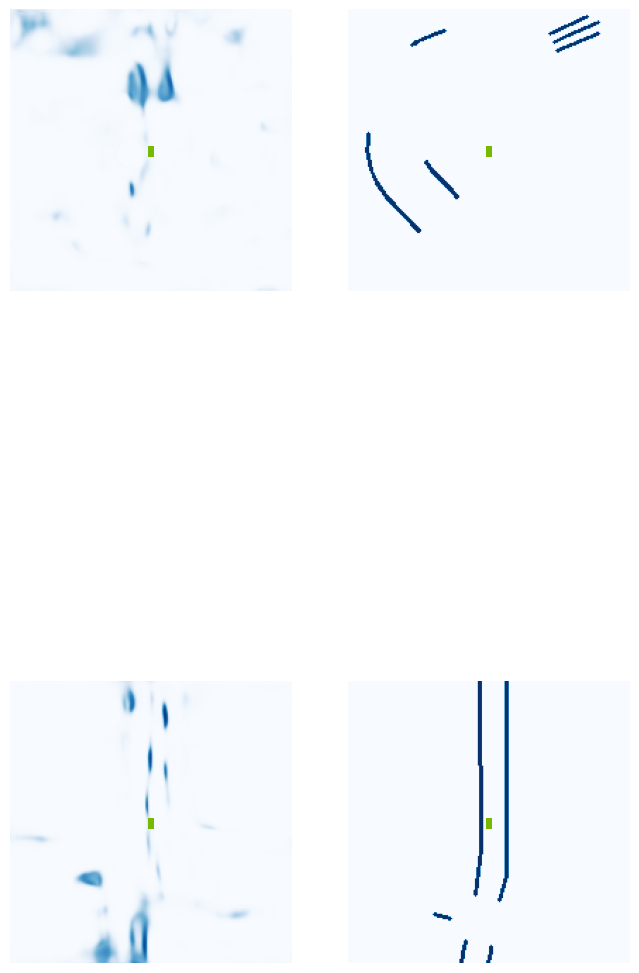

 55%|█████▌    | 22/40 [00:04<00:03,  4.54it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.37it/s]

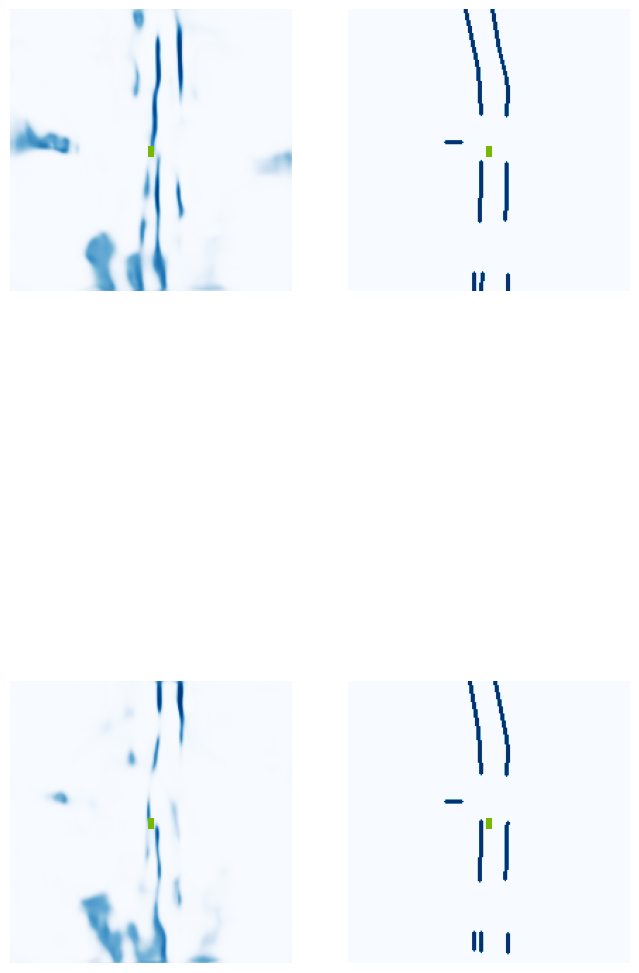

 68%|██████▊   | 27/40 [00:05<00:02,  5.24it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.03.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  7.21it/s]

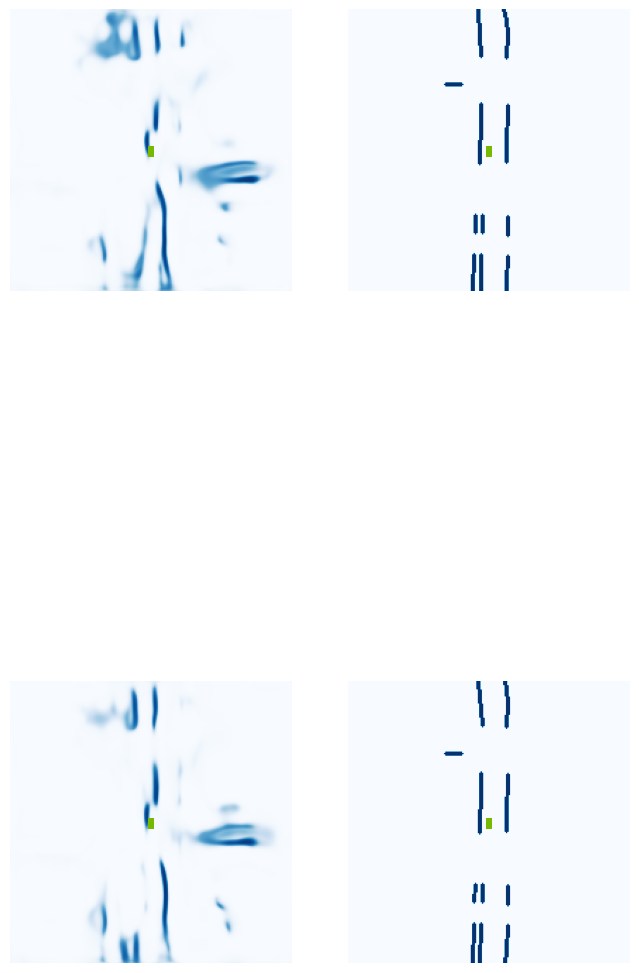

 80%|████████  | 32/40 [00:06<00:01,  4.42it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.04it/s]

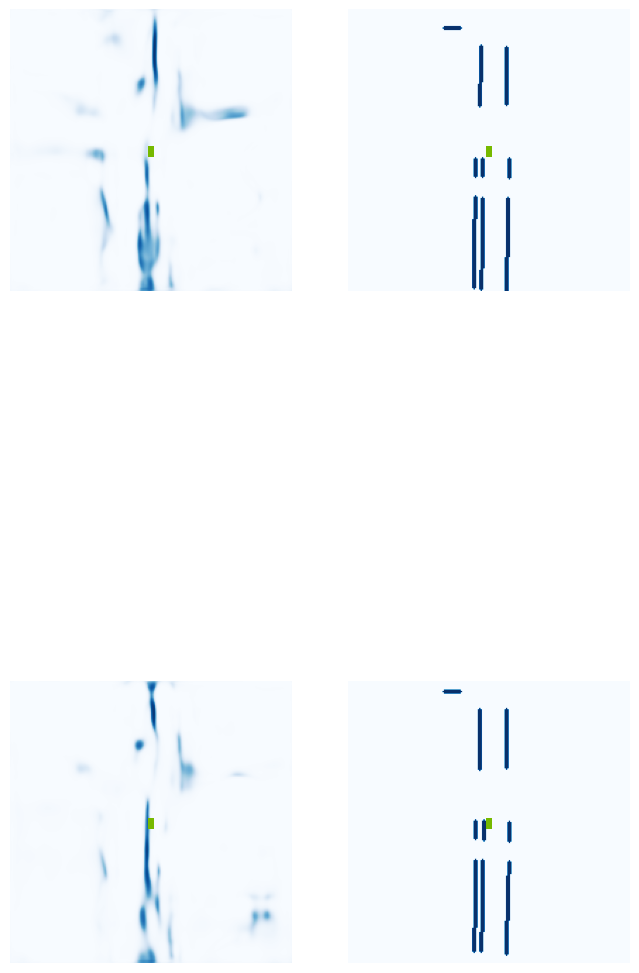

 92%|█████████▎| 37/40 [00:07<00:00,  4.92it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.08.jpg


100%|██████████| 40/40 [00:08<00:00,  4.95it/s]


VAL {'loss': 0.2086813359716792, 'iou': 0.02856163862026955}
saving ...  ./runs/model6000.pt
6010 0.06524773687124252
6020 0.08099784702062607
6030 0.07842447608709335
6040 0.13105694949626923
6050 0.06563381850719452
6060 0.06085251271724701
6070 0.051093559712171555
6080 0.06944259256124496
6090 0.06144820526242256
6100 0.07684703916311264
6110 0.03132043778896332
Epoch: 39/60
6120 0.04316865652799606
6130 0.06233590096235275
6140 0.0457833968102932
6150 0.06043720617890358
6160 0.06531109660863876
6170 0.05530035123229027
6180 0.0917486920952797
6190 0.04994962364435196
6200 0.02689431980252266
6210 0.11060341447591782
6220 0.0648537427186966
6230 0.07527600228786469
6240 0.08523715287446976
6250 0.08428190648555756
6260 0.051930785179138184
6270 0.10767175257205963
Epoch: 40/60
6280 0.06042960658669472
6290 0.03683299943804741
6300 0.08051277697086334
6310 0.04717942327260971
6320 0.06047017499804497
6330 0.06610504537820816
6340 0.07986488193273544
6350 0.07785233110189438
6360 0.

  0%|          | 0/40 [00:00<?, ?it/s]

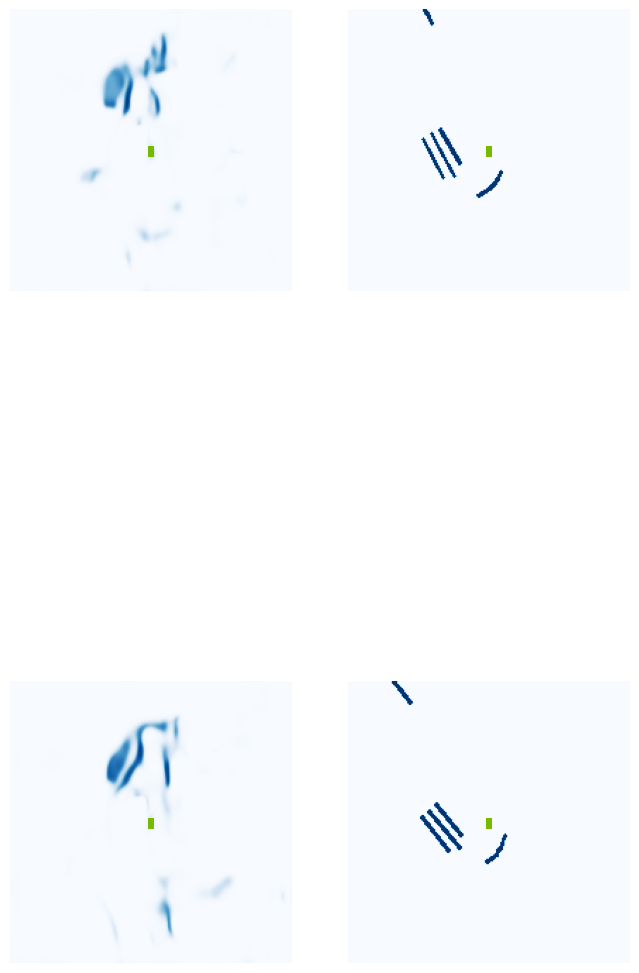

  5%|▌         | 2/40 [00:01<00:23,  1.59it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.64it/s]

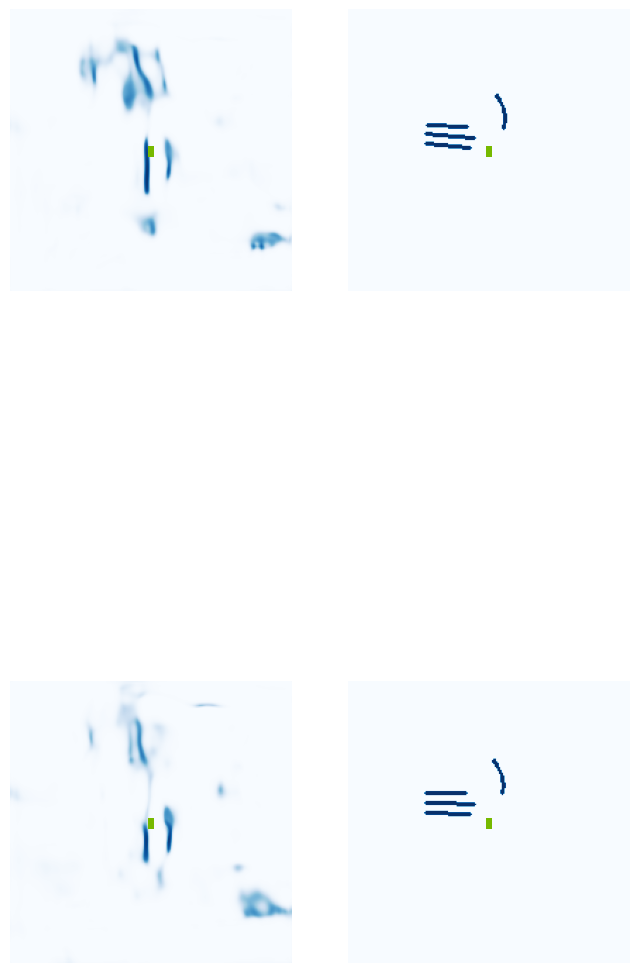

 18%|█▊        | 7/40 [00:02<00:07,  4.51it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.12it/s]

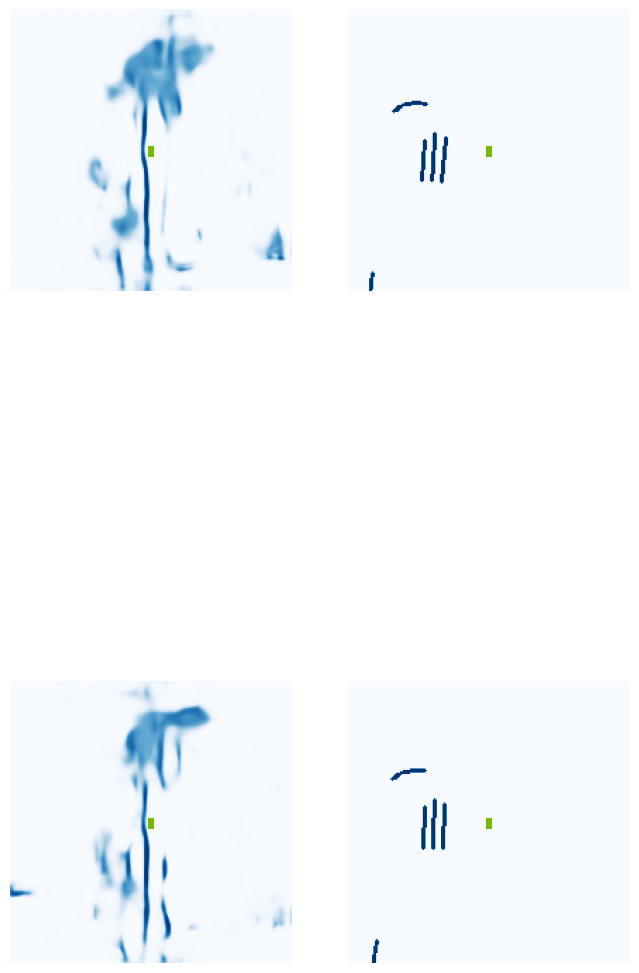

 30%|███       | 12/40 [00:03<00:05,  5.17it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.22it/s]

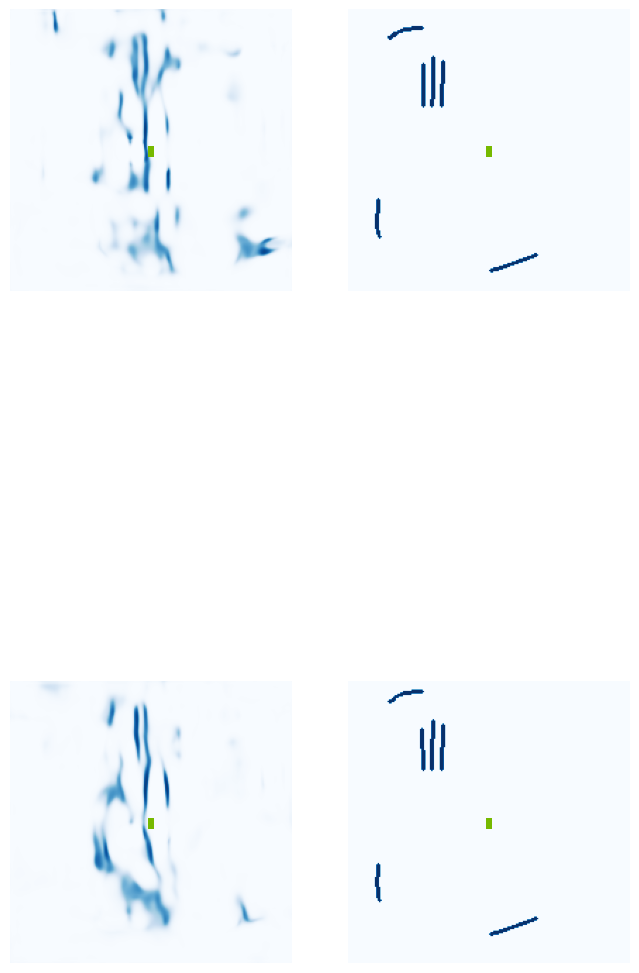

 42%|████▎     | 17/40 [00:04<00:05,  4.40it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  6.81it/s]

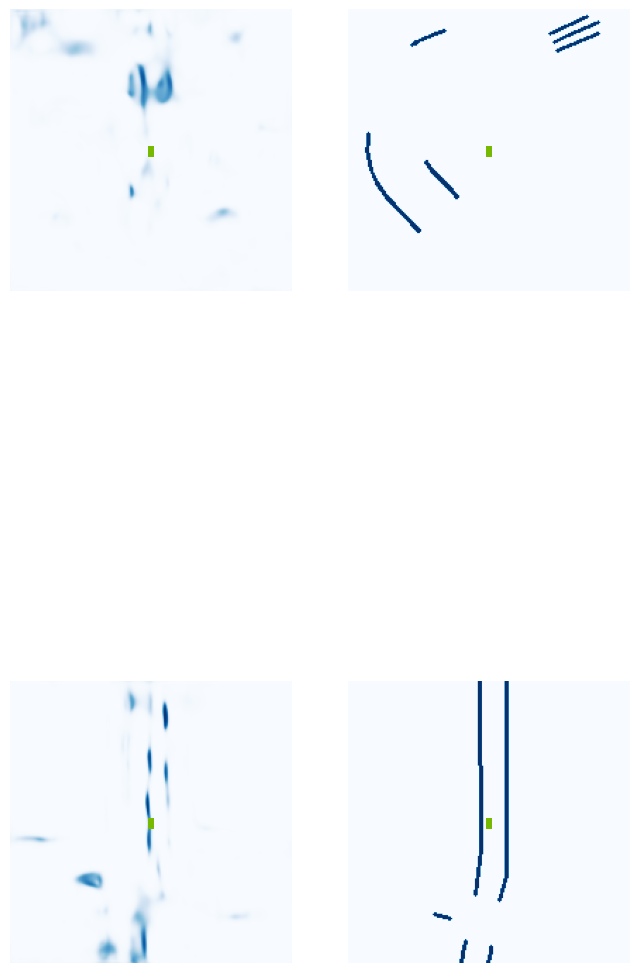

 55%|█████▌    | 22/40 [00:05<00:03,  4.89it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.62it/s]

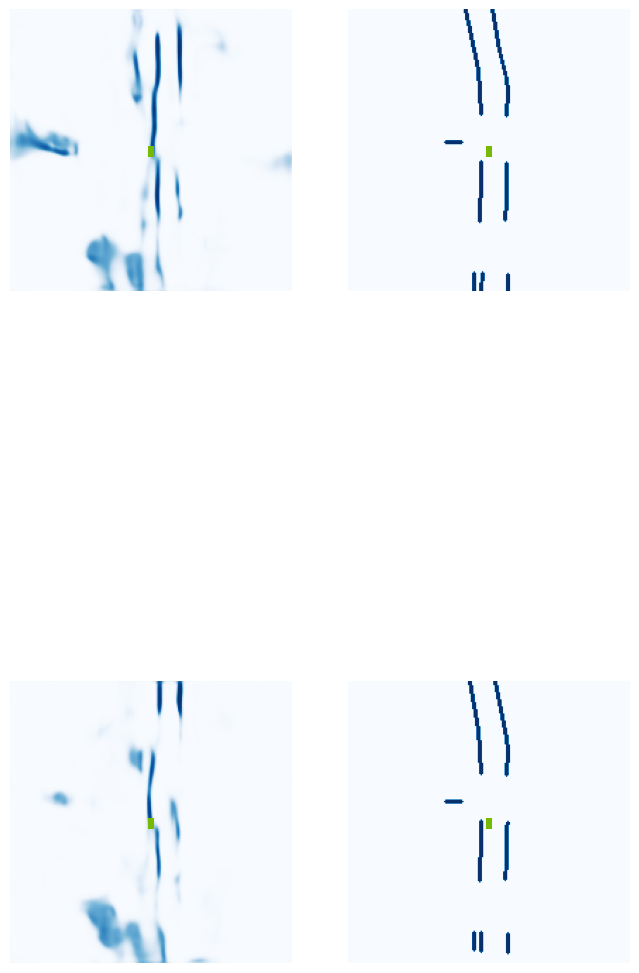

 68%|██████▊   | 27/40 [00:06<00:03,  4.17it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.60it/s]

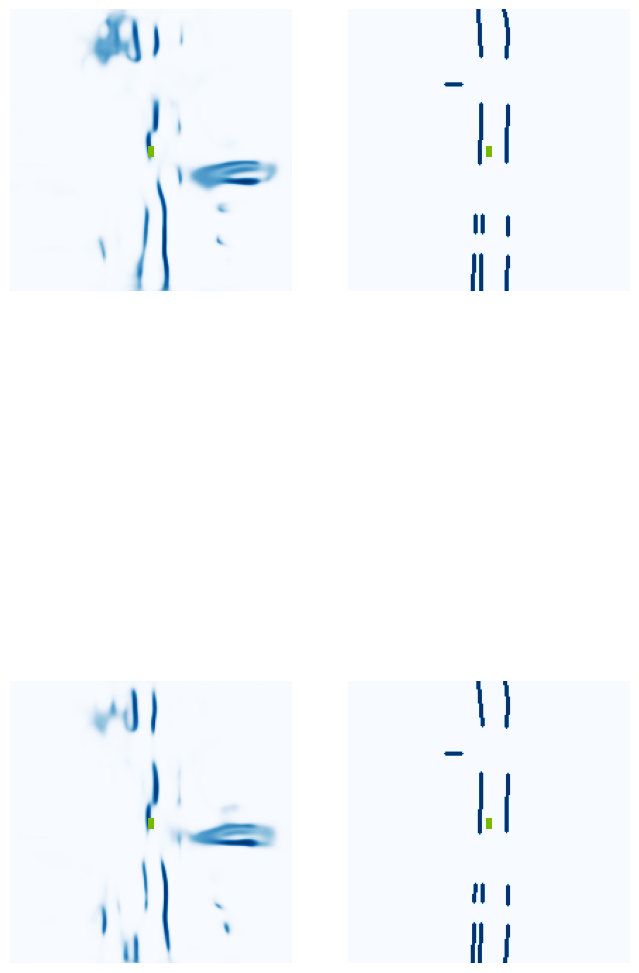

 80%|████████  | 32/40 [00:07<00:01,  4.93it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.03.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.53it/s]

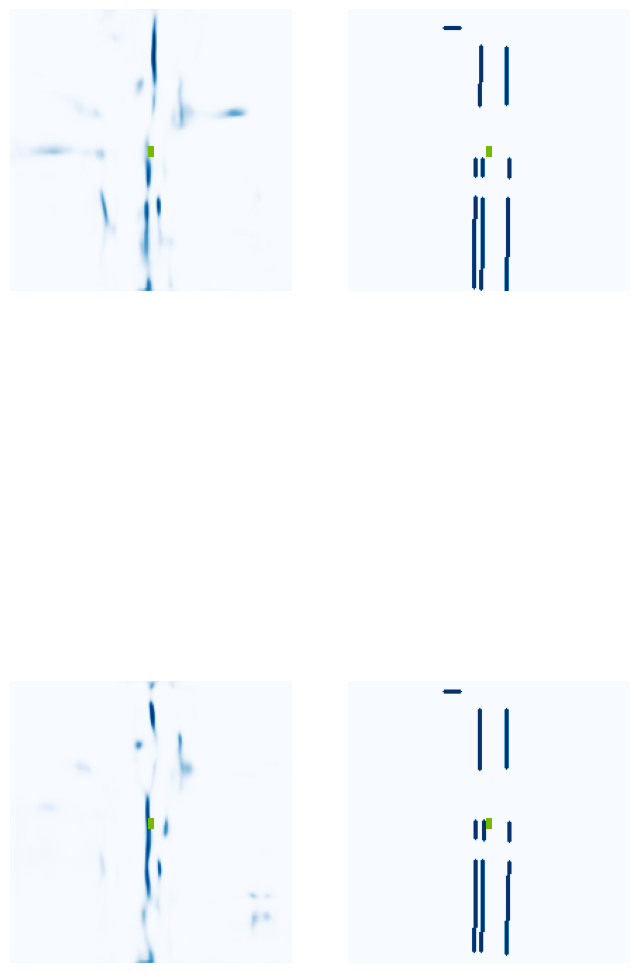

 90%|█████████ | 36/40 [00:08<00:01,  3.52it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.04.jpg


100%|██████████| 40/40 [00:08<00:00,  4.64it/s]


VAL {'loss': 0.2166151382305004, 'iou': 0.021544470689947973}
saving ...  ./runs/model6500.pt
6510 0.06811102479696274
6520 0.06641844660043716
6530 0.056503776460886
6540 0.04457401484251022
6550 0.14153319597244263
6560 0.06417489796876907
6570 0.06523962318897247
6580 0.07807305455207825
6590 0.03218463808298111
6600 0.059552859514951706
Epoch: 42/60
6610 0.030484355986118317
6620 0.055400628596544266
6630 0.06096412241458893
6640 0.03576911240816116
6650 0.07355925440788269
6660 0.06772579997777939
6670 0.083650141954422
6680 0.036200590431690216
6690 0.08970294892787933
6700 0.056222617626190186
6710 0.038103606551885605
6720 0.05075354501605034
6730 0.049495428800582886
6740 0.08006623387336731
6750 0.04505673423409462
6760 0.08756083995103836
Epoch: 43/60
6770 0.03592657297849655
6780 0.06730267405509949
6790 0.06166476756334305
6800 0.10932878404855728
6810 0.034183647483587265
6820 0.12551437318325043
6830 0.04843558371067047
6840 0.04980384558439255
6850 0.04928768053650856
6

  0%|          | 0/40 [00:00<?, ?it/s]

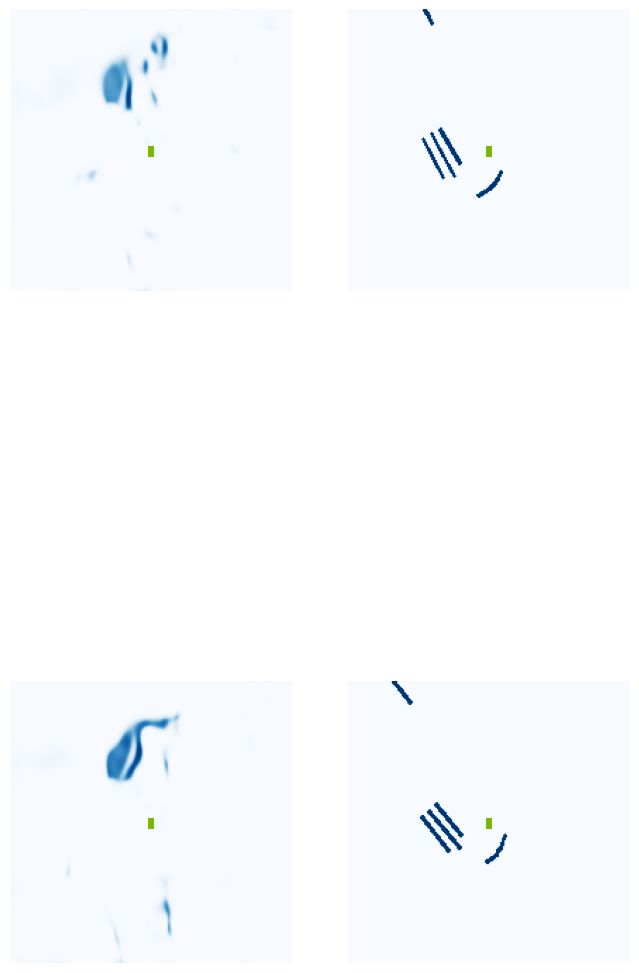

  5%|▌         | 2/40 [00:01<00:18,  2.04it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.40it/s]

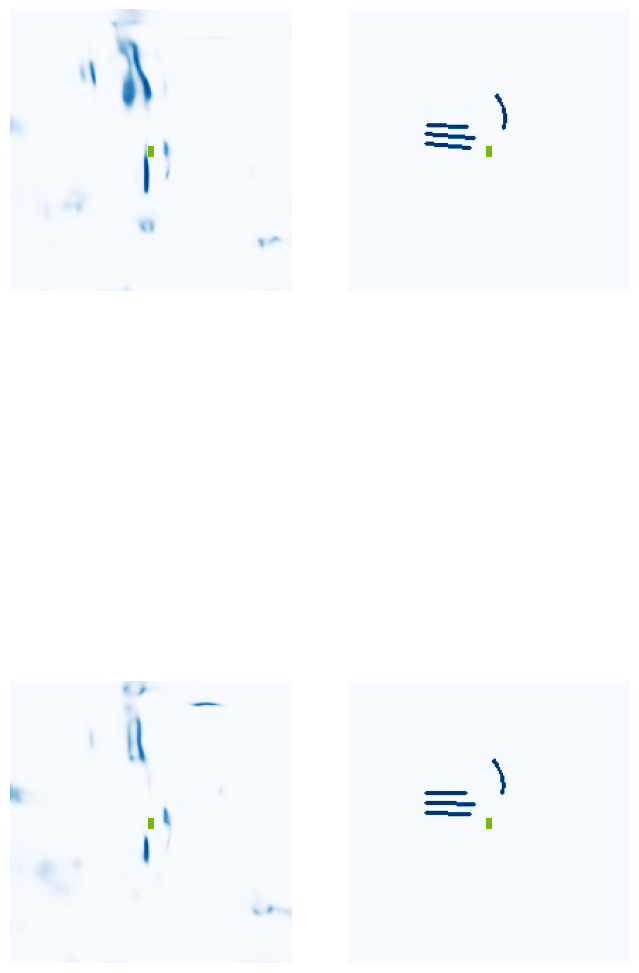

 18%|█▊        | 7/40 [00:01<00:06,  4.92it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.19it/s]

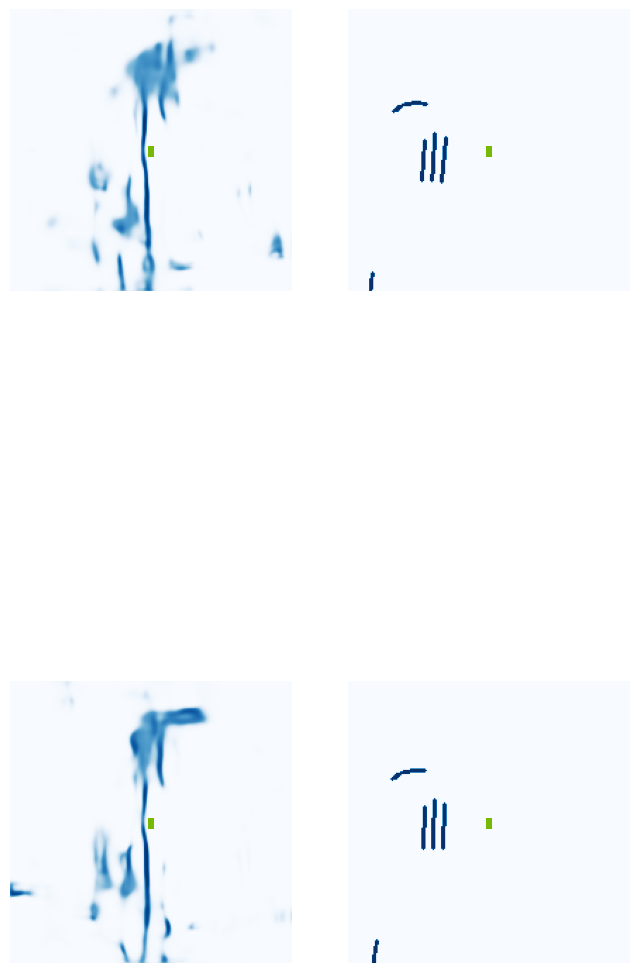

 30%|███       | 12/40 [00:02<00:05,  4.67it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.96it/s]

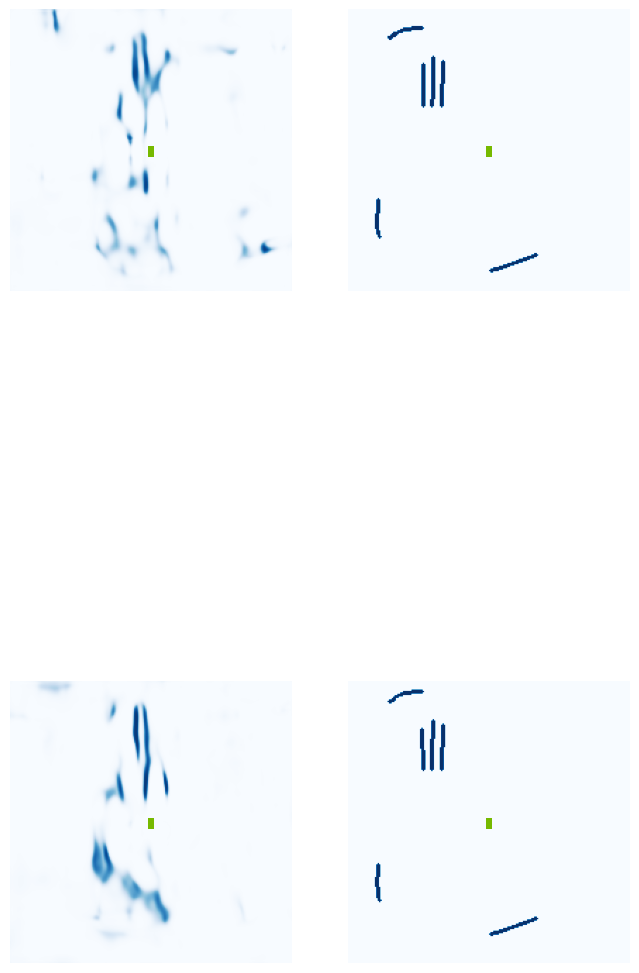

 42%|████▎     | 17/40 [00:04<00:06,  3.64it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:03,  6.16it/s]

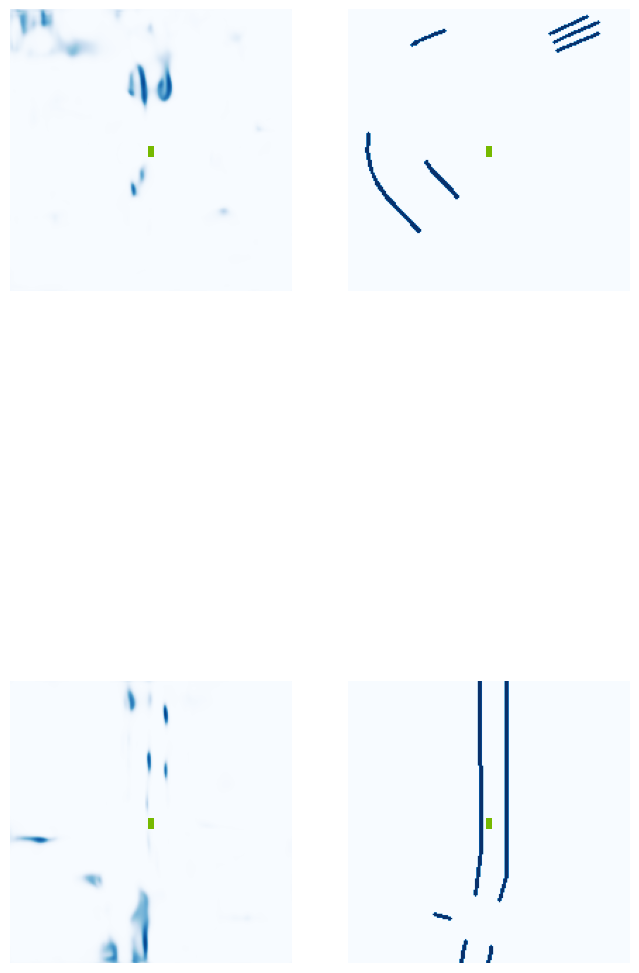

 55%|█████▌    | 22/40 [00:05<00:03,  4.76it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.00.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  5.73it/s]

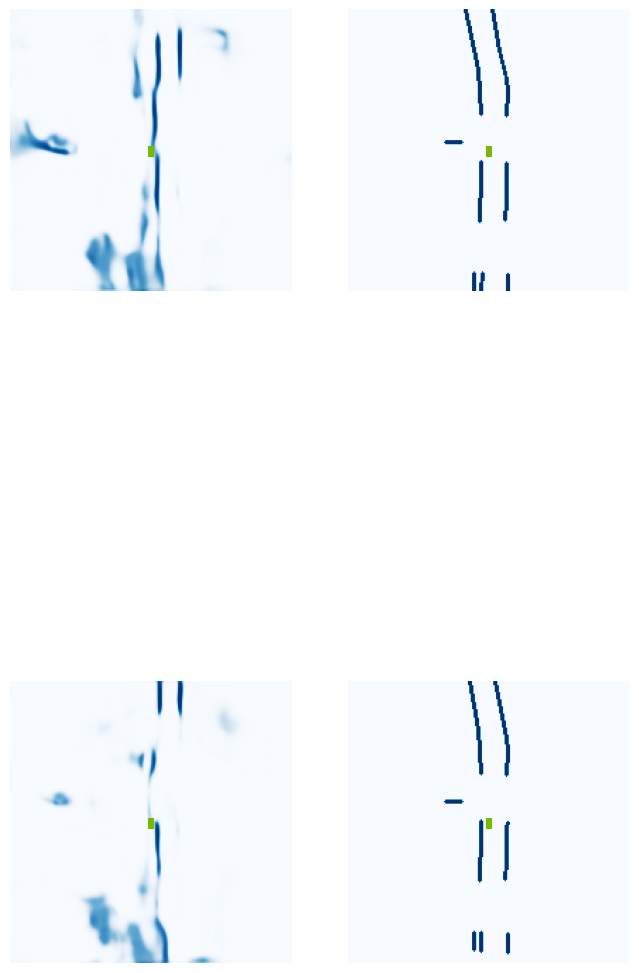

 68%|██████▊   | 27/40 [00:06<00:02,  4.69it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.06.jpg


 72%|███████▎  | 29/40 [00:06<00:02,  5.38it/s]

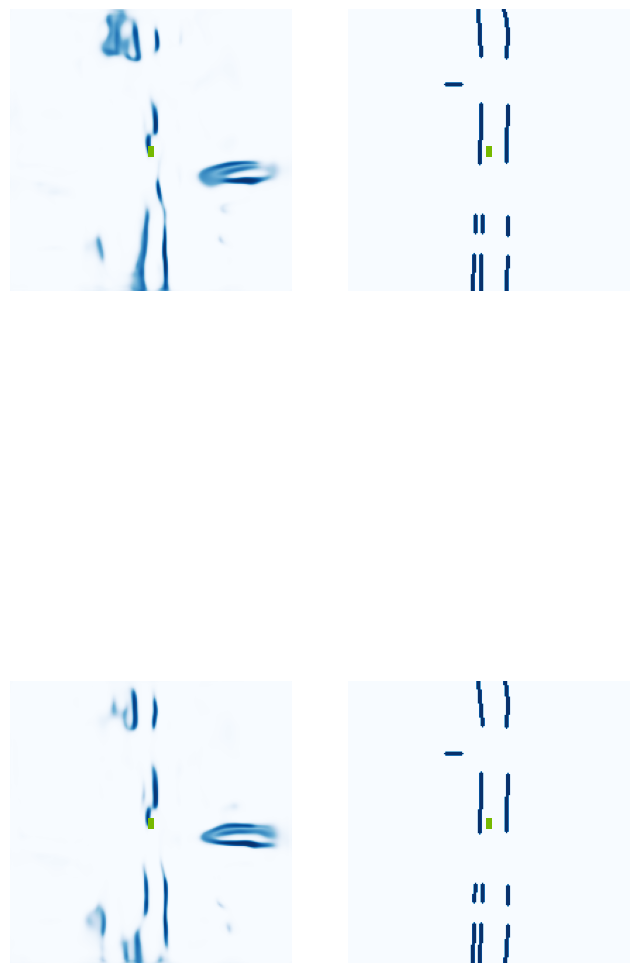

 80%|████████  | 32/40 [00:07<00:01,  4.40it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  5.09it/s]

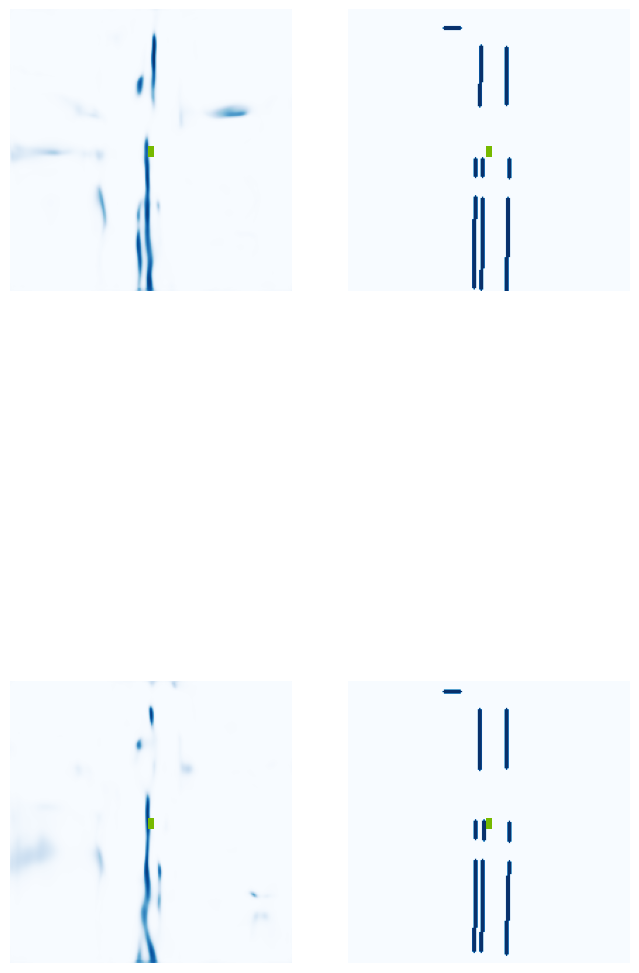

 92%|█████████▎| 37/40 [00:08<00:00,  4.59it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.08.jpg


100%|██████████| 40/40 [00:08<00:00,  4.66it/s]


VAL {'loss': 0.22309395523718845, 'iou': 0.03235291681506821}
saving ...  ./runs/model7000.pt
7010 0.06965373456478119
7020 0.07340404391288757
7030 0.03827625513076782
7040 0.048855602741241455
7050 0.048246197402477264
7060 0.04982178285717964
7070 0.04371204227209091
7080 0.11198139190673828
Epoch: 45/60
7090 0.0888325423002243
7100 0.055307645350694656
7110 0.0564187727868557
7120 0.08024796098470688
7130 0.10132894665002823
7140 0.07517697662115097
7150 0.02799941413104534
7160 0.05288802459836006
7170 0.04348038136959076
7180 0.06356025487184525
7190 0.04987117275595665
7200 0.045512858778238297
7210 0.04773803427815437
7220 0.04043447598814964
7230 0.04930417984724045
7240 0.034511540085077286
Epoch: 46/60
7250 0.05188189446926117
7260 0.03517964854836464
7270 0.017893783748149872
7280 0.056259408593177795
7290 0.05193210765719414
7300 0.03784108906984329
7310 0.04177194833755493
7320 0.05654221028089523
7330 0.037674713879823685
7340 0.07475458085536957
7350 0.05368569120764732

  0%|          | 0/40 [00:00<?, ?it/s]

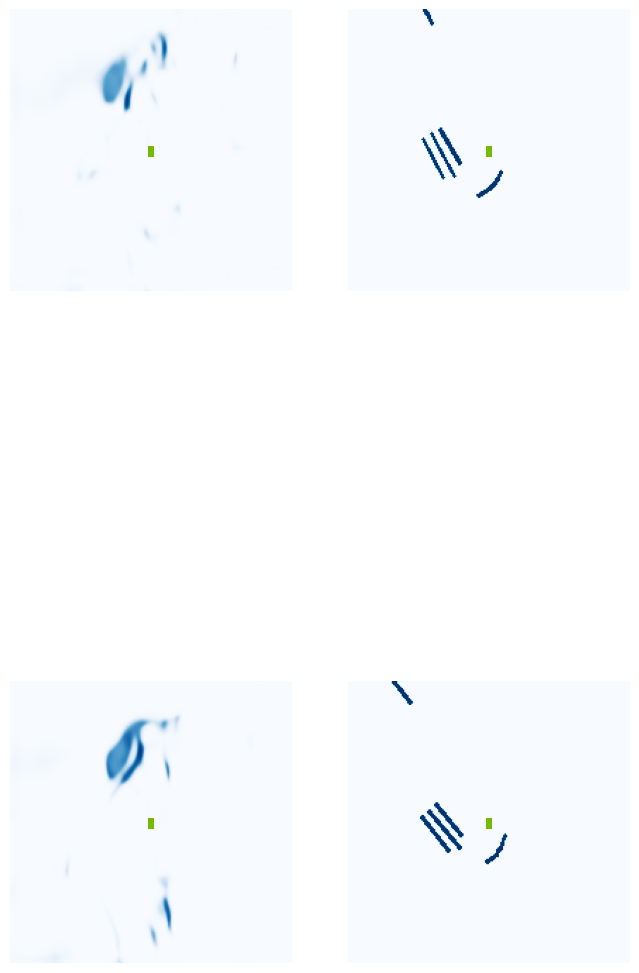

  5%|▌         | 2/40 [00:01<00:18,  2.00it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.30it/s]

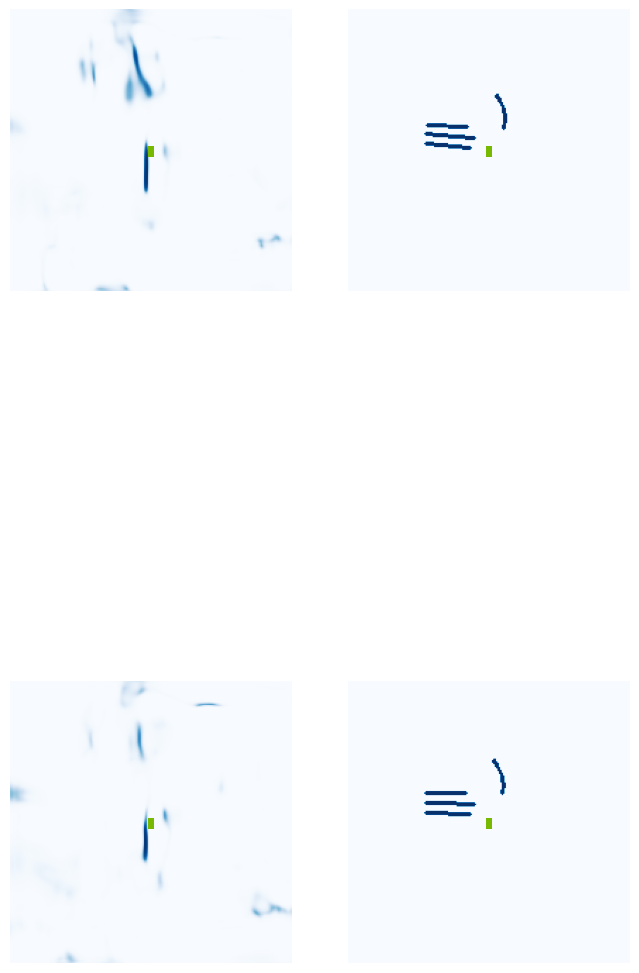

 18%|█▊        | 7/40 [00:01<00:06,  4.77it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.21it/s]

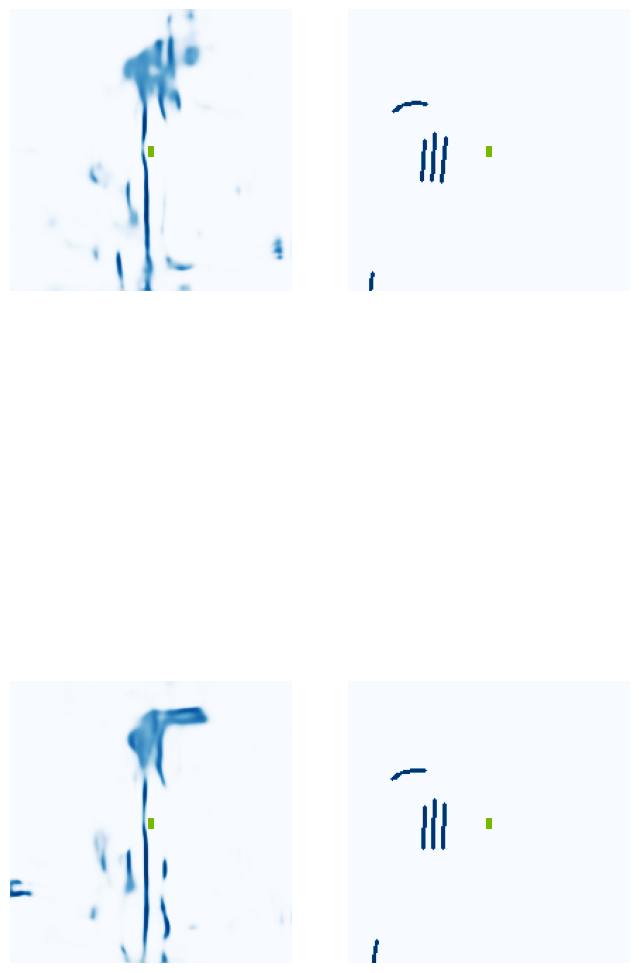

 30%|███       | 12/40 [00:02<00:05,  4.79it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.03it/s]

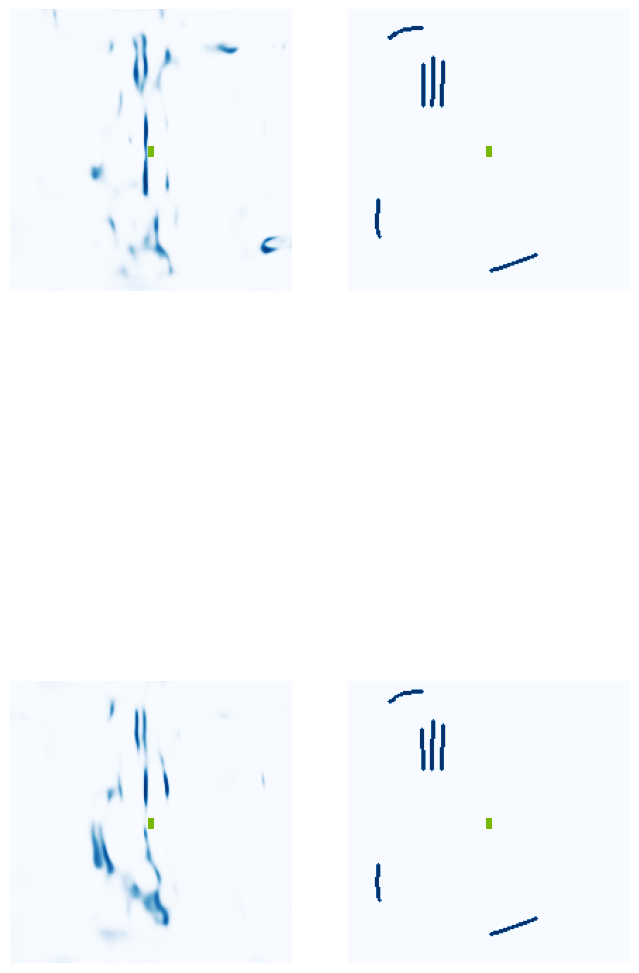

 42%|████▎     | 17/40 [00:03<00:04,  5.38it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.34it/s]

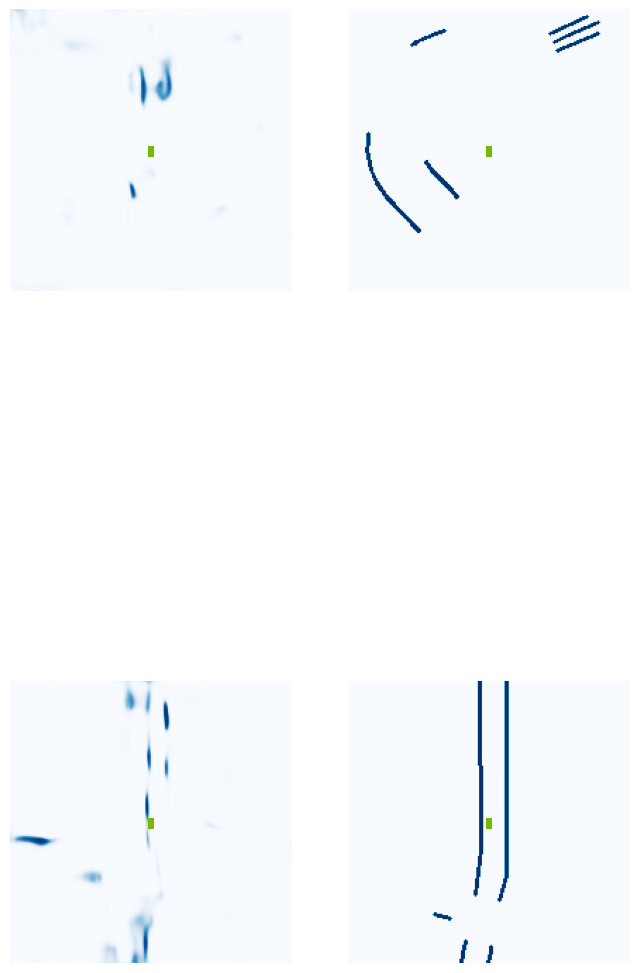

 55%|█████▌    | 22/40 [00:04<00:03,  4.89it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.15it/s]

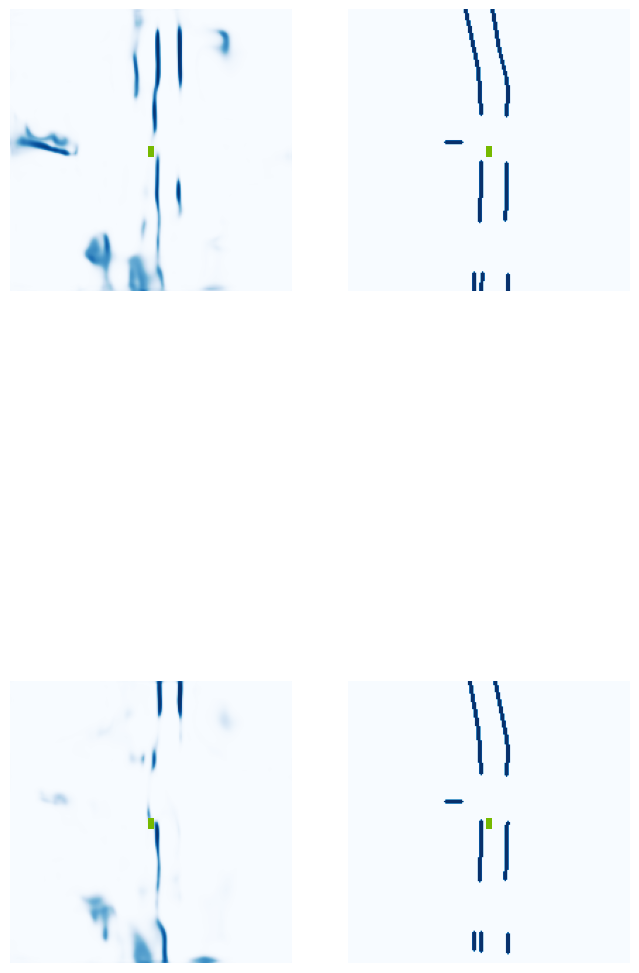

 68%|██████▊   | 27/40 [00:05<00:02,  5.10it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.05.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.96it/s]

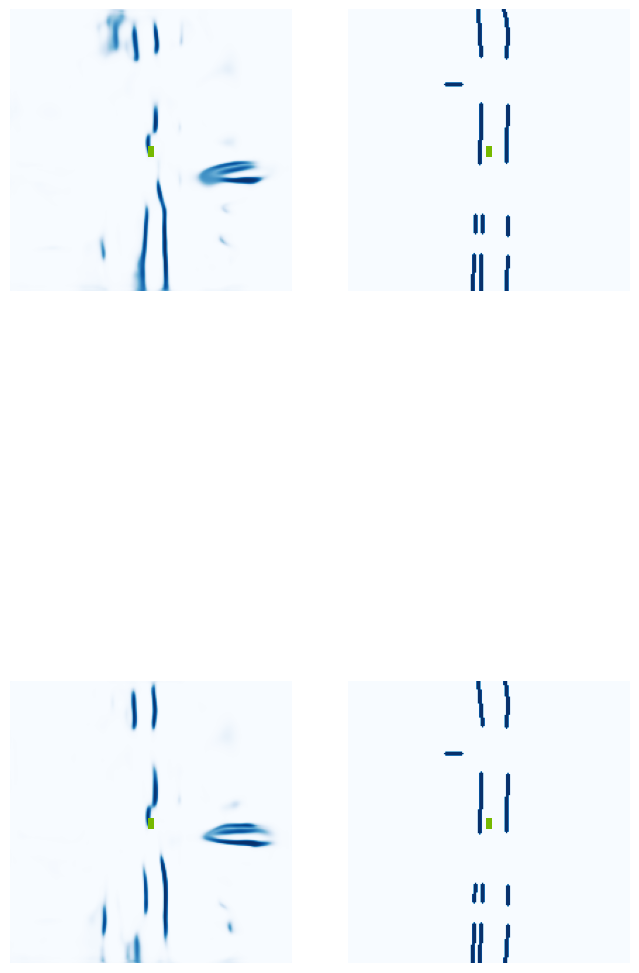

 82%|████████▎ | 33/40 [00:07<00:01,  3.85it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  5.22it/s]

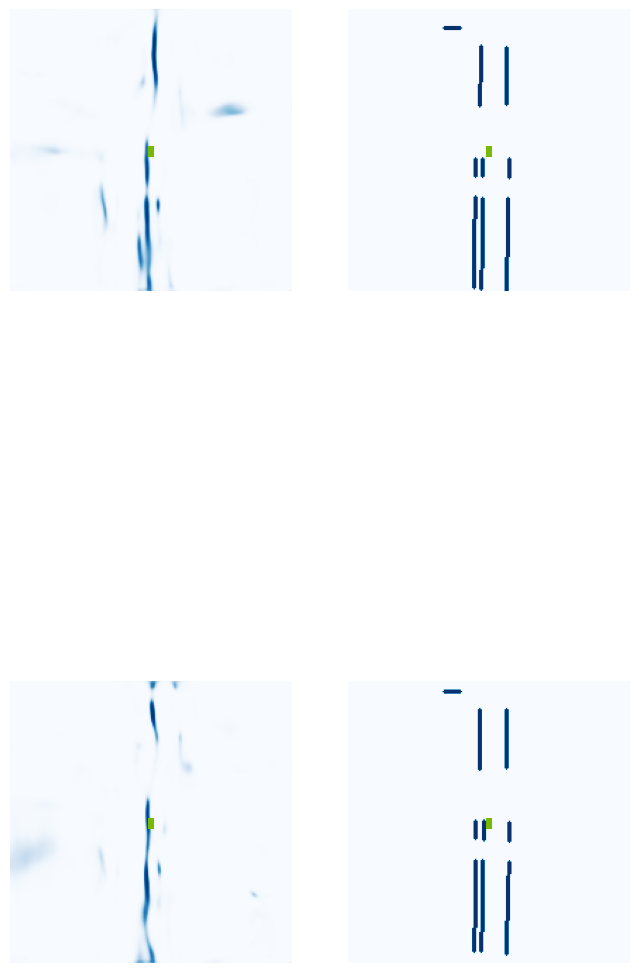

 92%|█████████▎| 37/40 [00:07<00:00,  4.50it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.06.jpg


100%|██████████| 40/40 [00:08<00:00,  4.71it/s]


VAL {'loss': 0.22591069193533908, 'iou': 0.0310245841307228}
saving ...  ./runs/model7500.pt
7510 0.030093546956777573
7520 0.08178579807281494
7530 0.06607940793037415
7540 0.03834741562604904
7550 0.043310485780239105
7560 0.05948161333799362
Epoch: 48/60
7570 0.11651024967432022
7580 0.03263292834162712
7590 0.041353318840265274
7600 0.06890278309583664
7610 0.03596291318535805
7620 0.059065256267786026
7630 0.06472209841012955
7640 0.05375702306628227
7650 0.039804913103580475
7660 0.07190975546836853
7670 0.053187716752290726
7680 0.04203464835882187
7690 0.04676661267876625
7700 0.036292120814323425
7710 0.04103211313486099
7720 0.11445675790309906
Epoch: 49/60
7730 0.043859850615262985
7740 0.05537516251206398
7750 0.07263889908790588
7760 0.07423726469278336
7770 0.09803030639886856
7780 0.026578735560178757
7790 0.04870691895484924
7800 0.03260412812232971
7810 0.03519820421934128
7820 0.051301974803209305
7830 0.050995755940675735
7840 0.04603537917137146
7850 0.0866489261388

  0%|          | 0/40 [00:00<?, ?it/s]

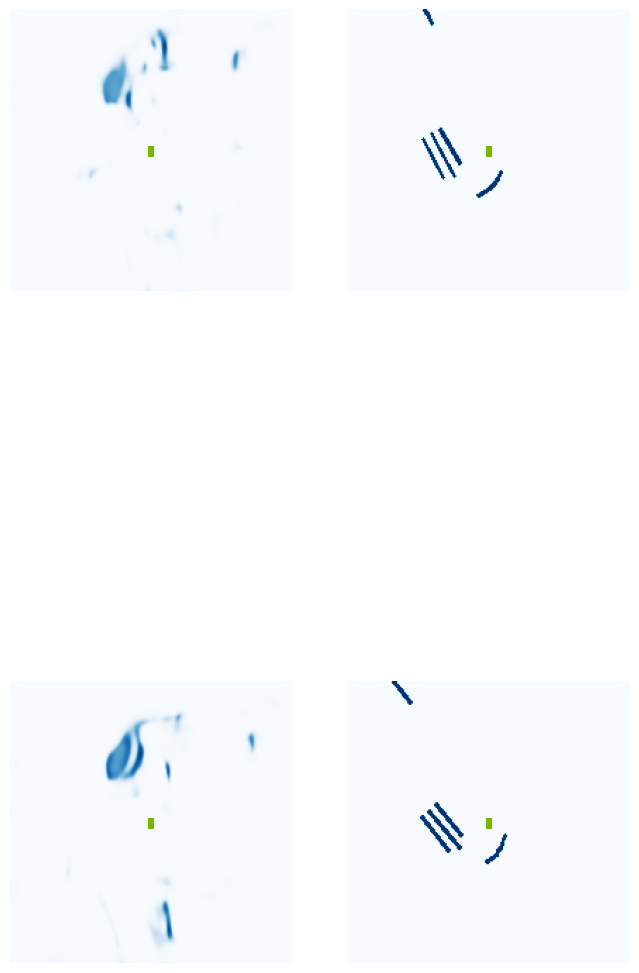

  5%|▌         | 2/40 [00:01<00:19,  1.99it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.26it/s]

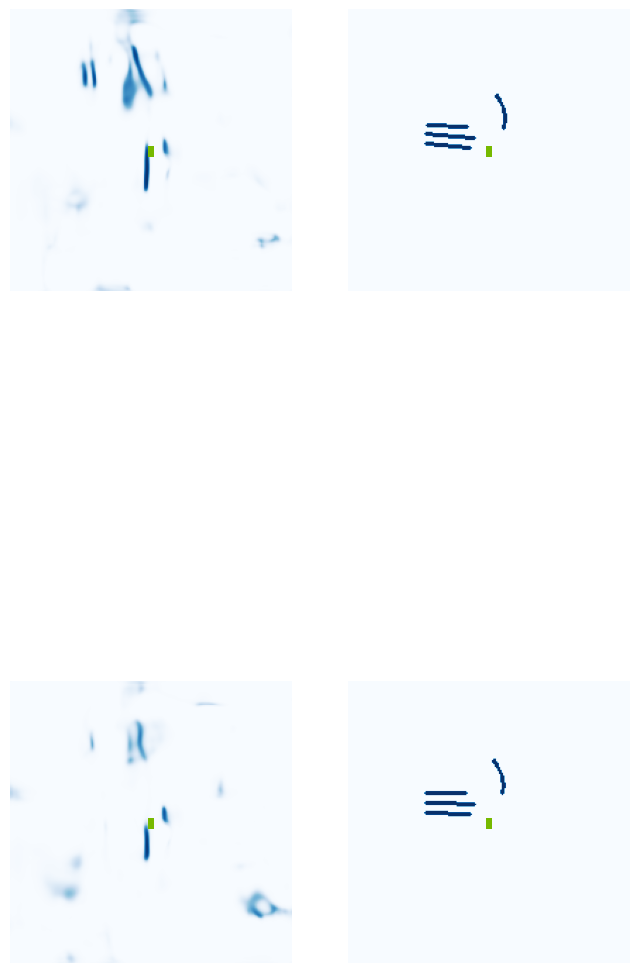

 18%|█▊        | 7/40 [00:01<00:06,  4.79it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  6.86it/s]

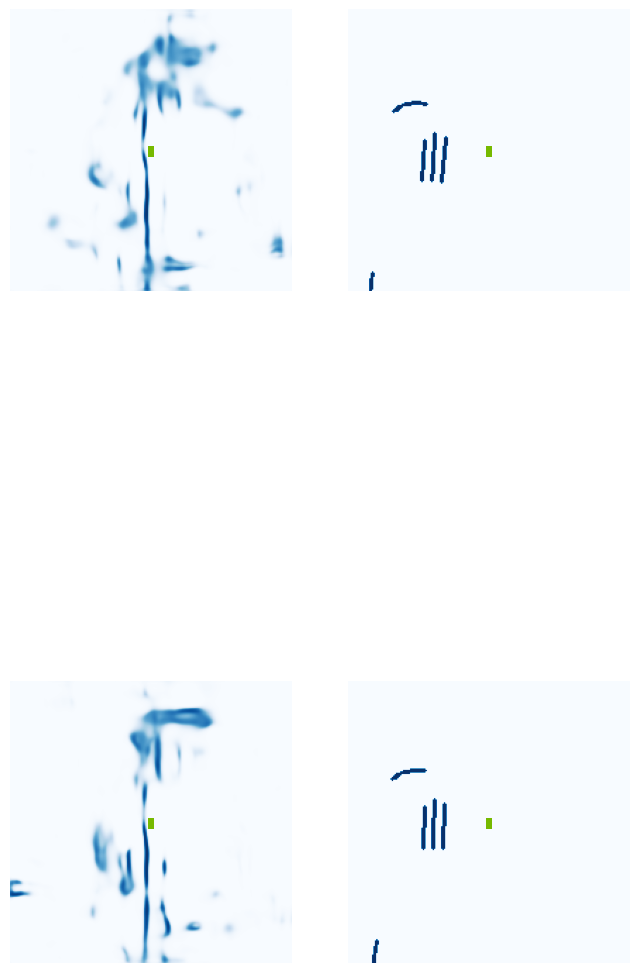

 30%|███       | 12/40 [00:02<00:05,  4.96it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.18it/s]

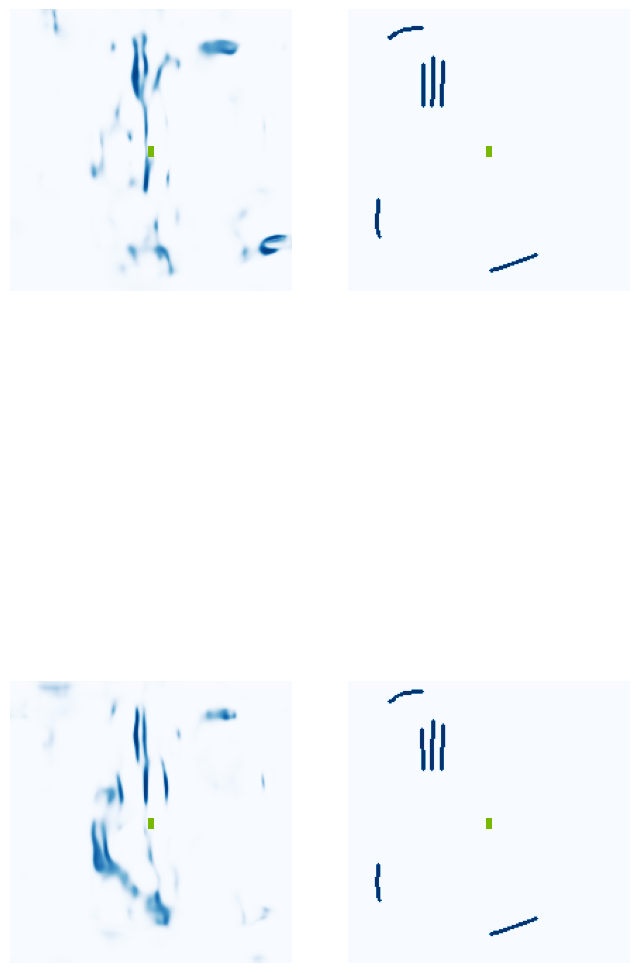

 42%|████▎     | 17/40 [00:03<00:04,  5.25it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.41it/s]

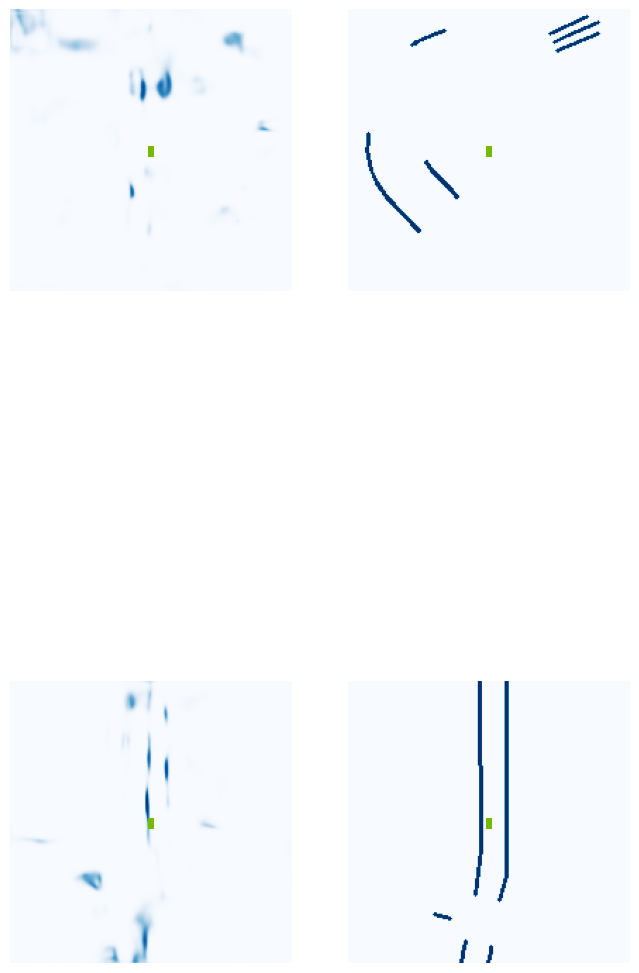

 57%|█████▊    | 23/40 [00:04<00:03,  5.55it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  5.64it/s]

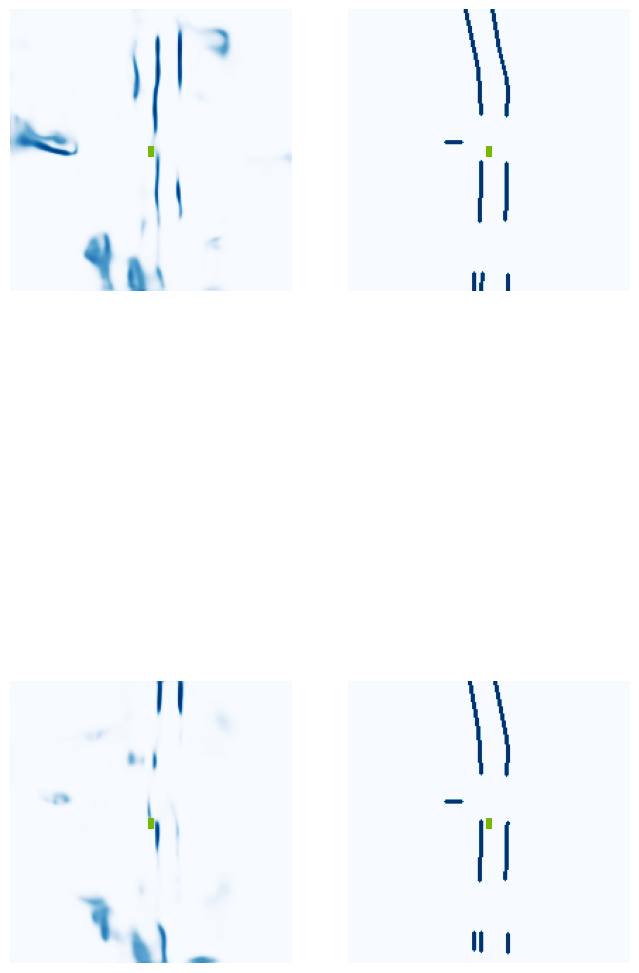

 68%|██████▊   | 27/40 [00:05<00:02,  5.08it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 72%|███████▎  | 29/40 [00:05<00:02,  5.04it/s]

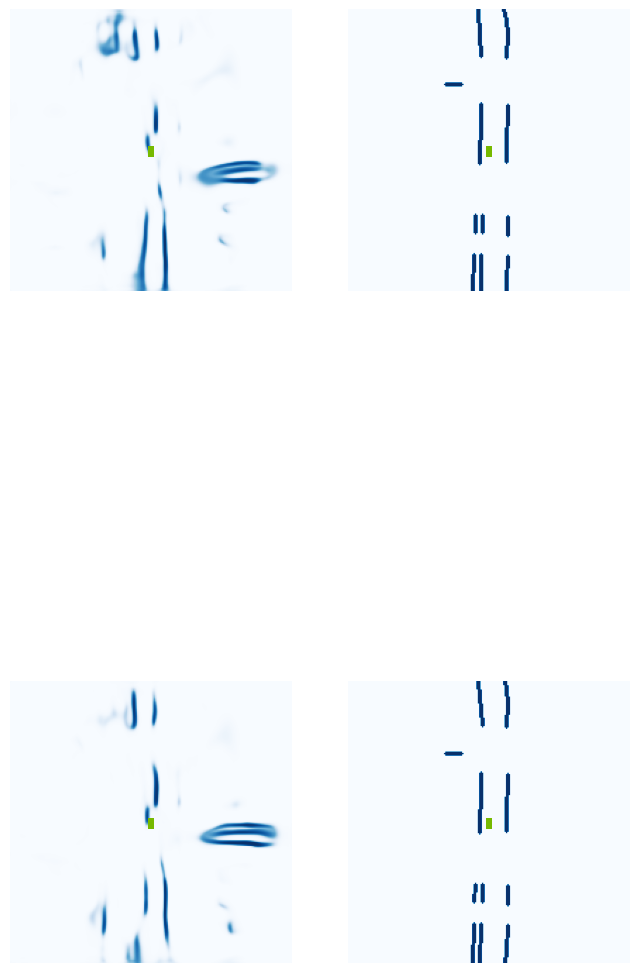

 82%|████████▎ | 33/40 [00:06<00:01,  5.18it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.05.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.11it/s]

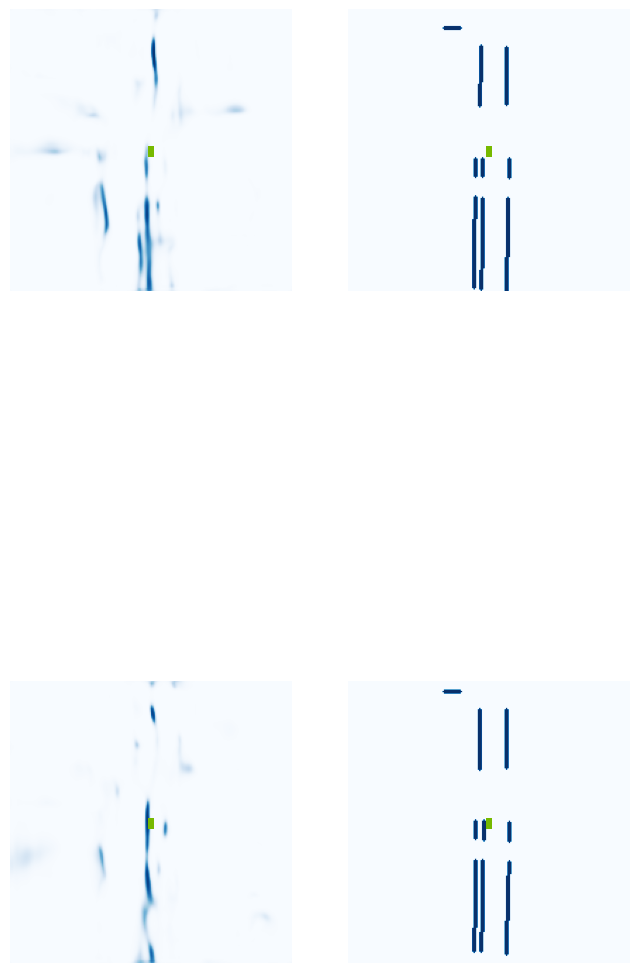

 92%|█████████▎| 37/40 [00:07<00:00,  5.12it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.04.jpg


100%|██████████| 40/40 [00:08<00:00,  4.98it/s]


VAL {'loss': 0.2276240465817628, 'iou': 0.027143046416110938}
saving ...  ./runs/model8000.pt
8010 0.023995136842131615
8020 0.06605883687734604
8030 0.06830727308988571
8040 0.07365109771490097
8050 0.05849739909172058
Epoch: 51/60
8060 0.05726642906665802
8070 0.03951740637421608
8080 0.026271361857652664
8090 0.03323793411254883
8100 0.028168175369501114
8110 0.04496070370078087
8120 0.02803027257323265
8130 0.06342650204896927
8140 0.04948301613330841
8150 0.04135526716709137
8160 0.04931250587105751
8170 0.05547716096043587
8180 0.04347657412290573
8190 0.025948407128453255
8200 0.09520936012268066
8210 0.03755754977464676
Epoch: 52/60
8220 0.09701965004205704
8230 0.03183315694332123
8240 0.030607525259256363
8250 0.039411548525094986
8260 0.043649591505527496
8270 0.0333368293941021
8280 0.06673593819141388
8290 0.026043478399515152
8300 0.06850462406873703
8310 0.034188974648714066
8320 0.030994970351457596
8330 0.09983577579259872
8340 0.05405610054731369
8350 0.03674523904919

  0%|          | 0/40 [00:00<?, ?it/s]

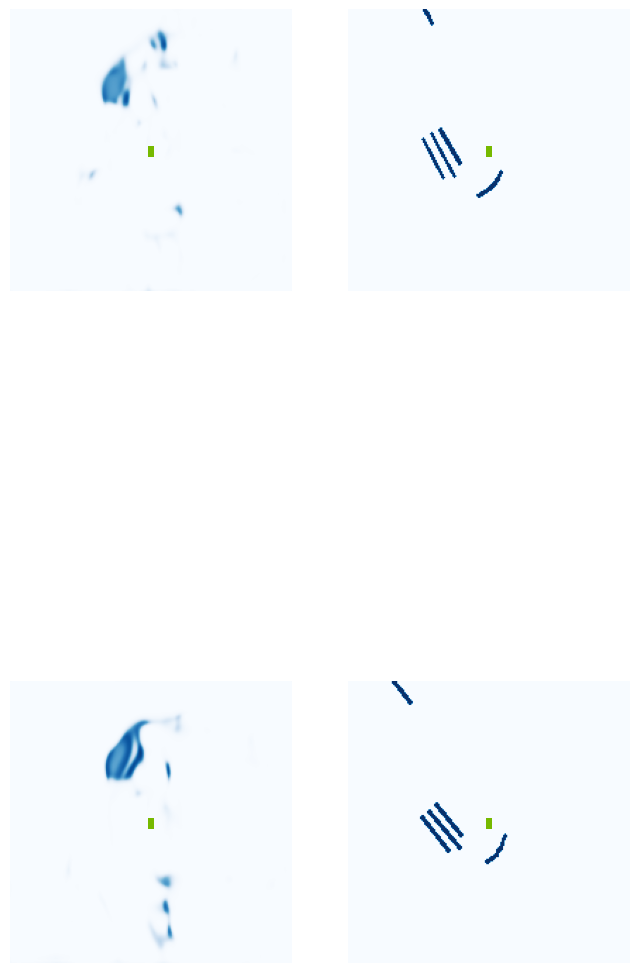

  5%|▌         | 2/40 [00:01<00:18,  2.07it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.40it/s]

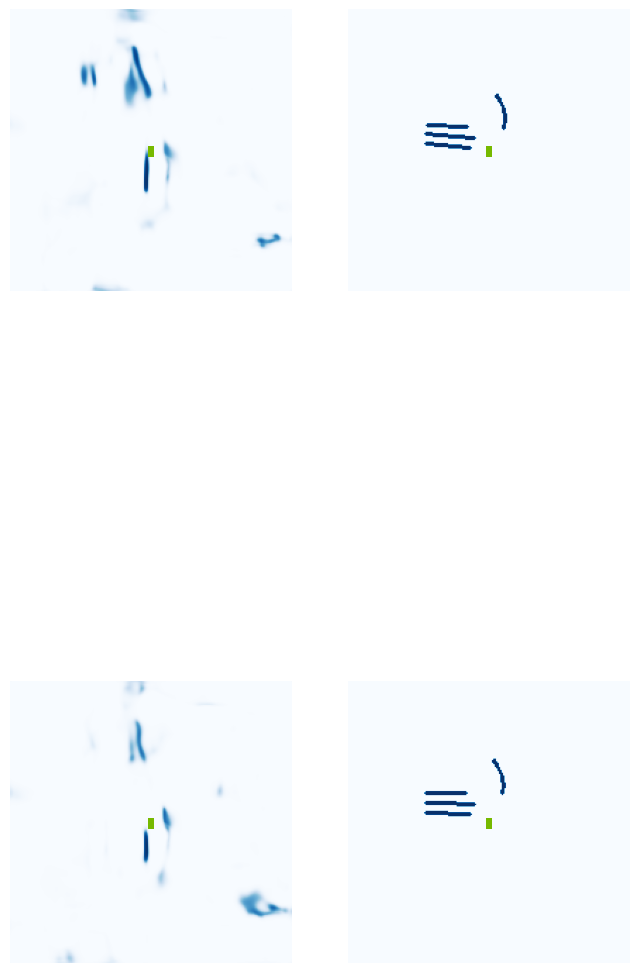

 18%|█▊        | 7/40 [00:01<00:06,  4.79it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.22it/s]

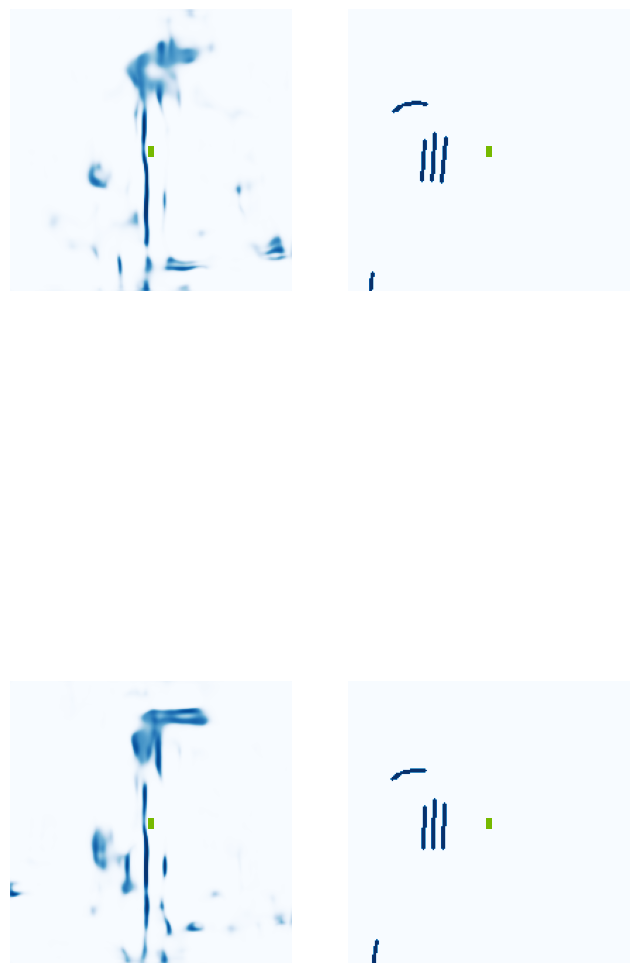

 30%|███       | 12/40 [00:02<00:05,  5.05it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.01.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.11it/s]

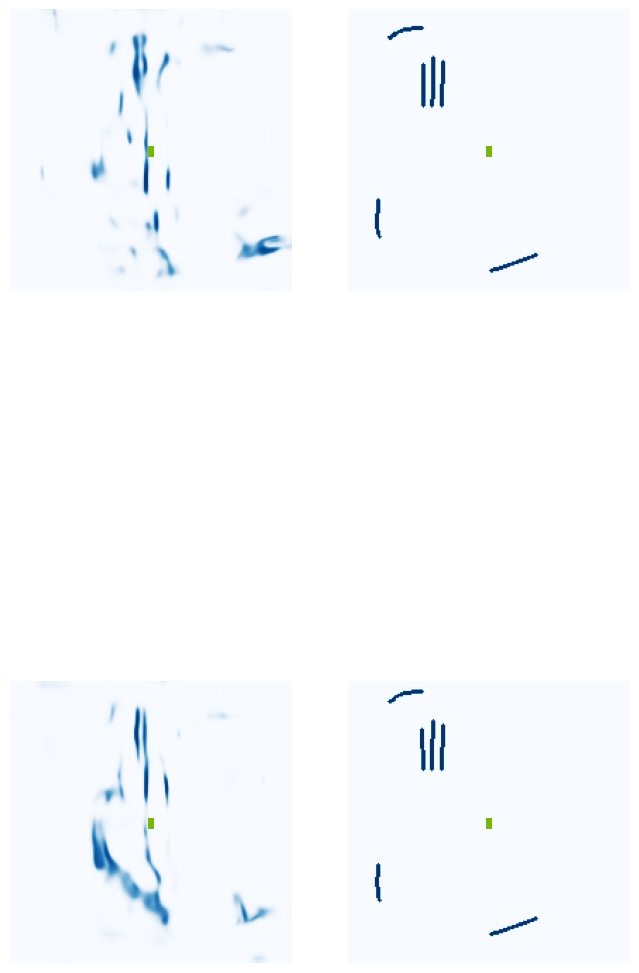

 42%|████▎     | 17/40 [00:03<00:04,  5.11it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.12it/s]

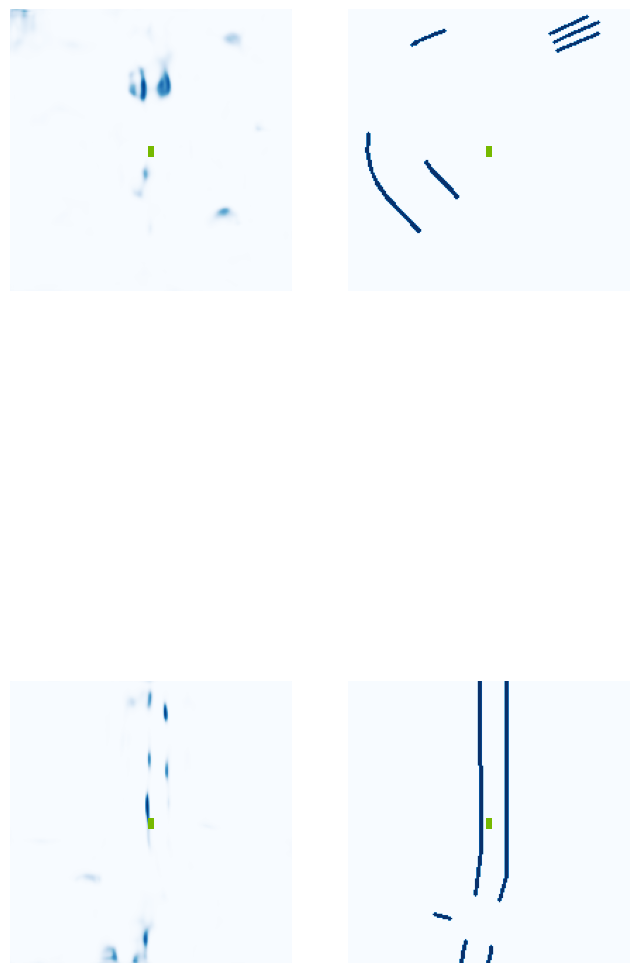

 55%|█████▌    | 22/40 [00:04<00:03,  4.80it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.64it/s]

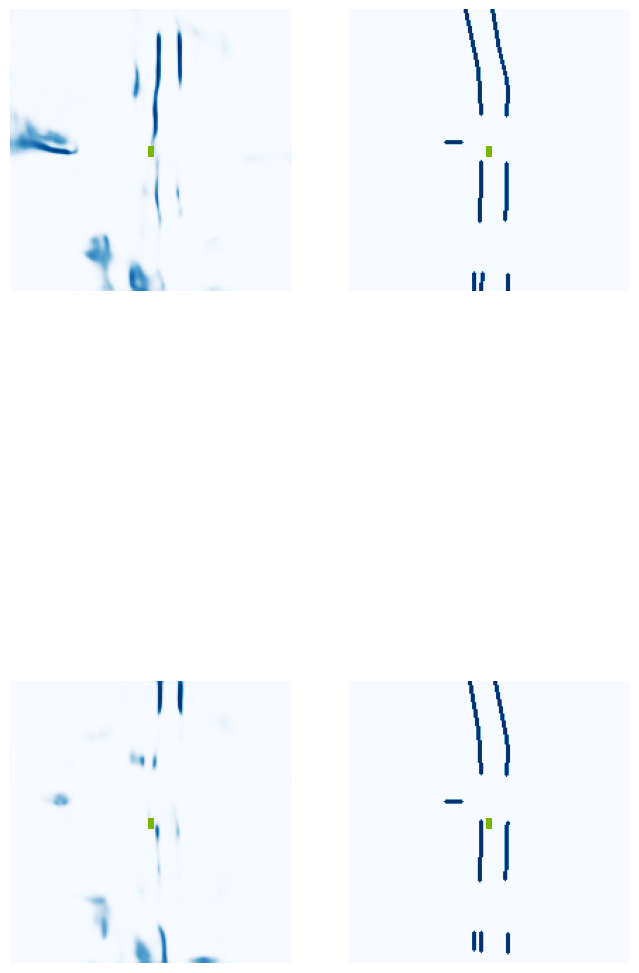

 68%|██████▊   | 27/40 [00:05<00:02,  4.79it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.05.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.29it/s]

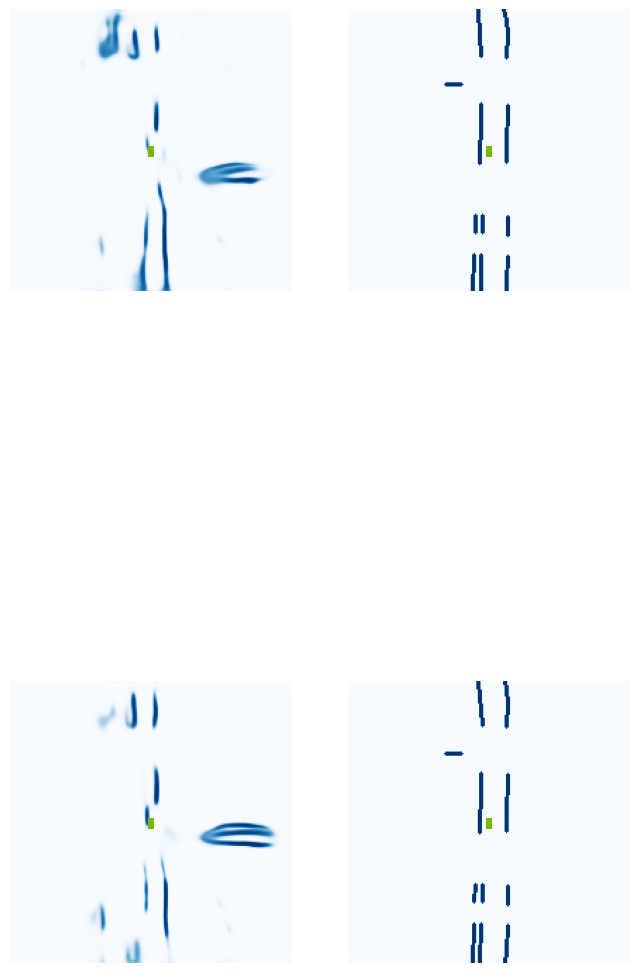

 80%|████████  | 32/40 [00:06<00:01,  4.93it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  5.71it/s]

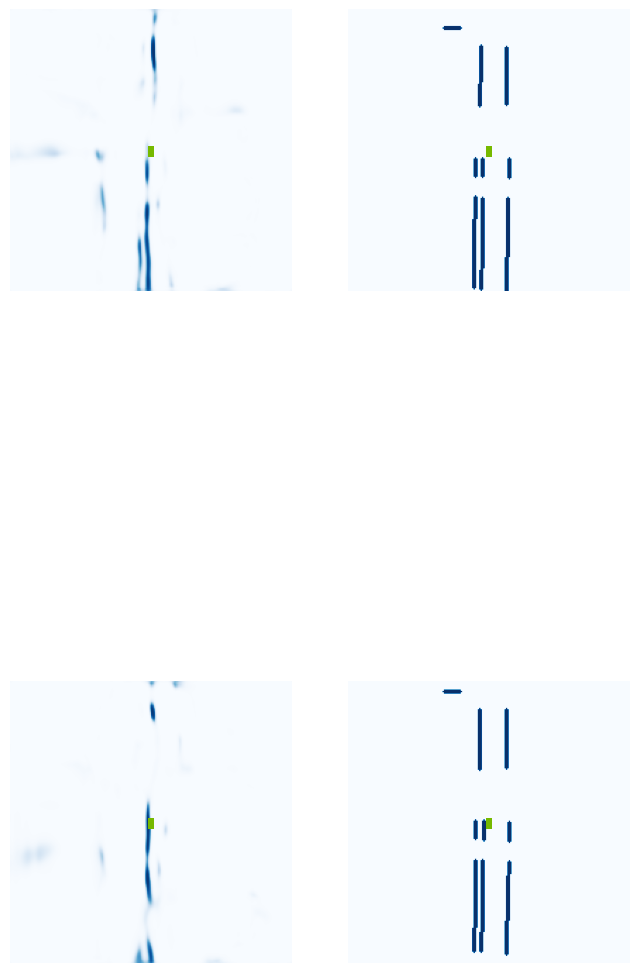

 92%|█████████▎| 37/40 [00:07<00:00,  4.89it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.03.jpg


100%|██████████| 40/40 [00:07<00:00,  5.01it/s]


VAL {'loss': 0.23342723684546388, 'iou': 0.02392654259635813}
saving ...  ./runs/model8500.pt
8510 0.050898805260658264
8520 0.03497747704386711
8530 0.04539654031395912
Epoch: 54/60
8540 0.06895605474710464
8550 0.04669652506709099
8560 0.05303580313920975
8570 0.029182152822613716
8580 0.026662716642022133
8590 0.044106729328632355
8600 0.04357282444834709
8610 0.03820732235908508
8620 0.0955277532339096
8630 0.04739971086382866
8640 0.028911080211400986
8650 0.04447184503078461
8660 0.1104743629693985
8670 0.044563524425029755
8680 0.04183889180421829
8690 0.05669146403670311
Epoch: 55/60
8700 0.05316851660609245
8710 0.1073172315955162
8720 0.03682301938533783
8730 0.09895214438438416
8740 0.02621421217918396
8750 0.1052222028374672
8760 0.03899119794368744
8770 0.0404798798263073
8780 0.032364167273044586
8790 0.04790801927447319
8800 0.05593730881810188
8810 0.03523331880569458
8820 0.04777287319302559
8830 0.02607000060379505
8840 0.08518864214420319
8850 0.04328762739896774
Epo

  0%|          | 0/40 [00:00<?, ?it/s]

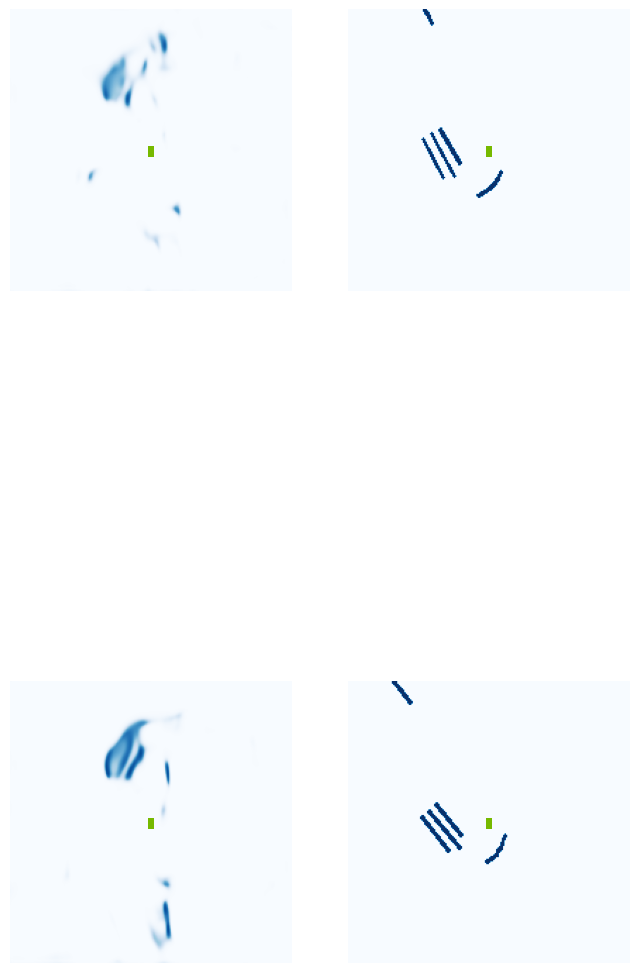

  5%|▌         | 2/40 [00:01<00:19,  1.98it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.16it/s]

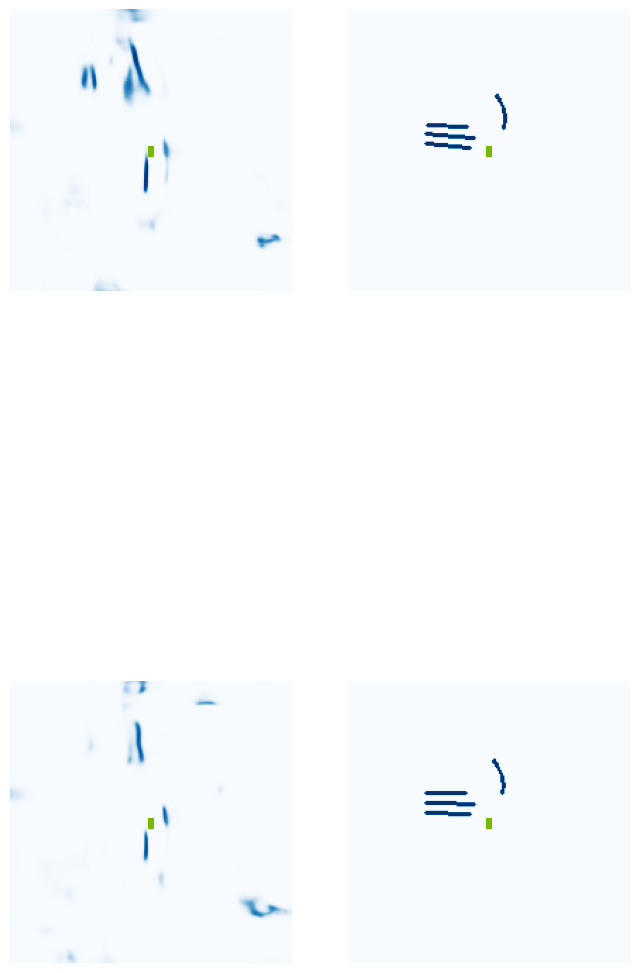

 18%|█▊        | 7/40 [00:02<00:06,  4.75it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 25%|██▌       | 10/40 [00:02<00:04,  7.27it/s]

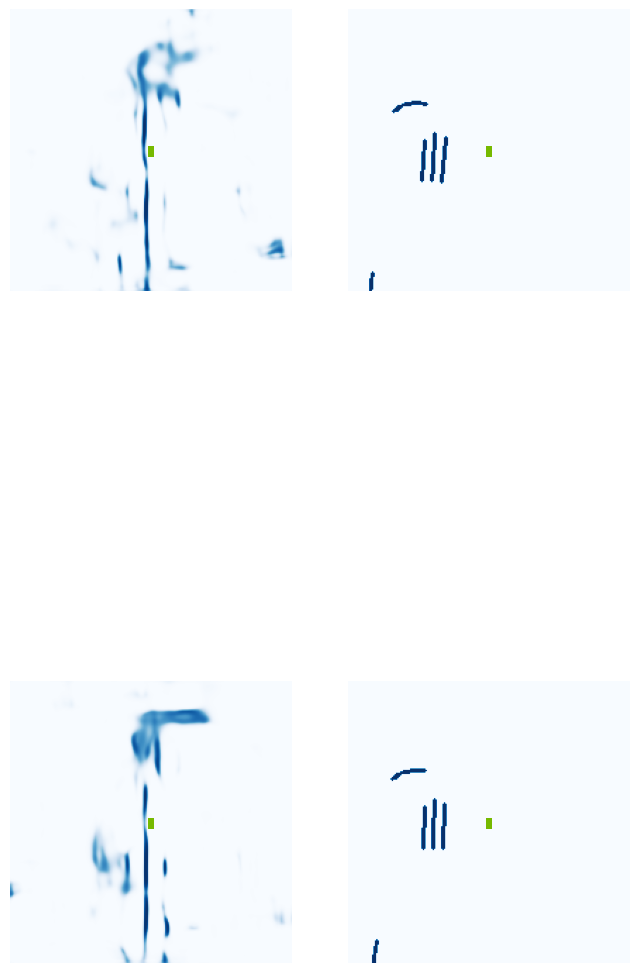

 30%|███       | 12/40 [00:02<00:05,  4.95it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  7.20it/s]

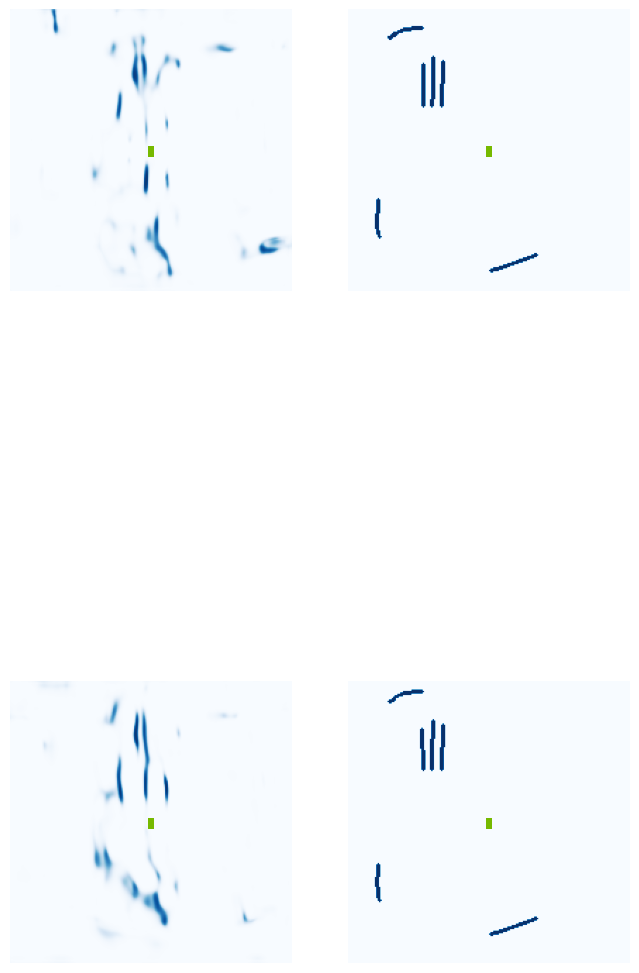

 40%|████      | 16/40 [00:03<00:05,  4.60it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:02,  7.10it/s]

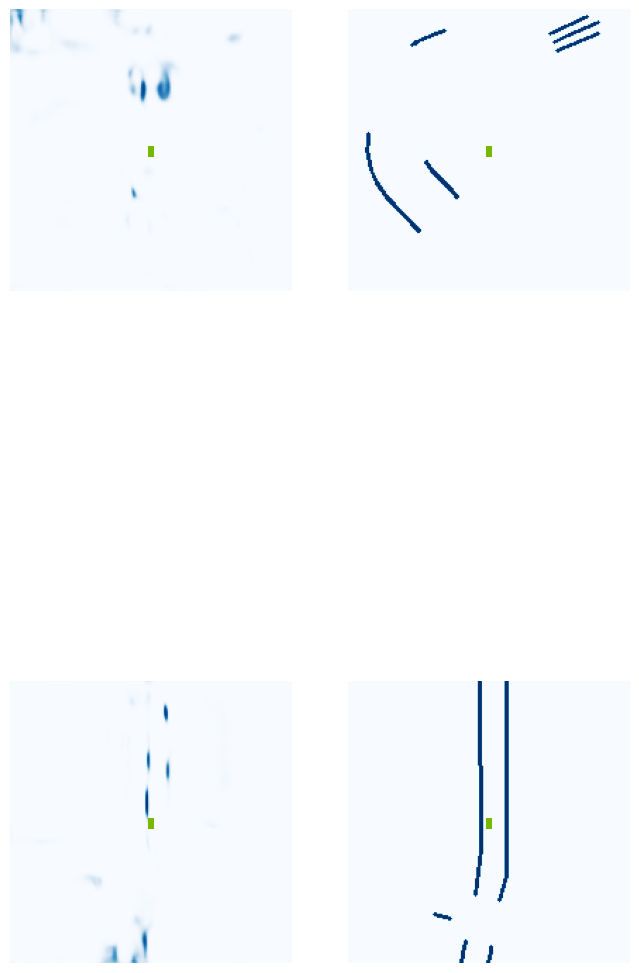

 55%|█████▌    | 22/40 [00:04<00:03,  5.14it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.01.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.40it/s]

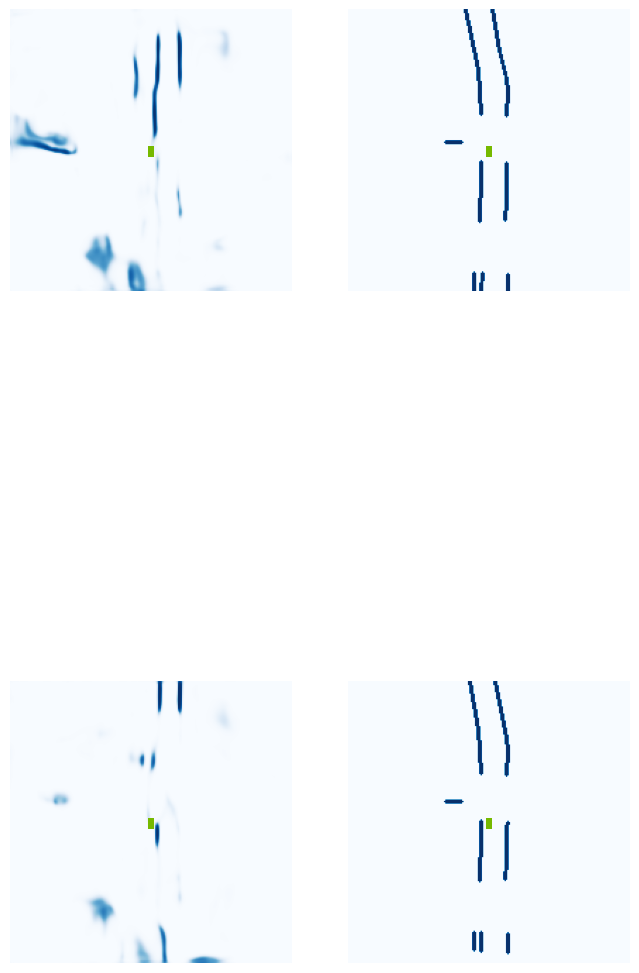

 68%|██████▊   | 27/40 [00:05<00:02,  5.16it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:05<00:01,  5.96it/s]

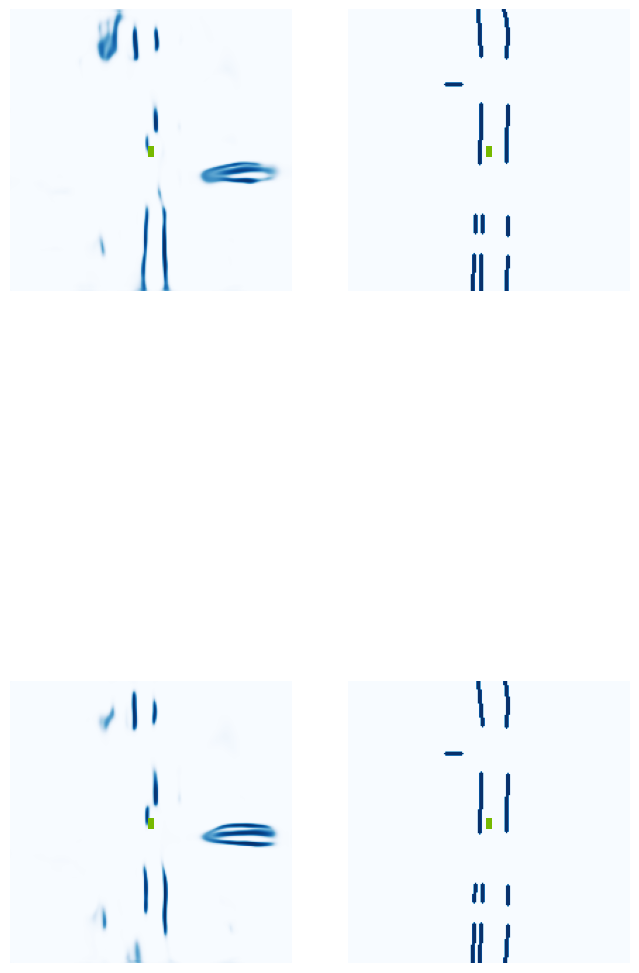

 80%|████████  | 32/40 [00:06<00:01,  4.85it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg


 88%|████████▊ | 35/40 [00:06<00:00,  5.92it/s]

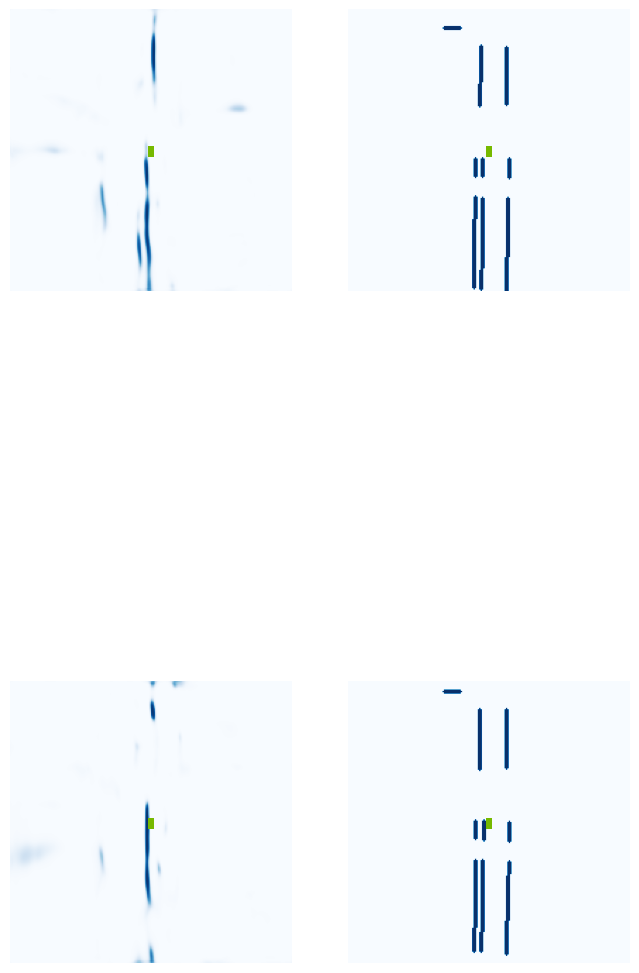

 92%|█████████▎| 37/40 [00:07<00:00,  4.82it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.05.jpg


100%|██████████| 40/40 [00:07<00:00,  5.05it/s]


VAL {'loss': 0.24729397101902667, 'iou': 0.022456161579494004}
saving ...  ./runs/model9000.pt
9010 0.04997139051556587
Epoch: 57/60
9020 0.03736359626054764
9030 0.04179928079247475
9040 0.08279160410165787
9050 0.062601737678051
9060 0.014123216271400452
9070 0.043491873890161514
9080 0.04418857768177986
9090 0.05174075812101364
9100 0.028793208301067352
9110 0.050154510885477066
9120 0.10122284293174744
9130 0.041718561202287674
9140 0.10947185754776001
9150 0.02863488160073757
9160 0.03178746998310089
9170 0.0415382944047451
Epoch: 58/60
9180 0.040384918451309204
9190 0.04925936833024025
9200 0.04696732386946678
9210 0.05383884161710739
9220 0.037673186510801315
9230 0.09987426549196243
9240 0.033790525048971176
9250 0.04152987524867058
9260 0.030220352113246918
9270 0.07075982540845871
9280 0.03319153934717178
9290 0.021447883918881416
9300 0.030546989291906357
9310 0.0443117618560791
9320 0.12310197204351425
9330 0.03698410093784332
Epoch: 59/60
9340 0.03525714576244354
9350 0.03

  0%|          | 0/40 [00:00<?, ?it/s]

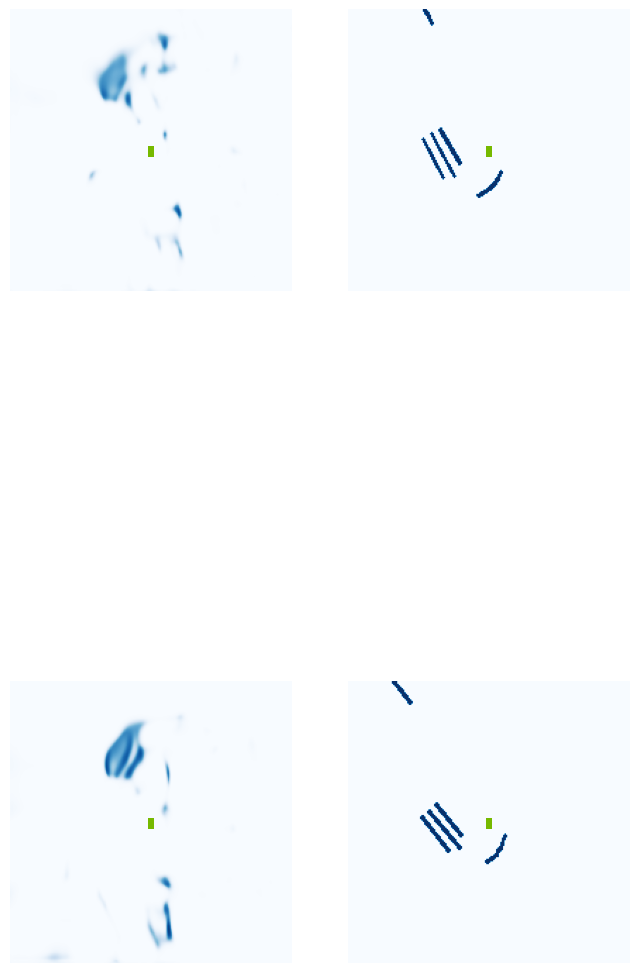

  5%|▌         | 2/40 [00:01<00:19,  1.94it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg


 12%|█▎        | 5/40 [00:01<00:06,  5.20it/s]

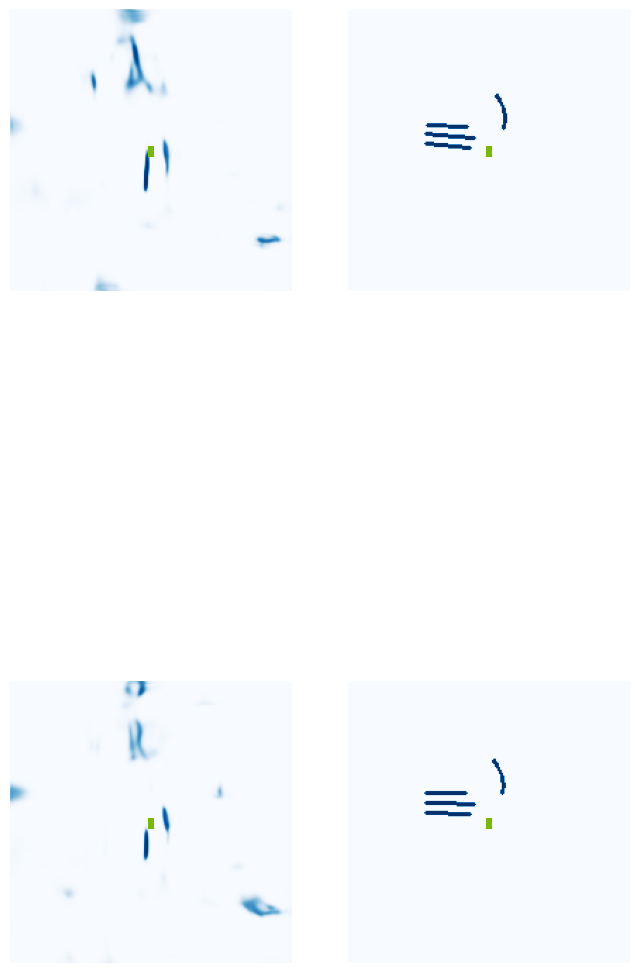

 18%|█▊        | 7/40 [00:02<00:06,  4.75it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg


 22%|██▎       | 9/40 [00:02<00:04,  6.56it/s]

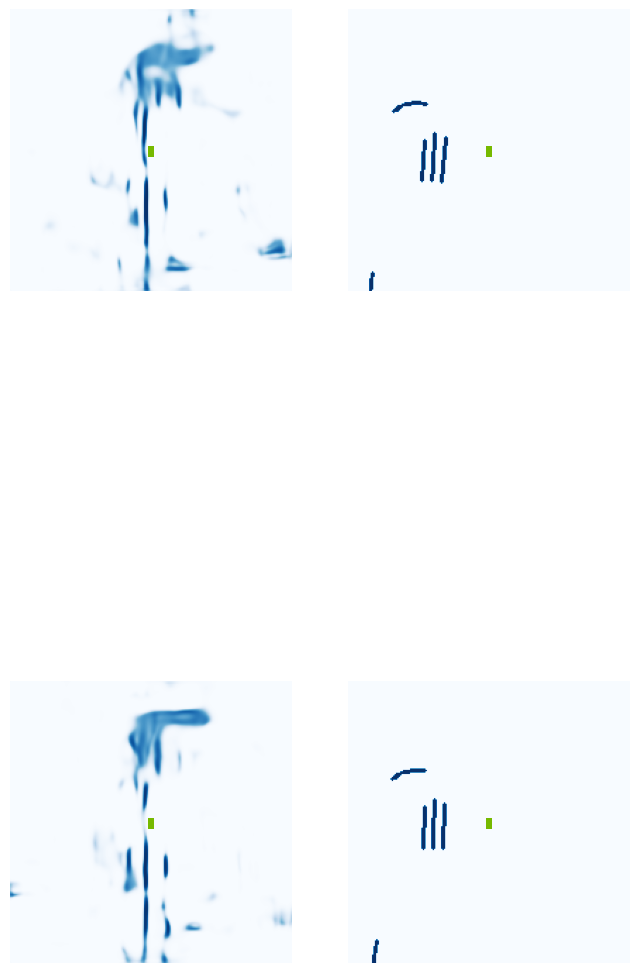

 30%|███       | 12/40 [00:02<00:05,  5.37it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg


 38%|███▊      | 15/40 [00:03<00:03,  6.97it/s]

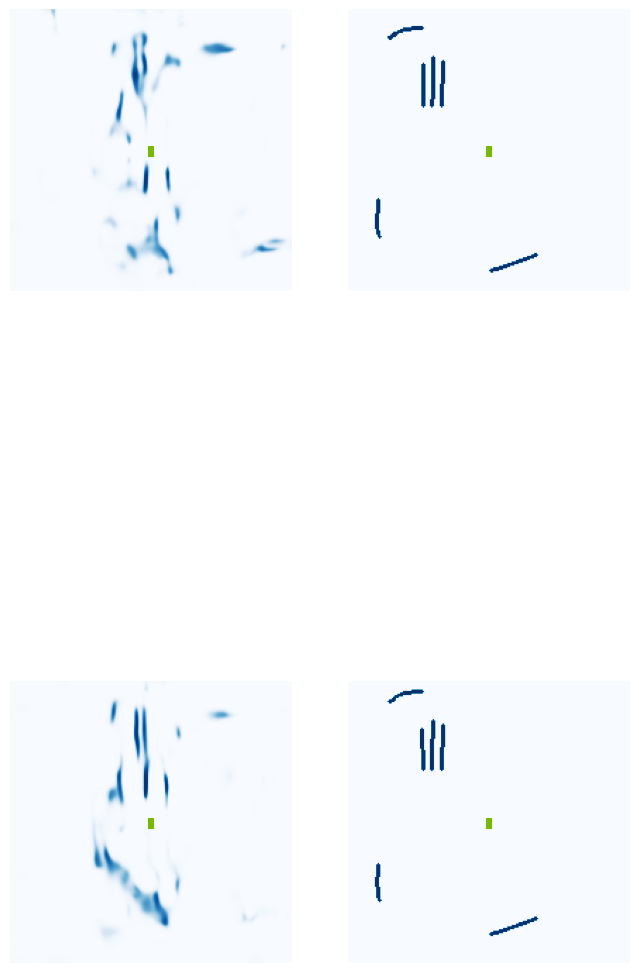

 42%|████▎     | 17/40 [00:03<00:04,  5.29it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg


 50%|█████     | 20/40 [00:04<00:03,  6.64it/s]

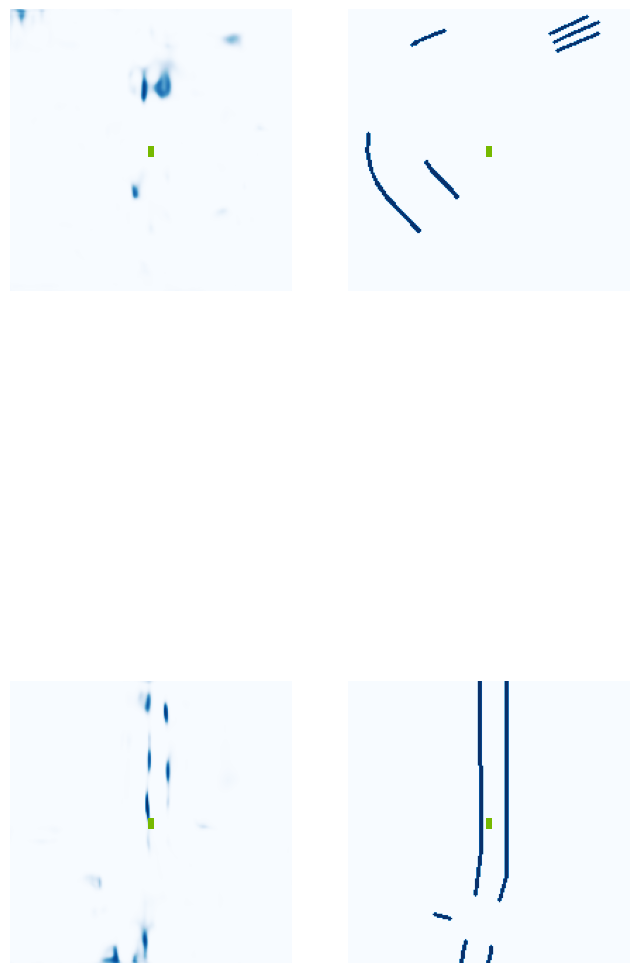

 55%|█████▌    | 22/40 [00:04<00:03,  4.89it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  6.98it/s]

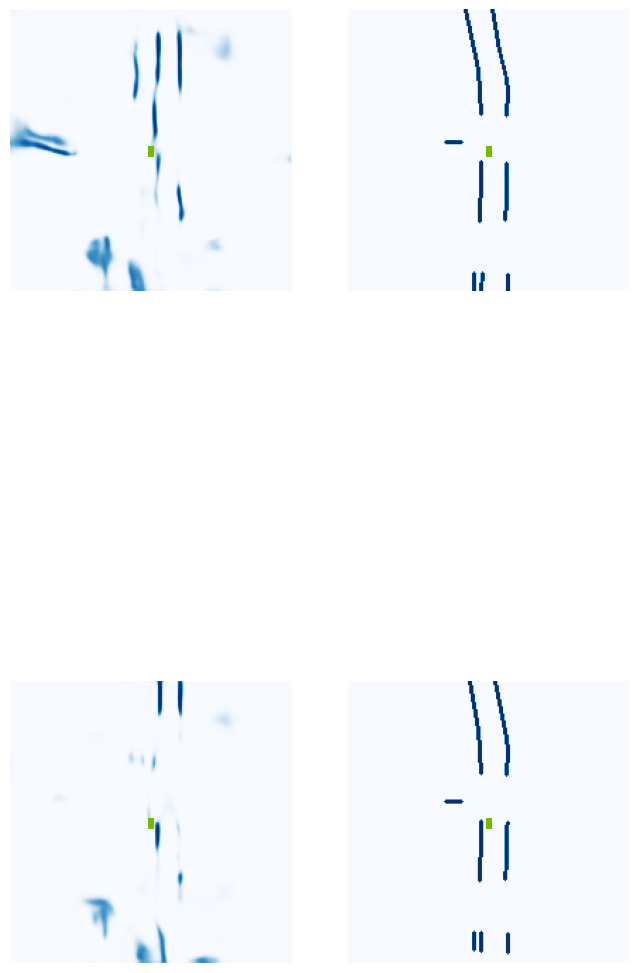

 68%|██████▊   | 27/40 [00:05<00:02,  4.58it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.73it/s]

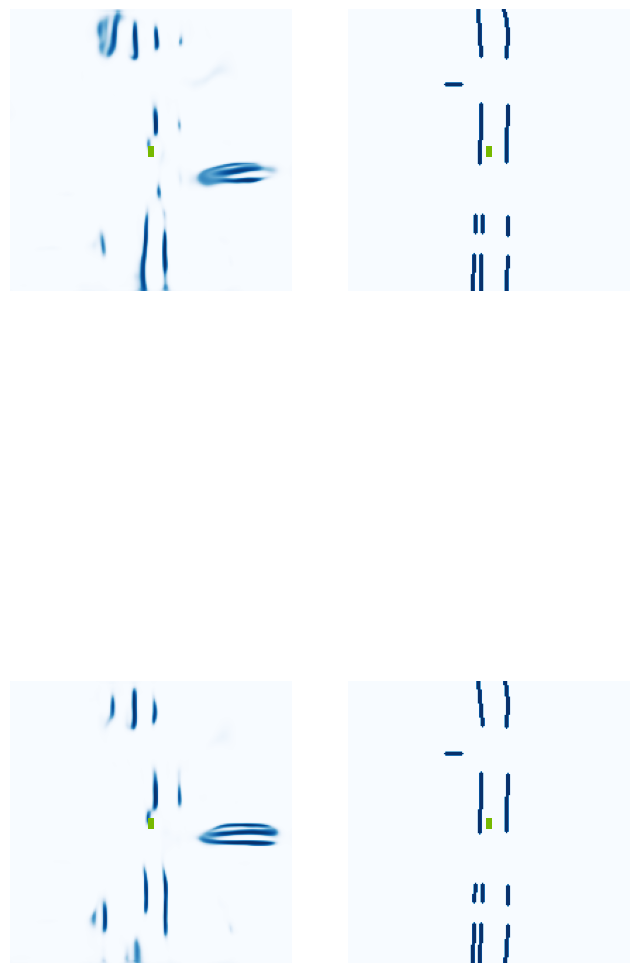

 80%|████████  | 32/40 [00:06<00:01,  4.94it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.13it/s]

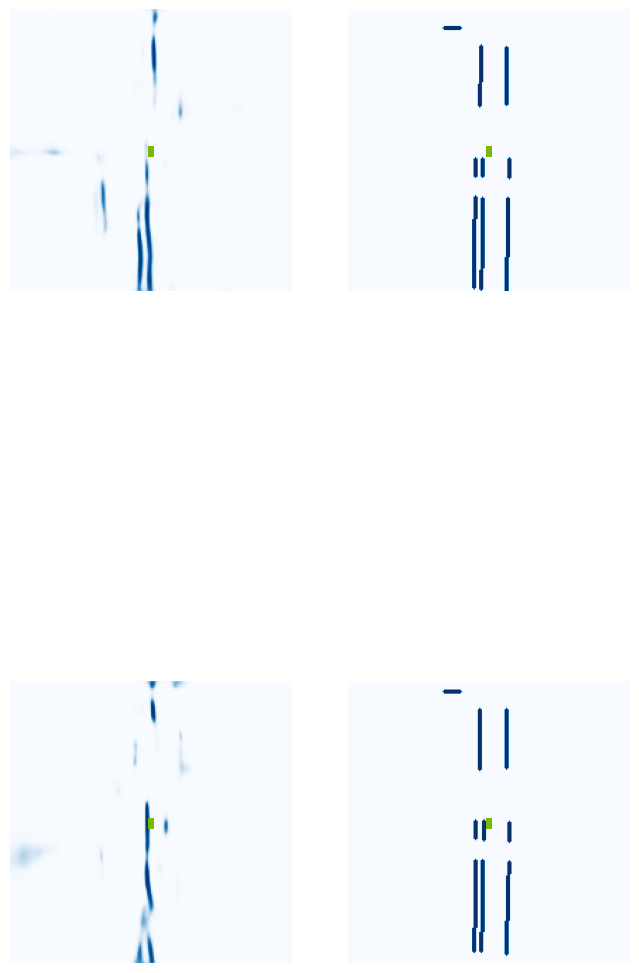

 92%|█████████▎| 37/40 [00:07<00:00,  4.51it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.04.jpg


100%|██████████| 40/40 [00:08<00:00,  4.90it/s]


VAL {'loss': 0.24507389282002862, 'iou': 0.02883718377874115}
saving ...  ./runs/model9500.pt
9510 0.04159979894757271
9520 0.05745268985629082
9530 0.03043319284915924
9540 0.031876251101493835
9550 0.05503116175532341
9560 0.07456830888986588
9570 0.05279131978750229
9580 0.027858806774020195
9590 0.03574277088046074
9600 0.025299107655882835
9610 0.05606921389698982
9620 0.047334372997283936
9630 0.10246995836496353
9640 0.027553526684641838
9650 0.018333090469241142
9660 0.016433024778962135


In [ ]:

#Now we want to actually call this function
train(train_label=train_label,
  version = version,
  dataroot= dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid, #since only one GPU is available and we start counting from 0
  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,
  pretrained_dict = pretrained_dict, #need this to pass pretrained LSS weights

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features = input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
      )

###Show loss and IOU statistics for train and val inline through Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

###Define helper functions for visualisations (as per "explore.py" in TF Grid)

In [ ]:
#All of the below is effectively taken from the explore.py file - want to run tests to make sure this works

import torch
import matplotlib as mpl
mpl.use('Agg')
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.patches as mpatches

#fixing relative imports - due to change made in __init__.py
from data import compile_data
from tools import (ego_to_cam, get_only_in_img_mask, denormalize_img,
                    SimpleLoss, get_val_info, add_ego, gen_dx_bx,
                    get_nusc_maps, plot_nusc_map, points_to_voxel_loop) #NB CHANGE FROM LSS CODE - NEED points_to_voxel_loop to be able to assign
                                                                        #voxels, coors, num_points to be able to pass this in forward pass of model
                                                                        #same as in train.py
from models_Dropout_resnet_pretrained import compile_model

#This is a visual check on input/output data - see Lift Splat Shoot GitHub home page
#We want to check that inputs/outputs are being parsed correctly
#passing viz_train = True allows us to see data augmentation
def lidar_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                show_lidar = show_lidar, #want to see lidar scans
                viz_train = viz_train, #set this to True to see data augmentation and visualise train data rather than val data
                nepochs=1, #SET THIS EXPLICITLY IN FUNCTION DEF - only want to train for a single epoch - just to visualise

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,
                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
  #set up param dicts based on passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    } #set grid_conf
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'] #specify names of cams
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #HERE THIS IS BASED ON LSS AND IS PASSED EXPLICITLY
                } #set up data_aug_conf - NB THE REASON FOR ONLY 5 CAMS IS THIS WAS SHOWN TO INCREASE ROBUSTNESS IN TRAINING WHEN
                  #ONE CAMERA WAS RANDONLY DROPPED

    #NB - NEED TO FIX THIS IN MY OWN EXPLORE.PY FILE - Crucial difference with LSS is we also need cfg_pp to be defined, to be passed to compile_model
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    #compile the data to set up data loaders
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='vizdata', cfg_pp = cfg_pp, train_label=train_label) #Note: parser can be 'vizdata' or 'segmentationdata'
                                                                 #the difference being in (see data.py) whether
                                                                 #get_lidar_data or get_point_cloud is used for the
                                                                 #lidar information - see commented data.py file for the difference
                                                                 #NB DON'T FORGET TO INCLUDE TRAIN_LABEL AND CFG_PP - THESE ARE NOT IN LSS

    loader = trainloader if viz_train else valloader #viz_train effectively selects which data loader to use

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here - unlike LSS

    rat = H / W #set up parameters for outputting visualisations
    val = 10.1
    fig = plt.figure(figsize=(val + val/3*2*rat*3, val/3*2*rat))
    gs = mpl.gridspec.GridSpec(2, 6, width_ratios=(1, 1, 1, 2*rat, 2*rat, 2*rat))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    for epoch in range(nepochs): #want to just run the model for a small number of epochs - nepochs = 1 above
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, pts, binimgs) in enumerate(loader):

            img_pts = model.get_geometry(rots, trans, intrins, post_rots, post_trans)
            #for every batch we want to get the image points and plot them
            for si in range(imgs.shape[0]):
                plt.clf()
                final_ax = plt.subplot(gs[:, 5:6])
                for imgi, img in enumerate(imgs[si]):
                    ego_pts = ego_to_cam(pts[si], rots[si, imgi], trans[si, imgi], intrins[si, imgi])
                    mask = get_only_in_img_mask(ego_pts, H, W)
                    plot_pts = post_rots[si, imgi].matmul(ego_pts) + post_trans[si, imgi].unsqueeze(1)

                    ax = plt.subplot(gs[imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    plt.imshow(showimg)
                    if show_lidar: #also gets lidar points
                        plt.scatter(plot_pts[0, mask], plot_pts[1, mask], c=ego_pts[2, mask],
                                s=5, alpha=0.1, cmap='jet')
                    # plot_pts = post_rots[si, imgi].matmul(img_pts[si, imgi].view(-1, 3).t()) + post_trans[si, imgi].unsqueeze(1)
                    # plt.scatter(img_pts[:, :, :, 0].view(-1), img_pts[:, :, :, 1].view(-1), s=1)
                    plt.axis('off')

                    plt.sca(final_ax)
                    plt.plot(img_pts[si, imgi, :, :, :, 0].view(-1), img_pts[si, imgi, :, :, :, 1].view(-1), '.', label=cams[imgi].replace('_', ' '))

                plt.legend(loc='upper right')
                final_ax.set_aspect('equal')
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))

                ax = plt.subplot(gs[:, 3:4])
                plt.scatter(pts[si, 0], pts[si, 1], c=pts[si, 2], vmin=-5, vmax=5, s=5)
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))
                ax.set_aspect('equal')

                ax = plt.subplot(gs[:, 4:5])
                plt.imshow(binimgs[si].squeeze(0).T, origin='lower', cmap='Greys', vmin=0, vmax=1) #displays output

                imname = f'lcheck{epoch:03}_{batchi:05}_{si:02}.jpg'
                print('saving', imname)
                plt.savefig(imname) #saves output display to a file for that particular epoch and batch

#As far as I understand this is just a check to make sure that the result of autograd with and without
#the cumulative sum trick, match so that we can check that the cumsum trick is working properly
def cumsum_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    #set up dicts based on above param values
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS SET EXPLICITLY HERE BASED ON Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile the data - with segmentation data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label=train_label) #other default arguments defined from data.py - but we need
                                                                                                                  #cfg_pp and train_label

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
    loader = trainloader #want to load training data

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here
    model.to(device)

    model.eval()
    #effectively just run for a single epoch - we only want to do a backward pass and check autograd matches
    for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader):

        model.use_quickcumsum = False #this is without using quickcumsum - see model.py for how it handles when use_quickcumsum=False
        model.zero_grad()
        #NB - NOTE - IN ORDER TO ACTUALLY RUN THE FORWARD PASS OF OUR MODEL WE NEED voxels, coors and num_points
        #and these come from points_to_voxel_loop - see train.py - there it calls this to get these assigned before then passing these to actually do a forward pass of the model
        voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)

        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('autograd:    ', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())

        model.use_quickcumsum = True #this is with using quickcumsum - see model.py for how it handles when use_quickcumsum=True
        model.zero_grad()
        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('quick cumsum:', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())
        print()
        #Ultimately from the print statements we can compare if cumsum trick is working as expected or not

#NB THIS IS WHAT WE WANT TO GET OUT THE ACTUAL IOU PERFORMANCE OF THE MODEL ON VALIDATION DATA USING A FITTED MODEL
def eval_model_iou(modelf, #NB WILL NEED TO SPECIFY A MODEL_LOCATION WHERE THE TRAINED MODEL IS SAVED - THEN USE THIS TO EVALUATE
                        #Note: See the last part of train.py - it will tell your the MODEL_LOCATION based on mname where it saves
                        #a state_dict of the model after the count%val_step == 0 - take the latest model saved and use that when passing
                        #eval_model_iou  - ultimately based on get_val_info
                        #this is the validation info only for the same class as trained on
                        #will also need to edit get_val_info for where the images resulting from plot_bev are being saved version = "mini",
                        #NB Note - non-default arguments need to precede default arguments
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control decoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points, #trainval avg 34720  , mini avg 34718

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY HERE
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label = train_label) #all other default params passed from data.py but we need cfg_pp and
                                                                                                                    #train_label - unlike LSS code

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp = cfg_pp) #compile model - need cfg_pp unlike LSS
    print('loading', modelf)
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])
    model.to(device)

    loss_fn = SimpleLoss(1.0).cuda(gpuid)

    model.eval()
    val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp = cfg_pp, grid_conf=grid_conf) #ultimate output is a dict of loss and iou across all batches
                                                               #plus images stored in a folder (to be set) with the outputs of
                                                               #plot_bev
                                                               #NB - NOTE - the way it is defined in tools.py it requires a cfg argument - really this is cfg_pp - as it gets
                                                               #passed to points_to_voxel_loop to get voxels, coors, num_points etc
    print(val_info)


def viz_model_preds(modelf, #this is to be a file path to a fitted model
                    version = version,
                    dataroot= dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found
                    img_save = img_save_dir, # Need to pass a directory I actually have access to
                    gpuid = gpuid,#start counting from 0 when using just one GPU
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode,#new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes, #NEED TO PUT THIS IN HERE AS IT ISN'T COMING FROM THE CONFIG FILE
                    num_points = num_points,
                    n_points = n_points, #trainval avg 34720  , mini avg 34718

                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
                    ):
    #set dicts for passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
            'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT']
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY - based on Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp = cfg_pp, train_label=train_label) #need cfg_pp and train_label all rest default from data.py
    loader = trainloader if viz_train else valloader #decide whether visualising train or val data
    nusc_maps = get_nusc_maps(map_folder) #NEED TO DOUBLE CHECK WHAT THIS FUNCTION DOES AND WHAT IT RETURNS - Should generally get the maps

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1,cfg_pp = cfg_pp) #compile the model - need cfg_pp here - unlike LSS
    print('loading', modelf)
    print('device: ',device) ###
    #Want to generally load a fitted model
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])####,map_location=device
    model.to(device)

    dx, bx, _ = gen_dx_bx(grid_conf['xbound'], grid_conf['ybound'], grid_conf['zbound'])
    dx, bx = dx[:2].numpy(), bx[:2].numpy()

    scene2map = {}
    for rec in loader.dataset.nusc.scene:
        log = loader.dataset.nusc.get('log', rec['log_token'])
        scene2map[rec['name']] = log['location']

    #this is for setting up plotting
    val = 0.01
    fH, fW = final_dim
    fig = plt.figure(figsize=(3*fW*val, (1.5*fW + 2*fH)*val))
    gs = mpl.gridspec.GridSpec(3, 3, height_ratios=(1.5*fW, fH, fH))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    model.eval() #switch model to eval mode
    counter = 0
    with torch.no_grad():
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader): #need points also
            voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp) #need voxels, coors and num_points to run forward pass on model

            out = model(imgs.to(device),
                    rots.to(device),
                    trans.to(device),
                    intrins.to(device),
                    post_rots.to(device),
                    post_trans.to(device),
                    voxels.to(device), #need voxels, coors and num_points - different to LSS code
                    coors.to(device),
                    num_points.to(device)
                    )
            out = out.sigmoid().cpu() #### why applies sigmoid to output???


            for si in range(imgs.shape[0]):
                plt.clf()
                for imgi, img in enumerate(imgs[si]):
                    ax = plt.subplot(gs[1 + imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    # flip the bottom images
                    if imgi > 2:
                        showimg = showimg.transpose(Image.FLIP_LEFT_RIGHT)
                    plt.imshow(showimg)
                    plt.axis('off')
                    plt.annotate(cams[imgi].replace('_', ' '), (0.01, 0.92), xycoords='axes fraction')

                ax = plt.subplot(gs[0, :])
                ax.get_xaxis().set_ticks([])
                ax.get_yaxis().set_ticks([])
                plt.setp(ax.spines.values(), color='b', linewidth=2)
                plt.legend(handles=[
                    mpatches.Patch(color=(0.0, 0.0, 1.0, 1.0), label='Output Vehicle Segmentation'),
                    mpatches.Patch(color='#76b900', label='Ego Vehicle'),
                    mpatches.Patch(color=(1.00, 0.50, 0.31, 0.8), label='Map (for visualization purposes only)')
                ], loc=(0.01, 0.86))
                plt.imshow(out[si].squeeze(0), vmin=0, vmax=1, cmap='Blues')

                # plot static map (improves visualization)
                rec = loader.dataset.ixes[counter]
                plot_nusc_map(rec, nusc_maps, loader.dataset.nusc, scene2map, dx, bx)
                plt.xlim((out.shape[3], 0))
                plt.ylim((0, out.shape[3]))
                add_ego(bx, dx)

                imname = f'eval{batchi:06}_{si:03}.jpg'
                print('saving', imname)
                plt.savefig(img_save + imname) #saves all these figures named based on batch number and enumerated image number
                counter += 1


###Call eval_model_iou() to get IOU and loss

In [ ]:
eval_model_iou(modelf = os.path.join(logdir, "model9500.pt"),
                version = version,
                dataroot = dataroot,
                gpuid = gpuid, #only 1 gpu on Colab

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,

                n_points = n_points, #trainval avg 34720  , mini avg 34718
                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                )


Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weig

loading ./runs/model9500.pt
running eval...
Image saved! ... ./runs/get_val_info/0-iou-0.00.jpg
Image saved! ... ./runs/get_val_info/5-iou-0.00.jpg
Image saved! ... ./runs/get_val_info/10-iou-0.00.jpg
Image saved! ... ./runs/get_val_info/15-iou-0.00.jpg
Image saved! ... ./runs/get_val_info/20-iou-0.02.jpg
Image saved! ... ./runs/get_val_info/25-iou-0.04.jpg
Image saved! ... ./runs/get_val_info/30-iou-0.04.jpg
Image saved! ... ./runs/get_val_info/35-iou-0.04.jpg
{'loss': 0.13566204960699435, 'iou': 0.02883718377874115}


###Call viz_model_preds() to visualise output predictions

In [ ]:
#call viz_model_preds - to actually try to visualise outputs of model as a BEV map
viz_model_preds(modelf = os.path.join(logdir, "model9500.pt"), #file path to a fitted model - to get the actual model state_dict will need to access ['model_state_dict'] of this
                    version = version,
                    dataroot = dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found - NB get_nusc_maps will append maps/expansions/... to get relevant file
                    img_save = img_save_dir, #Chnaged this to a directory I have access to - save output in same place as all other run related output
                    gpuid = gpuid,
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode, #new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes,
                    num_points = num_points,

                    n_points = n_points, #trainval avg 34720  , mini avg 34718
                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
)

Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0
loading ./runs/model9500.pt
device:  cuda:0
saving eval000000_000.jpg
saving eval000000_001.jpg
saving eval000001_000.jpg
saving eval000001_001.jpg
saving eval000002_000.jpg
saving eval000002_001.jpg
saving eval000003_000.jpg
saving eval000003_001.jpg
saving eval000004_000.jpg
saving eval000004_001.jpg
saving eval000005_000.jpg
saving eval000005_001.jpg
saving eval000006_000.jpg
saving eval000006_001.jpg
saving eval000007_000.jpg
saving eval000007_001.jpg
saving eval000008_000.jpg
saving eval000008_001.jpg
saving eval000009_000.jpg
saving eval000009_001.jpg
saving eval000010_000.jpg
saving eval000010_001.jpg
saving eval000011_000.jpg
saving eval000011_001.jpg
saving eval000012_000.jpg
saving eval000012_001.jpg
saving eval000013_000.jpg
saving eval000013_001.jpg
saving eval000014_000.jpg
saving eval000014_001.jpg
saving eval000015_00

###Make a gif out of images produced by viz_model_preds()

In [ ]:
import glob
from PIL import Image
def make_gif(frame_folder, train_label, decoder_mode):
    frames = [Image.open(image) for image in glob.glob(f"{frame_folder}/*.jpg")]
    frame_one = frames[0]
    frame_one.save(f"model_preds_visualisation_{train_label}_DM:{decoder_mode}.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)

#Call function
make_gif(frame_folder = img_save_dir, train_label = train_label, decoder_mode = decoder_mode)